# Week 8 Exercises
For this week the important exercises is 1,2,3, 4, 5

The rest are coding exercises that allows the interested student to play with neural nets with pytorch. These are of course important, but it is more important to finish the hand in. 
We suggest that solving the exercise in order they are presented.

Beware that running deep learning is rather time consuming when we employ convolutional networks without gpu support (which requires some installation and is not required) so keep your nets manageable and tune learning rate and other paramters carefully.
You can use any pytorch functionality you want and you can find all the pieces we have talked about in the course.

## Ex 1: Verify the of Gods of Algebra: Vectorized  derivatives for Neural Nets - single data point

Let $x$ be a data point ($1 \times d$) vector and $W$ a weight matrix of shape $d \times h$ used in the neural net 
$$
\textrm{nn}(x) = (xW_1 + b_1)W_2 + b_2
$$
Let $e$ be the error function considered

Furthermore, let
$$
s = x W, \quad v = \frac{\partial e}{\partial s} = \left[\frac{\partial e}{\partial s[a]}, a=1,\dots, h\right]
$$ 
both $1 \times h$ vectors (we have ignored indexing of W here for notational simplicity and the bias to since we are not considering it here).

We need to check that 

$$
\frac{\partial e}{\partial W} = x^\intercal v
$$
as claimed in the lecture. 

We will check it by deriving
$$
\frac{\partial e}{\partial W_{i, j}}
$$
a derivative of just one entry in $W$ and see that it fits (for that the problem is the derivative of a function from one number to one number).

**TASK**
- Step 1: Derive $\frac{\partial s_1}{\partial W_{i,j}} = \left[\frac{\partial s_1[a]}{\partial W_{i, j}}, a=1,\dots, h\right]$  - it is a $h \times 1$ vector. **Hint:** it contains mostly zeros except at one important place.
- Step 2: Use Chain Rule to show that $\frac{\partial e}{\partial W_{i, j}} = x_i v_j$ and conclude the formula fits



## Ex 2: Verify the of Gods of Algebra: Vectorized  derivatives for Neural Nets - batch of data
With that formula above in place, we can now try and optimize for the case where we replace the single data point $x$ with a mini-batch of data $X$.

Let $X$ be a mini-batch of data points ($n \times d$) vector and $W$ a weight matrix of shape $d \times h$ used the same net as above.
To evaluate all elements in the minibatch we get

$$
\textrm{nn}(X) = (XW_1 + b_1)W_2 + b_2
$$

which outputs an $n \times 1$ vector instead of just one number.

The error function considered is the sum of errors over the data in the batch  

$$
\sum_{a=1}^n e(y_a, \textrm{nn}(x_a))
$$ 

where $e$ is some error as above above, and $x_a$ is the $a'th$ row in X (as a $1 \times d$ vector) and $y_a$ is the target value for $x_a$.

Furthermore, let

$$
S = X W, \quad V = \frac{\partial e}{\partial S} 
$$ 

both $n \times h$ matrices, having a row for every input point $x \in X$. So it is the same as above applied for the $n$ points instead of one and placed in the rows of matrices $S$ and $V$.

We know that if $X$ (and hence $S, V$) only has one row then the result is given above.
To get derivatives of the sum we must sum the derivative and hence
$$
 \sum_{a=1}^ n \frac{\partial e(y_a, \textrm{nn}(x_a))}{\partial W} = \sum_{a=1}^n x_a^\intercal v_a
$$
where $x_a$ is the $a$'th row of $X$ and $v_a$ is the $a$'th row of V.


**Task:** 
Show how to rewrite this sum into one matrix product and argue correctness.


## Ex 3: Convolution and Pooling
In this exercise we will see if we can get a better grasp of convolution and pooling.
Your job is to implement basic convolution and pooling

- The Convolution operator that takes a $d \times d$ weight matrix and and 1 channel image, and applies the convolution with the weight vector with the image.
- The max pooling operator takes an input image and a max pooling size and returns the pooled output.
- Test your convolution implementation with the $3 \times 3$ matrix with -1 everywhere execpt the middle and 8 in the middle is a classic edge detector pattern.
- Test your pooling implementation by applying a $2 \times 2$ max pooling to the output of the convolution.


To compare your implementation we have given code that applies the convolution and the pooling operator from the neural net package in pytorch.




Download Lena at : https://users-cs.au.dk/jallan/ml/data/lena512_gray.bmp
image shape (512, 512)


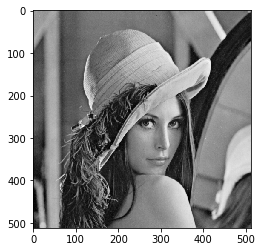

T [[162 162 162]
 [162 162 162]
 [162 162 162]]
[[162 161 163 ... 137 169 155]
 [162 161 163 ... 137 169 155]
 [160 158 159 ... 127 112  64]
 ...
 [ 48  49  51 ...  55  70  78]
 [ 54  47  50 ...  67  88  94]
 [ 44  51  50 ...  94 104 105]]
[[162 157 162 ... 115 162 170]
 [162 157 162 ... 115 162 170]
 [160 162 163 ... 126 126  79]
 ...
 [ 48  57  67 ...  57  51  71]
 [ 54  53  61 ...  52  78  93]
 [ 44  47  51 ...  72  90 104]]
[[162 161 155 ... 121 120 169]
 [162 161 155 ... 121 120 169]
 [163 156 155 ... 120 130 112]
 ...
 [ 53  53  58 ...  49  59  70]
 [ 48  55  56 ...  50  55  88]
 [ 55  51  53 ...  52  76 104]]
[[161 162 155 ... 123 115 169]
 [161 162 155 ... 123 115 169]
 [158 163 152 ... 124 126 112]
 ...
 [ 49  67 130 ...  56  57  70]
 [ 47  61 120 ...  53  52  88]
 [ 51  51 109 ...  50  72 104]]
[[162 160 161 ... 119 115 171]
 [162 160 161 ... 119 115 171]
 [160 163 154 ... 126 126  92]
 ...
 [ 53  59 195 ...  52  57  70]
 [ 53  55 195 ...  46  52  90]
 [ 54  51 195 ...  42  7

[[123 131 153 115]
 [123 131 153 115]
 [125 132 157 126]
 [120 132 152 119]
 [130 133 154  73]
 [125 129 155  42]
 [123 133 160  46]
 [126 138 157  53]
 [123 137 153  52]
 [124 133 155  45]
 [125 126 158  48]
 [120 133 155  50]
 [122 130 159  51]
 [123 124 153  49]
 [128 129 157  49]
 [124 118 152  49]
 [124 123 154  44]
 [120 187 156  45]
 [120 191 153  53]
 [124 188 146  47]
 [127 191 151  44]
 [128 183 152  48]
 [114 184 150  46]
 [115 179 151  59]
 [112 184 143  72]
 [115 191 141  51]
 [117 187 132  37]
 [120 196 119  49]
 [118 189 107 103]
 [121 170  89 141]
 [114 173  67 149]
 [118 207  56 149]
 [116 201  44 140]
 [112 193  42 136]
 [120 198  40 154]
 [122 186  44 161]
 [116 200  44 162]
 [108 180  48 163]
 [108 190  45 162]
 [ 97 188  46 160]
 [ 99 188  39 160]
 [103 194  40 156]
 [112 177  67 158]
 [149 192 213 158]
 [206 183 191 158]
 [223 147 182 155]
 [222 183 210 155]
 [214 171 206 153]
 [213 176 201 153]
 [209 165 201 153]
 [205 179 200 159]
 [199 178 200 158]
 [180 173 20

 [146]]
[[130]
 [130]
 [128]
 [129]
 [131]
 [128]
 [128]
 [124]
 [128]
 [125]
 [128]
 [129]
 [128]
 [129]
 [130]
 [129]
 [129]
 [133]
 [123]
 [124]
 [120]
 [108]
 [193]
 [197]
 [200]
 [197]
 [198]
 [211]
 [210]
 [210]
 [207]
 [201]
 [198]
 [193]
 [208]
 [198]
 [212]
 [201]
 [202]
 [195]
 [198]
 [199]
 [194]
 [192]
 [198]
 [195]
 [190]
 [194]
 [194]
 [182]
 [185]
 [174]
 [178]
 [178]
 [166]
 [170]
 [158]
 [167]
 [129]
 [ 88]
 [ 55]
 [ 38]
 [ 44]
 [ 37]
 [142]
 [140]
 [124]
 [191]
 [195]
 [193]
 [177]
 [179]
 [188]
 [185]
 [173]
 [172]
 [172]
 [168]
 [155]
 [152]
 [162]
 [153]
 [ 86]
 [ 92]
 [129]
 [101]
 [ 43]
 [ 57]
 [163]
 [203]
 [202]
 [199]
 [162]
 [166]
 [161]
 [162]
 [168]
 [171]
 [173]
 [176]
 [166]
 [164]
 [165]
 [165]
 [158]
 [156]
 [154]
 [158]
 [162]
 [158]
 [156]
 [157]
 [155]
 [152]
 [145]
 [140]
 [134]
 [ 82]
 [120]
 [129]
 [122]
 [130]
 [129]
 [136]
 [146]
 [157]
 [153]
 [151]
 [144]
 [138]
 [151]
 [149]
 [147]
 [145]
 [139]
 [140]
 [142]
 [139]
 [140]
 [143]
 [137]
 [145

[[152]
 [152]
 [152]
 [153]
 [155]
 [157]
 [154]
 [156]
 [153]
 [158]
 [154]
 [154]
 [162]
 [149]
 [153]
 [158]
 [155]
 [152]
 [147]
 [146]
 [144]
 [141]
 [142]
 [144]
 [145]
 [147]
 [150]
 [150]
 [147]
 [138]
 [127]
 [119]
 [106]
 [ 89]
 [ 70]
 [ 49]
 [ 37]
 [ 41]
 [ 38]
 [ 39]
 [ 49]
 [204]
 [210]
 [164]
 [209]
 [209]
 [206]
 [202]
 [203]
 [202]
 [204]
 [203]
 [204]
 [207]
 [208]
 [210]
 [207]
 [148]
 [160]
 [ 88]
 [ 87]
 [ 94]
 [120]
 [163]
 [171]
 [187]
 [208]
 [ 50]
 [ 54]
 [ 43]
 [ 51]
 [ 48]
 [ 46]
 [ 49]
 [ 51]
 [ 54]
 [ 55]
 [ 53]
 [ 58]
 [ 60]
 [ 62]
 [ 62]
 [ 56]
 [ 60]
 [ 61]
 [ 68]
 [ 65]
 [ 59]
 [ 61]
 [ 66]
 [ 53]
 [ 49]
 [ 51]
 [ 52]
 [ 56]
 [ 49]
 [ 54]
 [ 67]
 [ 44]
 [ 42]
 [ 38]
 [ 38]
 [ 47]
 [ 42]
 [ 47]
 [ 41]
 [ 50]
 [ 36]
 [ 35]
 [ 43]
 [ 61]
 [ 84]
 [112]
 [111]
 [113]
 [125]
 [131]
 [132]
 [141]
 [147]
 [157]
 [163]
 [164]
 [162]
 [166]
 [165]
 [163]
 [163]
 [156]
 [147]
 [129]
 [126]
 [127]
 [126]
 [136]
 [147]
 [149]
 [149]
 [152]
 [143]
 [150]
 [146]
 [148]

[[110 137 130 156 121]
 [104 134 131 156 115]
 [107 124 130 148 130]
 [100 126 132 150 116]
 [103 142 130 155  47]
 [109 133 129 151  41]
 [104 136 124 151  46]
 [106 131 123 153  43]
 [106 129 129 157  59]
 [102 132 129 157  54]
 [105 127 122 152  53]
 [101 123 128 151  48]
 [ 98 149 127 149  44]
 [106 150 125 146  48]
 [104 136 125 143  60]
 [105 132 121 144  50]
 [104 131 119 144  47]
 [103 127 107 144  49]
 [ 99 138 102 145  57]
 [ 99 129 107 145  77]
 [106 131 222 145  70]
 [101 135 222 145  61]
 [101 134 216 143 115]
 [ 99 141 216 145 142]
 [100 135 211 146 152]
 [102 132 207 144 151]
 [ 98 142 211 147 145]
 [ 97 141 206 137 155]
 [100 136 208 211 161]
 [ 98 125 204 183 159]
 [ 97 123 204 217 159]
 [102 102 199 215 161]
 [101 170 205 208 157]
 [103 157 154 201 154]
 [104 151 193 204 159]
 [103 143 185 202 154]
 [100 116 192 201 151]
 [ 99 141 183 188 156]
 [100 148 192 165 157]
 [ 97 148 180 166 159]
 [ 99 147 169 150 155]
 [ 97 145 174 164 159]
 [102 136 140 103 157]
 [101 150 1

[[133 208]
 [136 208]
 [131 190]
 [131 155]
 [130 149]
 [133 151]
 [130 147]
 [124 148]
 [126 152]
 [128 151]
 [123 148]
 [128 142]
 [144 143]
 [132 140]
 [149 134]
 [140 140]
 [130 143]
 [147 143]
 [126 146]
 [135 144]
 [123 145]
 [133 141]
 [128 143]
 [138 143]
 [142 146]
 [147 145]
 [134 139]
 [144 142]
 [145 185]
 [123 223]
 [102 221]
 [170 207]
 [171 208]
 [158 214]
 [138 215]
 [121 215]
 [147 215]
 [147 212]
 [154 209]
 [149 196]
 [156 197]
 [146 218]
 [151 195]
 [138  41]
 [142  43]
 [147  38]
 [135  51]
 [109  52]
 [111  49]
 [111  60]
 [ 80  56]
 [ 64  45]
 [100  41]
 [ 97  42]
 [ 70  43]
 [ 55  47]
 [ 46  54]
 [ 56  50]
 [ 71  54]
 [ 55  44]
 [ 49  42]
 [ 53  43]
 [ 39  55]
 [ 42  74]
 [ 45 111]
 [ 40 131]
 [ 45 144]
 [ 44 139]
 [ 37 138]
 [ 35 131]
 [ 35 130]
 [130 140]
 [126 152]
 [114 160]
 [134 161]
 [197 161]
 [201 161]
 [204 160]
 [127 156]
 [ 55 152]
 [ 38 151]
 [ 39 149]
 [ 78 154]
 [ 51 156]
 [ 60 151]
 [ 65 152]
 [ 53 152]
 [ 62 155]
 [ 56 154]
 [ 53 154]
 [ 58 153]

 [ 96]]
[[123]
 [121]
 [118]
 [112]
 [113]
 [105]
 [106]
 [103]
 [154]
 [204]
 [220]
 [223]
 [223]
 [222]
 [221]
 [208]
 [184]
 [153]
 [158]
 [136]
 [ 54]
 [ 36]
 [ 41]
 [ 45]
 [ 44]
 [ 47]
 [ 53]
 [ 48]
 [ 54]
 [ 65]
 [ 51]
 [ 47]
 [ 40]
 [ 46]
 [ 39]
 [ 41]
 [ 42]
 [ 49]
 [ 50]
 [ 41]
 [ 44]
 [ 50]
 [ 48]
 [ 73]
 [119]
 [145]
 [152]
 [149]
 [149]
 [142]
 [150]
 [161]
 [170]
 [165]
 [162]
 [151]
 [147]
 [157]
 [163]
 [161]
 [161]
 [165]
 [160]
 [159]
 [159]
 [156]
 [156]
 [150]
 [155]
 [160]
 [156]
 [148]
 [152]
 [149]
 [145]
 [144]
 [144]
 [148]
 [151]
 [150]
 [149]
 [144]
 [141]
 [141]
 [144]
 [146]
 [143]
 [140]
 [144]
 [146]
 [140]
 [144]
 [139]
 [140]
 [138]
 [137]
 [137]
 [128]
 [128]
 [109]
 [110]
 [125]
 [129]
 [126]
 [136]
 [145]
 [183]
 [199]
 [211]
 [211]
 [205]
 [203]
 [200]
 [193]
 [197]
 [206]
 [213]
 [219]
 [218]
 [210]
 [165]
 [ 85]
 [ 72]
 [ 84]
 [105]
 [102]
 [ 97]
 [ 92]]
[[127]
 [120]
 [119]
 [116]
 [116]
 [113]
 [106]
 [105]
 [126]
 [192]
 [212]
 [223]
 [224]
 [22

[[105 135 138 161 103]
 [101 133 132 159  97]
 [106 132 131 158 143]
 [104 133 128 153 202]
 [103 133 131 155 220]
 [104 130 131 154 221]
 [105 129 133 151 214]
 [100 125 129 146 215]
 [102 129 128 145 203]
 [101 125 117 147 168]
 [103 128 182 142 143]
 [ 99 126 195 143 142]
 [ 97 138 186 143 144]
 [ 95 121 191 148 144]
 [ 99 107 192 149 146]
 [ 98 122 191 153 148]
 [106 118 194 147 154]
 [ 96 124 189 149 152]
 [ 99 118 206 154 159]
 [103 110 204 152  90]
 [ 99 113 197 153  40]
 [ 94 123 177 150  44]
 [ 94 120 192 152  59]
 [ 93 124 196 152  48]
 [102 131 181 146  53]
 [ 97 127 183 150  50]
 [ 98 124 169 143  51]
 [102 127 183 168  51]
 [100 115 181 202  54]
 [ 99 124 172 185  44]
 [100 106 170 167  51]
 [ 98 143 165 193  64]
 [104 136 176 201  53]
 [100 142 153 191  42]
 [ 96 105 163 196  45]
 [ 93 128 140 201  51]
 [101 135  68 200  53]
 [102 135 103 195  55]
 [ 97  97  85 200  49]
 [ 92 125 102  55  52]
 [ 90 123  49  62  87]
 [ 98 145  43  89 120]
 [ 96 115  91  98 137]
 [100 129  

 [132  88]]
[[129 170]
 [135  50]
 [127  47]
 [133  40]
 [131  56]
 [132  52]
 [126  61]
 [129  44]
 [129  45]
 [118  48]
 [190  49]
 [185  50]
 [192  57]
 [183  36]
 [197  34]
 [182 149]
 [190 161]
 [166 146]
 [205 151]
 [203 164]
 [199 164]
 [193 166]
 [196 161]
 [196 157]
 [194 159]
 [179 160]
 [157 155]
 [191 155]
 [173 156]
 [173 160]
 [165 162]
 [157 160]
 [161 159]
 [157 155]
 [161 153]
 [133 158]
 [ 72 155]
 [102 152]
 [120 149]
 [ 94 153]
 [104 154]
 [ 74 155]
 [ 65 152]
 [107 150]
 [159 152]
 [173 154]
 [187 150]
 [188 152]
 [191 149]
 [190 135]
 [192 132]
 [ 94 141]
 [ 48 134]
 [ 47 135]
 [ 67 175]
 [137 187]
 [149 188]
 [165 190]
 [172 193]
 [173 203]
 [157 204]
 [154 202]
 [152 208]
 [147 205]
 [155 208]
 [148 206]
 [144 210]
 [138 211]
 [142 212]
 [141 212]
 [137 213]
 [134 210]
 [134 205]
 [127 212]
 [128 205]
 [124 201]
 [100  82]
 [ 98  49]
 [133  75]
 [128  83]
 [126  91]
 [131  84]
 [103  95]
 [136 103]
 [132 101]
 [129 105]
 [135 105]
 [131  89]
 [131  86]
 [136  87

[[155]
 [151]
 [154]
 [151]
 [148]
 [153]
 [153]
 [156]
 [149]
 [147]
 [143]
 [139]
 [141]
 [143]
 [145]
 [142]
 [141]
 [143]
 [140]
 [144]
 [145]
 [140]
 [218]
 [206]
 [218]
 [209]
 [202]
 [207]
 [204]
 [207]
 [191]
 [147]
 [154]
 [134]
 [175]
 [217]
 [ 89]
 [ 46]
 [ 46]
 [ 50]
 [ 54]
 [ 59]
 [ 54]
 [ 49]
 [ 43]
 [ 47]
 [ 51]
 [ 56]
 [ 55]
 [ 55]
 [ 56]
 [ 43]
 [ 47]
 [ 56]
 [ 83]
 [116]
 [139]
 [135]
 [135]
 [134]
 [133]
 [153]
 [157]
 [160]
 [160]
 [158]
 [154]
 [154]
 [150]
 [156]
 [152]
 [151]
 [152]
 [154]
 [153]
 [156]
 [148]
 [139]
 [114]
 [119]
 [135]
 [139]
 [142]
 [144]
 [141]
 [142]
 [139]
 [139]
 [139]
 [137]
 [144]
 [144]
 [125]
 [ 80]
 [ 61]
 [ 77]
 [ 85]
 [ 98]
 [106]
 [109]
 [115]
 [113]]
[[158]
 [149]
 [147]
 [150]
 [149]
 [148]
 [155]
 [154]
 [146]
 [147]
 [140]
 [145]
 [138]
 [146]
 [143]
 [143]
 [145]
 [139]
 [146]
 [142]
 [141]
 [140]
 [219]
 [208]
 [218]
 [206]
 [203]
 [207]
 [205]
 [209]
 [204]
 [140]
 [168]
 [147]
 [203]
 [218]
 [ 45]
 [ 51]
 [ 55]
 [ 56]
 [ 52

 [114 136 206  58]]
[[130 135 151 127]
 [126 131 157 125]
 [124 135 160 134]
 [129 135 162  52]
 [126 126 160  46]
 [125 127 159  52]
 [117 124 159  63]
 [122 123 155  53]
 [116 191 153  56]
 [122 177 150  50]
 [120 192 148  55]
 [116 191 140  44]
 [114 190 123  54]
 [113 171  92  78]
 [110 192  60  66]
 [116 196  54 112]
 [112 203  59 146]
 [121 197  67 142]
 [111 184  76 150]
 [103 181  73 167]
 [104 194  51 159]
 [ 95 190  45 160]
 [104 179 204 153]
 [158 179 202 162]
 [219 176 202 156]
 [217 174 200 161]
 [213 171 203 152]
 [193 166 201 156]
 [211 138 205 156]
 [204 160 205 152]
 [211 125  86 156]
 [204 115  87 156]
 [ 85  51 167 155]
 [ 85  64 169 156]
 [101  55 200 153]
 [107  49 105 154]
 [108  38  57 159]
 [112 142  48 156]
 [117 170  90 154]
 [113 161  88 144]
 [123 165 126 144]
 [122 151 146 142]
 [157 178 145 148]
 [145  94 162 145]
 [149  86 174 141]
 [ 59 142 191 131]
 [ 45 145 181 177]
 [ 87 156 164 192]
 [ 84 154 158 193]
 [ 85 152 162 193]
 [ 50 152 162 200]
 [137 146 1

 [132  64]]
[[133 162]
 [130  59]
 [128  46]
 [136  43]
 [129  43]
 [126  49]
 [132  45]
 [122  44]
 [189  44]
 [186  42]
 [193  46]
 [187  56]
 [185  29]
 [190 132]
 [156 148]
 [205 137]
 [208 163]
 [189 160]
 [198 163]
 [198 157]
 [185 154]
 [180 157]
 [177 150]
 [171 154]
 [185 155]
 [184 157]
 [174 158]
 [170 158]
 [162 155]
 [129 154]
 [ 85 150]
 [ 53 157]
 [149 154]
 [ 85 154]
 [112 154]
 [ 79 158]
 [102 153]
 [179 157]
 [185 154]
 [179 154]
 [179 140]
 [189 142]
 [117 137]
 [ 57 135]
 [ 49 125]
 [114 172]
 [141 188]
 [162 190]
 [168 192]
 [161 202]
 [154 205]
 [154 204]
 [149 208]
 [146 207]
 [147 207]
 [144 211]
 [141 212]
 [140 213]
 [137 214]
 [127 210]
 [132 204]
 [130 211]
 [116 205]
 [ 99 173]
 [102  39]
 [131  77]
 [125  80]
 [122  92]
 [126  89]
 [138  95]
 [133 103]
 [127  96]
 [127  95]
 [133  90]
 [136  92]
 [139  92]
 [134  95]
 [145  73]
 [140  56]
 [139  69]
 [139  52]
 [139  66]
 [137  61]
 [135  54]
 [133  78]]
[[129 169]
 [128  46]
 [136  43]
 [135  47]
 [134  5

[[156  97 108 ... 123 127 169]
 [152  92 100 ... 117 127  43]
 [162 100 101 ... 111 119  46]
 ...
 [ 93  63  40 ...  94  64  52]
 [105  54  86 ... 102  97  56]
 [135  51  46 ...  92 127  93]]
[[154  92 106 ... 216 121 126]
 [153  91 104 ... 218 117 126]
 [166  87 109 ... 215 125 134]
 ...
 [ 99  76  55 ... 114  84 116]
 [100  63  42 ... 115  98 100]
 [100  60  63 ... 120  75  72]]
[[158  97 111 ... 111 124 115]
 [157  87 111 ... 104 120  87]
 [166  88 110 ... 177 123  46]
 ...
 [109  35  53 ...  94  78  62]
 [123  49  41 ... 100  73  58]
 [109  46  53 ... 136  77  61]]
[[155  96 113 126 131 131 138 127 146 157 192 121 118]
 [156  94 111 134 126 130 125 129 134 159 149 121 121]
 [167  97 114 136 130 129 132 130 120 165 150 117 126]
 [165 101 113 131 127 123 129 125 120 162 150 108 128]
 [166 100 117 123 130 108 133 125 115 161 155 115 120]
 [166  92 113 124 134 121 134 123 119 155 148 197  40]
 [153  91 118 129 127 141 120 127 118 153 149 222  43]
 [154  87 114 135 123 173 190 121 115 1

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[155 140 107 121 134 137 131 134 136 132 117 160 150 217 119 118  45]
 [167 143 105 120 130 123 123 129 124 123 108 163 152 169 117 135  51]
 [155 143 106 115 123 130 128 118 123 128 110 153 152 140 118  44  50]
 [117 146 100 123 125 124 155 183 196 121 103 150 145 140 228  54  43]
 [122 144  95 120 122 123 123 183 195 107  96 148 145 142  48  53  99]
 [123 137 101 116 109 117 138 177 209 216  91 155 143 144  51  53 140]
 [121 142  98 116 114 124 137 184 202 206  70 152  71 137  58  57 162]
 [109 138 100 121 118 117 174 172 195 199 218 151 155 206  46 140 159]
 [117 146 102  95  90 117 166 189 166 185 194 215 200  66  55 161 153]
 [117 150 101  90  98 135 153 174 177 180 201 192 203  44  79 160 157]
 [122 149  94  80 112 145 156 127 141 147 189 205 138  50 149 158 154]
 [126 155  98  80 134 131 127  58  38 180 186 130 188  42 158 155 151]
 [119 156  98 110 154 112  79  41  99 182 178 125  43  59 163 160 155]
 [108 157  96 113 105 120  78  33 175 160 205  65  55  56 161 161 153]
 [108 

 [104  72 108 139 155  85  83]]
[[107 125 132 132 113 151 120]
 [102 131 131 135 108 156 121]
 [104 125 126 123 107 150 126]
 [ 96 125 117 195 105 145  39]
 [ 91 119 136 184  97 146  58]
 [ 97 126 136 207  82 152  46]
 [ 98 202 140 202  84 220  51]
 [ 96 146 162 191 205 206  30]
 [ 99 161 147 177 172 203 152]
 [103 169 134 157 198 145 159]
 [ 93 197 128  64 195 197 159]
 [107 213  55 125 190  48 163]
 [107  91  49 177 198  60 161]
 [104 121  78 154 211  51 154]
 [104 154  56 133 180  51 160]
 [114  53  45  59  93  56 153]
 [116 124  51 160 156  44 147]
 [116  98 121 179 153 102 134]
 [119 106 184 148 144 148 170]
 [120  87  44 140 136 149 195]
 [116  98  41 147  42 157 206]
 [126 111  56 136  51 155 219]
 [109  67  49 146  59 118 213]
 [121 133  59 122 203 145 210]
 [128  86  68 139 194 143 211]
 [135  49  60 139 193 141 151]
 [149  41  49 139 185 144 110]
 [ 96  39  42 139 168  88  75]
 [ 93  49  48 143 162 108 107]
 [ 87 141 114 136 160  99  83]]
[[ 99 129 135 130 141 153 117]
 [ 97 

 [147]]
[[126]
 [124]
 [123]
 [105]
 [211]
 [208]
 [202]
 [187]
 [180]
 [ 89]
 [183]
 [177]
 [162]
 [155]
 [114]
 [138]
 [137]
 [135]
 [153]
 [156]
 [177]
 [145]
 [160]
 [150]
 [145]
 [137]
 [143]
 [144]]
[[128]
 [125]
 [124]
 [107]
 [215]
 [203]
 [201]
 [190]
 [179]
 [146]
 [188]
 [172]
 [166]
 [167]
 [112]
 [143]
 [139]
 [133]
 [150]
 [160]
 [170]
 [145]
 [160]
 [153]
 [146]
 [140]
 [139]
 [149]]
[[131]
 [129]
 [126]
 [105]
 [216]
 [203]
 [199]
 [187]
 [178]
 [150]
 [185]
 [172]
 [173]
 [169]
 [113]
 [142]
 [139]
 [133]
 [154]
 [159]
 [168]
 [150]
 [160]
 [157]
 [145]
 [148]
 [138]
 [146]]
[[131]
 [125]
 [128]
 [105]
 [214]
 [202]
 [198]
 [190]
 [175]
 [156]
 [179]
 [175]
 [170]
 [175]
 [115]
 [136]
 [134]
 [131]
 [153]
 [166]
 [161]
 [149]
 [164]
 [156]
 [145]
 [139]
 [143]
 [146]]
[[129]
 [127]
 [128]
 [107]
 [216]
 [211]
 [194]
 [191]
 [170]
 [177]
 [177]
 [172]
 [169]
 [176]
 [120]
 [136]
 [132]
 [119]
 [157]
 [179]
 [168]
 [149]
 [163]
 [157]
 [150]
 [145]
 [143]
 [145]]
[[127]


[[159 153 165 ... 126 137  45]
 [171 167 165 ...  44  49  58]
 [172 135 154 ...  60  49  47]
 ...
 [ 54 164 113 ...  84 100  96]
 [ 87 185 105 ...  84  96  79]
 [ 78 181 109 ... 103 105  59]]
[[159 156 168 163 108 100 107 104 117 125 131 134 133 133 134 135 129 129
  135 136 131 126 133 126 116 144 161 165 156 153 151 204 210 113 123 122
  125 131  48]
 [172 168 164 161 107 100 100 106 113 120 131 122 125 134 131 128 118 117
  128 132 129 126 125 120 111 134 154 155 154 156 158 146 213 204 119 128
   39  49  50]
 [175 129 165 164 107  94 104 103 117 122 123 124 124 143 142 159 144 174
  189 200 112 130 121 113 106 131 144 152 149 146 144 137 140 221 199  44
   50  51  40]
 [132  90 163 162 104  88  98 107 116 121 118 116 113 123 125 141 146 168
  186 198 190 210 162 107 101 131 158 128 132 145 143 147 150 136  44  56
   60  49  35]
 [ 91  92 162 163 107  95  99 106 116 119 115 115 110 121 142 139 145 169
  203 201 196 195 208 217  77 130 152 145  41 131 140 148 118  44  54  55
   59 12

[[126]
 [128]
 [165]
 [201]
 [198]
 [188]
 [174]
 [173]
 [119]
 [146]
 [190]
 [148]
 [160]
 [171]
 [163]
 [158]
 [128]
 [144]
 [139]
 [138]
 [138]
 [143]
 [141]
 [141]]
[[123]
 [125]
 [132]
 [211]
 [205]
 [189]
 [185]
 [169]
 [ 58]
 [184]
 [195]
 [145]
 [198]
 [165]
 [160]
 [158]
 [125]
 [143]
 [137]
 [139]
 [138]
 [143]
 [143]
 [143]]
[[128]
 [127]
 [112]
 [210]
 [206]
 [200]
 [193]
 [169]
 [ 48]
 [192]
 [191]
 [140]
 [208]
 [169]
 [158]
 [161]
 [127]
 [139]
 [139]
 [138]
 [140]
 [143]
 [147]
 [145]]
[[129]
 [130]
 [111]
 [215]
 [202]
 [200]
 [187]
 [164]
 [ 42]
 [186]
 [186]
 [132]
 [206]
 [174]
 [160]
 [164]
 [127]
 [147]
 [139]
 [137]
 [137]
 [139]
 [143]
 [146]]
[[130]
 [130]
 [110]
 [211]
 [195]
 [199]
 [183]
 [159]
 [ 45]
 [192]
 [182]
 [125]
 [208]
 [178]
 [161]
 [159]
 [124]
 [149]
 [140]
 [140]
 [144]
 [141]
 [146]
 [142]]
[[135]
 [132]
 [121]
 [216]
 [197]
 [203]
 [185]
 [157]
 [ 37]
 [194]
 [172]
 [116]
 [207]
 [174]
 [163]
 [157]
 [128]
 [149]
 [142]
 [140]
 [139]
 [137]
 

 [ 60 149 113]]
[[130 111 129]
 [125 116  42]
 [190 112  52]
 [115  95  51]
 [121 222 102]
 [124 202 159]
 [119 165 162]
 [125 195 157]
 [125 186 161]
 [122 201 160]
 [ 56 189 153]
 [ 65 102 143]
 [ 62 200 193]
 [ 82 219 198]
 [105 164 208]
 [193  69 217]
 [173  55 209]
 [157 189  44]
 [141 175 103]
 [126 161  84]
 [117 152  77]
 [ 89 151 125]]
[[131 115 132]
 [128 116  47]
 [168 111  54]
 [117  94  48]
 [112 223 143]
 [118 200 159]
 [116 148 159]
 [129 196 158]
 [120 190 161]
 [126 201 161]
 [ 66 189 156]
 [102  89 142]
 [ 43 176 195]
 [ 79 207 201]
 [ 94 142 209]
 [167  89 217]
 [162  60 210]
 [128 190  75]
 [139 180 111]
 [146 167  82]
 [142 156  79]
 [ 59 154 123]]
[[131 110 133]
 [127 113  48]
 [109 106  45]
 [115  94  58]
 [112 228 150]
 [116 197 158]
 [111 160 162]
 [108 197 153]
 [107 186 163]
 [121 200 158]
 [ 91 195 158]
 [134 120 145]
 [ 65 166 194]
 [ 60 141 205]
 [ 96 145 209]
 [144  41 213]
 [139  58 203]
 [140 193  92]
 [137 181 114]
 [106 173 103]
 [151 159  79]
 [ 86 1

  114 101  88 117  63]]
[[158 163  93 103 115 131 128 132 130 128 129 130 125 111 155 163 151 143
  108 126 130  51]
 [160 164  90 100 118 129 130 126 133 167 118 128 128 118 142 157 153 143
  219 113  49  43]
 [ 76 165  80  98 112 120 114 129 119 176 184 188 101 112 152 129 142 140
  147  45  47  54]
 [ 83 166  79  97 113 126 115 124 141 165 202 211 208  74 156 116 136 147
   41  51  63 141]
 [ 90 169  74  99 105 106 107  93 161 180 186 197 202 206 154 111 205 222
   57  53 138 158]
 [ 98 172  76  96 107 109 121 144 149 188 180 185 186 185 186 203 203 222
   47 141 159 157]
 [102 174  79  90  92 148 129 137 125  91 111 159 157 199 199 204 153  32
   55 160 153 156]
 [101 168  84 100 100 197 136 124  86  49 116 180 183 188  80 165  37  41
  147 165 161 151]
 [ 92 170  72 100 108 213 124  39  56 133 108 188 156 202 115 163  58  49
  155 167 163 156]
 [ 98 179  81 103 119  39  52  39  79 131 182 103 173 191 145 125  66 121
  158 160 153 140]
 [ 83 181  86 109 168  83  96  47  35 199 118 

 [ 83]]
[[126]
 [217]
 [153]
 [ 40]
 [ 54]
 [ 38]
 [ 51]
 [130]
 [163]
 [154]
 [149]
 [147]
 [145]
 [144]
 [134]
 [122]
 [217]
 [152]
 [ 72]]
[[113]
 [217]
 [150]
 [ 45]
 [ 56]
 [ 43]
 [ 50]
 [128]
 [162]
 [156]
 [153]
 [145]
 [147]
 [146]
 [138]
 [122]
 [218]
 [162]
 [ 83]]
[[108]
 [218]
 [154]
 [ 44]
 [ 53]
 [ 47]
 [ 76]
 [132]
 [166]
 [159]
 [150]
 [146]
 [147]
 [147]
 [135]
 [130]
 [216]
 [189]
 [ 78]]
[[101]
 [221]
 [154]
 [ 46]
 [ 47]
 [ 55]
 [ 99]
 [145]
 [158]
 [158]
 [151]
 [143]
 [146]
 [145]
 [135]
 [129]
 [214]
 [202]
 [ 77]]
[[108]
 [222]
 [159]
 [ 45]
 [ 48]
 [ 44]
 [118]
 [155]
 [161]
 [157]
 [150]
 [149]
 [148]
 [144]
 [133]
 [134]
 [211]
 [209]
 [ 68]]
[[115]
 [223]
 [154]
 [ 47]
 [ 45]
 [ 50]
 [134]
 [161]
 [158]
 [159]
 [151]
 [148]
 [146]
 [140]
 [131]
 [126]
 [207]
 [213]
 [ 80]]
[[107]
 [224]
 [144]
 [ 47]
 [ 46]
 [ 51]
 [150]
 [167]
 [157]
 [154]
 [148]
 [147]
 [145]
 [145]
 [128]
 [131]
 [208]
 [216]
 [ 73]]
[[108]
 [224]
 [123]
 [ 53]
 [ 51]
 [ 53]
 [149]
 [167

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[129]
 [108]
 [209]
 [164]
 [181]
 [189]
 [150]
 [125]
 [186]
 [184]
 [160]
 [142]]
[[127]
 [110]
 [210]
 [167]
 [177]
 [191]
 [156]
 [125]
 [187]
 [187]
 [163]
 [144]]
[[123]
 [109]
 [208]
 [173]
 [182]
 [194]
 [167]
 [131]
 [181]
 [191]
 [161]
 [146]]
[[123]
 [106]
 [209]
 [185]
 [178]
 [195]
 [180]
 [132]
 [175]
 [193]
 [158]
 [148]]
[[122]
 [109]
 [206]
 [181]
 [183]
 [197]
 [187]
 [138]
 [149]
 [197]
 [166]
 [144]]
[[120]
 [107]
 [210]
 [180]
 [178]
 [196]
 [206]
 [148]
 [137]
 [197]
 [167]
 [145]]
[[126]
 [111]
 [210]
 [178]
 [176]
 [198]
 [218]
 [158]
 [131]
 [197]
 [168]
 [148]]
[[122]
 [102]
 [209]
 [179]
 [179]
 [198]
 [225]
 [173]
 [141]
 [197]
 [166]
 [149]]
[[119]
 [103]
 [211]
 [179]
 [180]
 [198]
 [227]
 [183]
 [139]
 [201]
 [170]
 [152]]
[[118]
 [105]
 [209]
 [175]
 [184]
 [202]
 [217]
 [186]
 [142]
 [202]
 [174]
 [152]]
[[116]
 [101]
 [210]
 [179]
 [180]
 [202]
 [205]
 [203]
 [143]
 [198]
 [176]
 [152]]
[[114]
 [ 97]
 [207]
 [158]
 [181]
 [198]
 [180]
 [215]
 [151]
 [

 [146]]
[[125]
 [214]
 [205]
 [164]
 [185]
 [ 88]
 [150]
 [150]
 [160]
 [149]
 [141]
 [148]]
[[126]
 [215]
 [202]
 [157]
 [182]
 [ 94]
 [144]
 [147]
 [161]
 [150]
 [142]
 [141]]
[[127]
 [218]
 [198]
 [162]
 [183]
 [113]
 [142]
 [145]
 [167]
 [148]
 [141]
 [147]]
[[127]
 [215]
 [196]
 [169]
 [182]
 [132]
 [142]
 [150]
 [170]
 [154]
 [140]
 [147]]
[[123]
 [216]
 [199]
 [167]
 [175]
 [141]
 [144]
 [145]
 [174]
 [154]
 [138]
 [147]]
[[124]
 [220]
 [202]
 [161]
 [178]
 [155]
 [145]
 [145]
 [177]
 [156]
 [143]
 [144]]
[[123]
 [224]
 [201]
 [157]
 [179]
 [167]
 [143]
 [143]
 [170]
 [159]
 [139]
 [149]]
[[123]
 [227]
 [199]
 [156]
 [182]
 [169]
 [140]
 [143]
 [168]
 [157]
 [146]
 [146]]
[[127]
 [226]
 [198]
 [163]
 [177]
 [175]
 [139]
 [141]
 [161]
 [159]
 [144]
 [146]]
[[127]
 [228]
 [194]
 [161]
 [179]
 [176]
 [134]
 [141]
 [168]
 [165]
 [145]
 [145]]
[[129]
 [225]
 [194]
 [173]
 [182]
 [173]
 [129]
 [148]
 [169]
 [158]
 [147]
 [149]]
[[127]
 [222]
 [203]
 [174]
 [180]
 [175]
 [126]
 [148]
 

[[131]
 [215]
 [196]
 [141]
 [183]
 [ 46]
 [171]
 [ 70]
 [136]
 [134]
 [142]]
[[127]
 [208]
 [201]
 [142]
 [177]
 [ 47]
 [172]
 [ 71]
 [137]
 [134]
 [140]]
[[125]
 [210]
 [200]
 [139]
 [182]
 [ 48]
 [174]
 [ 79]
 [133]
 [137]
 [138]]
[[127]
 [209]
 [199]
 [137]
 [178]
 [ 79]
 [173]
 [ 89]
 [135]
 [136]
 [139]]
[[128]
 [208]
 [198]
 [137]
 [182]
 [ 66]
 [168]
 [101]
 [139]
 [135]
 [142]]
[[126]
 [209]
 [203]
 [137]
 [187]
 [ 98]
 [168]
 [109]
 [140]
 [134]
 [144]]
[[123]
 [206]
 [201]
 [148]
 [182]
 [119]
 [171]
 [111]
 [142]
 [140]
 [141]]
[[128]
 [208]
 [199]
 [168]
 [187]
 [111]
 [166]
 [114]
 [141]
 [140]
 [147]]
[[129]
 [210]
 [188]
 [162]
 [189]
 [ 92]
 [167]
 [122]
 [144]
 [141]
 [144]]
[[130]
 [209]
 [186]
 [158]
 [187]
 [ 70]
 [167]
 [121]
 [145]
 [139]
 [140]]
[[129]
 [205]
 [192]
 [154]
 [184]
 [ 57]
 [161]
 [127]
 [149]
 [140]
 [137]]
[[129]
 [210]
 [200]
 [168]
 [180]
 [ 46]
 [162]
 [124]
 [148]
 [134]
 [139]]
[[127]
 [209]
 [200]
 [165]
 [180]
 [ 42]
 [159]
 [125]
 [146]
 

 [ 62]]
[[ 47]
 [153]
 [157]
 [154]
 [153]
 [162]
 [207]
 [208]
 [ 95]
 [ 94]
 [ 53]]
[[ 46]
 [151]
 [157]
 [154]
 [158]
 [166]
 [209]
 [208]
 [ 94]
 [ 95]
 [ 54]]
[[ 44]
 [156]
 [153]
 [152]
 [152]
 [169]
 [207]
 [208]
 [ 88]
 [ 93]
 [ 48]]
[[ 44]
 [148]
 [150]
 [154]
 [158]
 [172]
 [207]
 [208]
 [ 89]
 [ 97]
 [ 46]]
[[ 44]
 [142]
 [154]
 [158]
 [153]
 [172]
 [207]
 [207]
 [ 93]
 [ 99]
 [ 49]]
[[ 48]
 [141]
 [153]
 [154]
 [156]
 [177]
 [209]
 [208]
 [ 89]
 [102]
 [ 62]]
[[ 51]
 [137]
 [155]
 [156]
 [153]
 [178]
 [208]
 [210]
 [ 84]
 [ 90]
 [ 59]]
[[162 156 164 ...  43  46  43]
 [136 119  91 ... 154 129 150]
 [ 99  98 102 ... 159 151 154]
 ...
 [ 48  52  46 ... 208 207 206]
 [ 37  57 110 ...  97 103 100]
 [ 33  36  39 ...  79  64  53]]
[[162 164 161 ...  50  45  47]
 [136  98  83 ... 147 152 137]
 [ 99 100  98 ... 155 151 157]
 ...
 [ 48  48  49 ... 208 205 204]
 [ 37  93 141 ...  91 101 108]
 [ 33  37  39 ...  97  69  45]]
[[161 157 162 ...  52  45  46]
 [130  82  88 ... 134 149 129]


[[178 192]
 [151  59]
 [164  44]
 [ 77 162]
 [ 43 160]
 [ 63 155]
 [ 89 138]
 [ 53 114]
 [110 214]
 [120  63]]
[[184 141]
 [147  53]
 [166  52]
 [ 51 166]
 [ 48 165]
 [ 76 146]
 [ 81 132]
 [ 54 118]
 [122 217]
 [119  74]]
[[158  98]
 [145  55]
 [169  47]
 [ 49 159]
 [ 56 161]
 [ 83 147]
 [ 94 132]
 [ 51 174]
 [123 217]
 [120  78]]
[[156 118]
 [152  51]
 [175  63]
 [ 49 165]
 [ 50 166]
 [ 95 146]
 [105 129]
 [ 59 203]
 [123 213]
 [125  74]]
[[177 106]
 [156  54]
 [175  65]
 [ 48 159]
 [ 38 168]
 [ 95 148]
 [118 150]
 [ 55 215]
 [125 211]
 [128  67]]
[[186 117]
 [162  53]
 [169  74]
 [ 55 163]
 [ 36 164]
 [111 142]
 [110 171]
 [ 58 218]
 [127 205]
 [123  76]]
[[170 119]
 [167  38]
 [166 111]
 [ 52 165]
 [ 46 163]
 [114 145]
 [109 190]
 [ 61 217]
 [126 187]
 [125  82]]
[[162 121]
 [164  41]
 [167 140]
 [ 53 167]
 [100 163]
 [117 142]
 [119 196]
 [ 60 211]
 [124 155]
 [123  94]]
[[178 125]
 [152  40]
 [178 152]
 [ 56 165]
 [142 159]
 [121 138]
 [119 196]
 [ 58 209]
 [121 123]
 [129 105]]
[

 [ 58]]
[[ 58]
 [138]
 [159]
 [158]
 [151]
 [196]
 [214]
 [ 84]
 [ 98]
 [ 56]]
[[ 60]
 [146]
 [162]
 [158]
 [153]
 [195]
 [212]
 [ 76]
 [ 92]
 [ 49]]
[[ 57]
 [147]
 [157]
 [156]
 [154]
 [196]
 [212]
 [ 79]
 [ 94]
 [ 53]]
[[ 56]
 [146]
 [158]
 [156]
 [149]
 [200]
 [213]
 [ 74]
 [ 90]
 [ 57]]
[[ 52]
 [147]
 [158]
 [159]
 [149]
 [201]
 [213]
 [ 79]
 [ 88]
 [ 46]]
[[ 51]
 [146]
 [157]
 [157]
 [148]
 [202]
 [214]
 [ 79]
 [ 91]
 [ 53]]
[[ 52]
 [149]
 [159]
 [156]
 [146]
 [202]
 [213]
 [ 88]
 [ 89]
 [ 54]]
[[ 49]
 [150]
 [158]
 [158]
 [147]
 [204]
 [213]
 [ 89]
 [ 88]
 [ 50]]
[[ 46]
 [152]
 [155]
 [157]
 [142]
 [206]
 [214]
 [ 89]
 [ 90]
 [ 53]]
[[ 42]
 [147]
 [158]
 [156]
 [145]
 [204]
 [212]
 [ 91]
 [ 92]
 [ 53]]
[[ 42]
 [144]
 [160]
 [154]
 [144]
 [205]
 [212]
 [ 91]
 [ 94]
 [ 58]]
[[ 44]
 [136]
 [159]
 [154]
 [142]
 [206]
 [213]
 [ 95]
 [ 98]
 [ 52]]
[[ 46]
 [144]
 [157]
 [155]
 [142]
 [205]
 [212]
 [ 91]
 [ 98]
 [ 55]]
[[ 46]
 [155]
 [153]
 [151]
 [141]
 [204]
 [212]
 [ 94]
 [ 97]
 [ 64]

[[133 145]
 [126 153]
 [133 190]
 [137  84]
 [ 41  42]
 [ 38  54]
 [ 46  70]
 [184 220]
 [ 47 204]]
[[138 148]
 [138 153]
 [135 194]
 [128  54]
 [ 40  41]
 [ 44  58]
 [ 49  79]
 [190 222]
 [ 50 205]]
[[129 151]
 [132 156]
 [140 190]
 [125 132]
 [ 53  74]
 [ 41  71]
 [ 47 108]
 [184 219]
 [ 49 208]]
[[124 151]
 [126 148]
 [144 192]
 [113 130]
 [ 42  43]
 [ 32  61]
 [ 53  87]
 [185 136]
 [ 46 209]]
[[129 156]
 [124 140]
 [153 196]
 [ 93 144]
 [ 48  63]
 [ 33  61]
 [ 72  64]
 [114  32]
 [ 42 214]]
[[127 155]
 [133 132]
 [145 199]
 [ 78 155]
 [ 38  59]
 [ 29  48]
 [ 72  67]
 [ 42  41]
 [ 39 211]]
[[128 157]
 [144 118]
 [129 201]
 [121 147]
 [ 39  59]
 [ 37  42]
 [ 64  76]
 [ 40  36]
 [ 43 213]]
[[126 154]
 [143  95]
 [110 199]
 [132 126]
 [ 46 171]
 [140  49]
 [ 52  69]
 [ 34  40]
 [ 44 210]]
[[125 153]
 [138  67]
 [114 203]
 [133 105]
 [ 82 174]
 [174  44]
 [ 55  80]
 [ 40  35]
 [ 42 216]]
[[130 154]
 [133  45]
 [119 201]
 [125  56]
 [136 123]
 [165 138]
 [ 54  63]
 [ 44 108]
 [ 39 216]]


  100]]
[[158 169 144 135 164 164 156 118  88  96  98 104 104 118 119 125 127 129
  123 132 126 124 124 144 146 141 170 173 185 168 181 184 159 118 123 124
  119 123 120 111 105 123 146 146 149 152 148 149 146 144 139 141 142 136
  217 228 120  39  46  56  56  41  53  43]
 [ 89  91  91 132 160 163 162 115  80  97  97 105 106 110 108 104 117 104
  109 115 119 128 139 136 133 137 108 174 200 183 184 195 197 204 201 204
  200 206 210 223  97 111 151 155 153 112  48  42  67 172 162 146  42  44
   64  58  48  53  50  92 148 150 163 161]
 [ 97  95 101 134 167 175 166 124  85  92  97  98  95 102  89 195 168 154
  110 138 131 115 140 135 122 145 157 152 171 150 149 158 163 155 158 168
  172 150 187 188 202 186 193 198 203 203 204 209 168 136 215  45  51  70
   56 145 144 161 158 156 158 157 157 156]
 [101 103  94 133 163 171 175 135  80  96  99 104 100  99 117 112 209 116
  113 138 104  82  57  41  46  48  53  97  44  33 142 177 132 182 172 170
  157 180 192 202 202 208 157  48  76 173  58  65

[[129 197 147]
 [207 202 210]
 [164 149  88]
 [117 152  75]
 [117 168  47]
 [ 85 147 158]
 [ 43 138 146]
 [ 56 144  72]]
[[126 184 143]
 [191 193 225]
 [153 173 113]
 [114 139  67]
 [128 171 105]
 [ 67 141 164]
 [ 54 140 151]
 [ 52 141  60]]
[[125 144 148]
 [161 202 208]
 [178 156 178]
 [114 166  50]
 [127 178 141]
 [ 58 117 152]
 [ 64 139 141]
 [ 54 141  69]]
[[122 114 143]
 [124 202 189]
 [170 153 217]
 [114 180  48]
 [121 175 139]
 [ 64 100 154]
 [ 62 133 143]
 [ 49 143  61]]
[[129 116 141]
 [106 196 209]
 [159 157 195]
 [112 197  55]
 [ 99 179 146]
 [ 77 100 151]
 [ 65 139 139]
 [ 45 142  68]]
[[123 119 142]
 [ 95 204 216]
 [152 118  39]
 [113 192  49]
 [ 86 176 158]
 [ 93  89 152]
 [ 86 140 134]
 [ 51 140  66]]
[[123 115 138]
 [ 97 203 220]
 [160 106  37]
 [124 172  47]
 [ 63 173 154]
 [123  83 149]
 [ 62 137 138]
 [ 37 138  64]]
[[128 122 141]
 [105 203 202]
 [162 160  46]
 [156 162  82]
 [ 47 175 155]
 [132  87 148]
 [ 66 142 138]
 [ 38 140  88]]
[[126 126 142]
 [105 197  42]
 [

 [ 54 100 140 114]]
[[106 154 115 137]
 [100 166 201 160]
 [101 116 193  51]
 [104  42 195 132]
 [ 98  63 201 153]
 [ 96  51 141 150]
 [124  55 172 132]
 [ 52  99 147 106]]
[[106 147 111 141]
 [103 176 203  43]
 [ 95 116 191  47]
 [104  41 194 145]
 [ 96  35 218 151]
 [ 83  59  63 145]
 [149  65 177 131]
 [ 46 112 147 115]]
[[108 141 110 143]
 [109 182 208  47]
 [105 124 194  61]
 [110 101 190 159]
 [121  35 214 150]
 [ 55  64  77 147]
 [142  66 180 119]
 [ 49 118 154 126]]
[[109 170 110 139]
 [103 186 217  48]
 [104 141 196  47]
 [106 108 194 161]
 [121  33 164 150]
 [ 52  63  62 148]
 [118  44 186 128]
 [ 53 121 153  88]]
[[109 146 103 141]
 [108 187 225  59]
 [104 133 196  45]
 [107  41 200 160]
 [ 72  65 156 147]
 [ 67  44  42 145]
 [ 89  45 187 195]
 [ 47 121 159  78]]
[[116 167 104 206]
 [102 162 217  58]
 [101 119 191 134]
 [110  91 202 157]
 [ 62  60 154 150]
 [ 69  49  49 144]
 [ 56  48 193 209]
 [ 62 123 161  78]]
[[113 161 108 220]
 [106 163  77  45]
 [ 99 104 193 147]
 [107

[[ 88 123 176 117 141  43]
 [ 89  89 177 209 192  54]
 [ 86  97  53 191 171 164]
 [ 88  57 170 159  61 156]
 [ 91  39 115 121  40 174]
 [ 91 121  65 134 147 216]
 [ 57  86 126 157 143 113]]
[[ 85 124 166 115 145  47]
 [ 88 107 181 202 198  63]
 [ 92 110  46 190 206 163]
 [ 85  76 174 185  51 152]
 [ 90  44 125 131  85 196]
 [102 150  54 107 114 211]
 [ 50  64 104 157 144 101]]
[[ 94 123 181 110 145  51]
 [ 93 118 182 199 218 160]
 [ 85 120  51 190  45 158]
 [ 92  93 196 189  48 155]
 [ 95  63 125 176 149 197]
 [ 91 160  71  47 116 212]
 [ 49 147  47 165 138  89]]
[[ 89 124 163 107 142  53]
 [ 92 116 182 207 210 144]
 [ 94 125 100 188  44 155]
 [ 96 123 203 194  51 152]
 [ 95  61 127 204 151 200]
 [137 166  88  57 129 210]
 [ 39 125  93 169 144  96]]
[[ 92 135 188 109 138  46]
 [ 93 127 181 209 206 157]
 [ 90 135 116 191  55 155]
 [ 95  49 185 192  39 154]
 [102  43 132 148 158 207]
 [166 112  65  56 133 206]
 [ 44 105 112 172 142  80]]
[[ 95 122 177 102 139  43]
 [ 97 123 197 210 200 1

 [102]]
[[139]
 [212]
 [ 54]
 [145]
 [150]
 [122]
 [ 99]]
[[140]
 [214]
 [ 51]
 [145]
 [155]
 [115]
 [100]]
[[135]
 [218]
 [ 49]
 [138]
 [150]
 [113]
 [100]]
[[138]
 [220]
 [ 45]
 [140]
 [153]
 [108]
 [111]]
[[141]
 [221]
 [ 44]
 [133]
 [155]
 [107]
 [110]]
[[144]
 [225]
 [ 46]
 [141]
 [152]
 [ 98]
 [123]]
[[141]
 [226]
 [ 46]
 [146]
 [148]
 [104]
 [122]]
[[139]
 [226]
 [ 48]
 [154]
 [148]
 [105]
 [134]]
[[138]
 [224]
 [ 50]
 [158]
 [150]
 [102]
 [137]]
[[138]
 [211]
 [ 49]
 [159]
 [151]
 [101]
 [140]]
[[142]
 [134]
 [ 49]
 [156]
 [150]
 [ 99]
 [145]]
[[143]
 [ 40]
 [ 56]
 [161]
 [149]
 [100]
 [148]]
[[147]
 [ 40]
 [ 51]
 [160]
 [149]
 [100]
 [158]]
[[144]
 [ 37]
 [ 48]
 [158]
 [143]
 [103]
 [158]]
[[145]
 [ 41]
 [ 52]
 [154]
 [147]
 [ 97]
 [160]]
[[142]
 [ 41]
 [ 44]
 [157]
 [144]
 [ 96]
 [156]]
[[147]
 [ 47]
 [ 52]
 [158]
 [147]
 [ 96]
 [152]]
[[147]
 [ 55]
 [ 47]
 [160]
 [147]
 [ 98]
 [147]]
[[151]
 [ 55]
 [ 53]
 [156]
 [152]
 [102]
 [144]]
[[143]
 [ 54]
 [ 53]
 [159]
 [150]
 [ 99]


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[[ 96]
 [181]
 [180]
 [122]
 [150]
 [145]]
[[105]
 [181]
 [186]
 [123]
 [141]
 [147]]
[[103]
 [172]
 [187]
 [124]
 [140]
 [154]]
[[111]
 [176]
 [189]
 [123]
 [133]
 [149]]
[[110]
 [178]
 [191]
 [125]
 [137]
 [147]]
[[112]
 [183]
 [195]
 [128]
 [134]
 [150]]
[[109]
 [183]
 [193]
 [136]
 [137]
 [154]]
[[109]
 [180]
 [197]
 [141]
 [137]
 [153]]
[[114]
 [185]
 [194]
 [150]
 [126]
 [151]]
[[108]
 [186]
 [195]
 [160]
 [107]
 [161]]
[[106]
 [184]
 [197]
 [168]
 [ 96]
 [154]]
[[103]
 [179]
 [193]
 [179]
 [ 65]
 [158]]
[[104]
 [174]
 [196]
 [191]
 [ 50]
 [157]]
[[110]
 [168]
 [199]
 [197]
 [ 47]
 [155]]
[[109]
 [174]
 [202]
 [211]
 [ 48]
 [157]]
[[105]
 [184]
 [200]
 [224]
 [ 54]
 [159]]
[[104]
 [173]
 [203]
 [227]
 [ 51]
 [160]]
[[106]
 [163]
 [204]
 [225]
 [ 57]
 [162]]
[[102]
 [178]
 [206]
 [217]
 [ 59]
 [163]]
[[106]
 [184]
 [204]
 [202]
 [ 56]
 [163]]
[[105]
 [182]
 [205]
 [159]
 [ 66]
 [168]]
[[107]
 [180]
 [202]
 [152]
 [ 56]
 [168]]
[[104]
 [184]
 [200]
 [157]
 [ 63]
 [169]]
[[101]
 [1

[[148]
 [ 51]
 [164]
 [153]
 [ 96]
 [207]]
[[150]
 [ 44]
 [161]
 [148]
 [ 96]
 [207]]
[[151]
 [ 46]
 [165]
 [150]
 [ 89]
 [202]]
[[152]
 [ 43]
 [163]
 [150]
 [ 90]
 [198]]
[[154]
 [ 43]
 [163]
 [146]
 [ 90]
 [195]]
[[152]
 [ 42]
 [161]
 [146]
 [ 90]
 [184]]
[[157]
 [ 45]
 [162]
 [145]
 [ 96]
 [181]]
[[152]
 [ 50]
 [162]
 [148]
 [ 99]
 [175]]
[[158]
 [ 47]
 [164]
 [151]
 [112]
 [167]]
[[159]
 [ 50]
 [159]
 [149]
 [118]
 [161]]
[[151]
 [ 55]
 [163]
 [147]
 [123]
 [152]]
[[140]
 [ 43]
 [165]
 [147]
 [116]
 [139]]
[[119]
 [ 44]
 [162]
 [149]
 [121]
 [116]]
[[ 88]
 [ 48]
 [163]
 [151]
 [113]
 [ 96]]
[[ 59]
 [ 46]
 [159]
 [144]
 [105]
 [ 84]]
[[ 51]
 [ 58]
 [159]
 [146]
 [ 95]
 [ 75]]
[[ 50]
 [ 61]
 [162]
 [142]
 [ 83]
 [ 58]]
[[ 41]
 [ 76]
 [160]
 [146]
 [ 76]
 [ 54]]
[[ 43]
 [ 85]
 [161]
 [143]
 [ 71]
 [ 50]]
[[ 47]
 [ 86]
 [164]
 [143]
 [ 82]
 [ 52]]
[[ 48]
 [ 96]
 [165]
 [140]
 [100]
 [ 52]]
[[ 52]
 [113]
 [164]
 [141]
 [143]
 [ 57]]
[[ 45]
 [125]
 [167]
 [140]
 [173]
 [ 54]]
[[ 39]
 [14

 [108]]
[[141]
 [170]
 [ 61]
 [158]
 [140]
 [113]]
[[144]
 [168]
 [ 54]
 [152]
 [144]
 [115]]
[[145]
 [151]
 [ 55]
 [157]
 [144]
 [112]]
[[141]
 [152]
 [ 53]
 [154]
 [144]
 [116]]
[[147]
 [169]
 [ 54]
 [153]
 [141]
 [121]]
[[143]
 [192]
 [ 49]
 [155]
 [141]
 [118]]
[[140]
 [209]
 [ 45]
 [157]
 [144]
 [119]]
[[145]
 [218]
 [ 55]
 [156]
 [145]
 [122]]
[[147]
 [215]
 [ 76]
 [148]
 [140]
 [121]]
[[139]
 [147]
 [ 93]
 [149]
 [139]
 [123]]
[[147]
 [ 47]
 [117]
 [151]
 [141]
 [114]]
[[148]
 [ 39]
 [138]
 [155]
 [141]
 [115]]
[[144]
 [ 41]
 [142]
 [151]
 [139]
 [116]]
[[141]
 [ 46]
 [139]
 [153]
 [138]
 [115]]
[[148]
 [ 49]
 [137]
 [157]
 [137]
 [114]]
[[146]
 [ 44]
 [136]
 [147]
 [139]
 [113]]
[[144]
 [ 52]
 [130]
 [145]
 [134]
 [114]]
[[149]
 [ 44]
 [128]
 [149]
 [133]
 [115]]
[[143]
 [ 49]
 [127]
 [145]
 [135]
 [117]]
[[147]
 [ 48]
 [139]
 [150]
 [131]
 [117]]
[[147]
 [ 47]
 [146]
 [148]
 [134]
 [111]]
[[146]
 [ 47]
 [157]
 [152]
 [137]
 [111]]
[[147]
 [ 56]
 [162]
 [148]
 [127]
 [113]]
[[1

  135 137 152 167 179 201 212  62 146 146 141 128 179 209 198  90 114 106]]
[[ 79 125 169 141  88  99 104 115 124 138 118 120 132 123 135 193 191 212
  208 223  93  92 153 149  71 152 147 145 154  48  48  50  72 150]
 [ 96 122 171 147  86  95  97  88 149 134 121 147 121 132 109 145 162 161
  152 150 173 192 198 201 204 146 187  47  53 152 163 154 157 157]
 [ 98 105 176 160  79 105  99 145 123  40  81  88  58  48 102 201  77  50
   68 137 194 100  47  42 111  49  41 145 155 155 152 152 143 138]
 [ 73 104 173 169  78  74  50  74  56  43 171 138  50  79  84 128 142 140
  144 150 153 132  48  66  41 141 155 153 147 139 202 208 209 213]
 [153  32 179 169  58  44 127  37  48  91 154 155  65  61  79  43 132 138
  143 153 173 192 210 221 147 147 141 128 194 217 152 101  89 101]]
[[ 76 130 166 109  95 106 112 113 124 112 120 122 145 141 193 185 213 208
  146  98 119 154 106 140 145 146 149  40  57  50  76 150]
 [ 94 133 176 119  96  97  98 197 139 138 127 139 137 116 145 164 160 150
  149 198 1

 [218]]
[[151]
 [205]
 [ 48]
 [ 76]
 [216]]
[[154]
 [203]
 [ 47]
 [ 73]
 [213]]
[[153]
 [204]
 [ 50]
 [ 76]
 [216]]
[[151]
 [205]
 [ 46]
 [ 75]
 [217]]
[[145]
 [206]
 [ 37]
 [ 83]
 [217]]
[[146]
 [203]
 [ 38]
 [ 85]
 [221]]
[[142]
 [202]
 [ 44]
 [ 73]
 [222]]
[[139]
 [205]
 [ 46]
 [ 57]
 [219]]
[[132]
 [205]
 [ 80]
 [ 49]
 [210]]
[[129]
 [203]
 [ 65]
 [ 56]
 [165]]
[[119]
 [203]
 [ 43]
 [ 62]
 [ 64]]
[[102]
 [204]
 [ 55]
 [ 93]
 [ 26]]
[[ 97]
 [202]
 [139]
 [ 97]
 [ 28]]
[[ 79]
 [206]
 [162]
 [ 63]
 [ 31]]
[[ 65]
 [204]
 [183]
 [ 47]
 [ 34]]
[[ 53]
 [204]
 [169]
 [ 42]
 [ 78]]
[[ 57]
 [205]
 [147]
 [ 44]
 [130]]
[[ 57]
 [209]
 [ 95]
 [ 47]
 [136]]
[[ 59]
 [210]
 [ 89]
 [ 43]
 [143]]
[[ 66]
 [210]
 [ 99]
 [ 52]
 [141]]
[[ 86]
 [213]
 [ 88]
 [ 81]
 [139]]
[[ 93]
 [212]
 [ 69]
 [121]
 [148]]
[[114]
 [214]
 [ 63]
 [151]
 [144]]
[[112]
 [211]
 [ 64]
 [163]
 [145]]
[[122]
 [186]
 [ 62]
 [144]
 [151]]
[[125]
 [165]
 [ 88]
 [121]
 [154]]
[[133]
 [165]
 [ 67]
 [140]
 [156]]
[[136]
 [165]
 [ 60]

 [175  48  95  52 130 143 197 134 179 108]]
[[167 101 115 134 159 216 156 143  53 115]
 [173  96 106 116 140 149 203 202 142 153]
 [179  47  85  49 141 129  54  50 154 141]
 [178  51 145  56 122 116  46 153 122 205]
 [175  44  42  46 138 148 208 147 213  94]]
[[166  97 111 124 195 217 149 143  52 141]
 [174  99 113 145  78 200 209  38 162 154]
 [178  51  91  40 106 141  48 143 151 177]
 [178  42 142  67 129 133  70 150 210 208]
 [177  57  63  47 142 152 211 142 116 102]]
[[166  98 113 146 215  77 133 148  43]
 [175 100 116 142  54 195 207  55 158]
 [182 101  87  32  94 209  92 154 153]
 [176  61 123  66 133 149  68 154 213]
 [176  66  80  49 143 154 215 143  97]]
[[165 100 112 145 206  92  73 145  50]
 [172  98 127 106 128 191 175  43 158]
 [178  78  71 133 141 165 171 156 148]
 [181  91 210  62 135 136  63 149 215]
 [175  67 116  67 144 160 126 145  95]]
[[160 107 115 139 205  94  71 153  58]
 [173 101 108 139  59 197  91  48 153]
 [177 121 134 102 158 120 100 152 145]
 [181  56 144  

 [ 72]]
[[ 49]
 [159]
 [153]
 [218]
 [ 69]]
[[ 47]
 [157]
 [152]
 [215]
 [ 74]]
[[ 44]
 [164]
 [151]
 [217]
 [ 80]]
[[ 47]
 [163]
 [146]
 [218]
 [ 84]]
[[ 45]
 [163]
 [146]
 [219]
 [ 86]]
[[ 41]
 [159]
 [149]
 [216]
 [ 94]]
[[ 49]
 [158]
 [143]
 [216]
 [ 96]]
[[ 52]
 [164]
 [143]
 [214]
 [ 90]]
[[ 54]
 [158]
 [146]
 [213]
 [ 87]]
[[ 56]
 [156]
 [145]
 [212]
 [ 87]]
[[ 58]
 [159]
 [142]
 [213]
 [ 81]]
[[ 56]
 [161]
 [141]
 [213]
 [ 79]]
[[ 54]
 [157]
 [142]
 [213]
 [ 75]]
[[ 50]
 [159]
 [141]
 [213]
 [ 75]]
[[ 43]
 [154]
 [137]
 [211]
 [ 80]]
[[ 49]
 [157]
 [136]
 [212]
 [ 83]]
[[ 45]
 [158]
 [133]
 [210]
 [ 93]]
[[ 48]
 [156]
 [134]
 [212]
 [100]]
[[ 56]
 [154]
 [134]
 [213]
 [104]]
[[ 52]
 [155]
 [132]
 [212]
 [107]]
[[ 48]
 [158]
 [136]
 [213]
 [103]]
[[ 46]
 [157]
 [133]
 [214]
 [ 99]]
[[ 56]
 [157]
 [139]
 [212]
 [100]]
[[ 63]
 [159]
 [133]
 [212]
 [ 96]]
[[ 56]
 [155]
 [132]
 [212]
 [ 95]]
[[ 63]
 [158]
 [136]
 [212]
 [ 90]]
[[ 66]
 [156]
 [139]
 [211]
 [ 95]]
[[ 67]
 [158]
 [143]

[[200]
 [185]
 [170]
 [152]
 [143]]
[[198]
 [156]
 [163]
 [144]
 [141]]
[[208]
 [139]
 [162]
 [147]
 [139]]
[[207]
 [125]
 [160]
 [146]
 [142]]
[[219]
 [120]
 [153]
 [150]
 [139]]
[[214]
 [121]
 [148]
 [156]
 [138]]
[[218]
 [140]
 [142]
 [160]
 [137]]
[[216]
 [174]
 [138]
 [163]
 [139]]
[[214]
 [192]
 [136]
 [162]
 [133]]
[[212]
 [189]
 [141]
 [163]
 [139]]
[[208]
 [185]
 [141]
 [162]
 [139]]
[[215]
 [193]
 [141]
 [165]
 [142]]
[[214]
 [192]
 [138]
 [160]
 [136]]
[[213]
 [194]
 [133]
 [155]
 [140]]
[[207]
 [183]
 [131]
 [152]
 [142]]
[[211]
 [180]
 [135]
 [152]
 [142]]
[[213]
 [177]
 [130]
 [149]
 [140]]
[[213]
 [176]
 [129]
 [152]
 [141]]
[[218]
 [183]
 [131]
 [151]
 [142]]
[[219]
 [178]
 [132]
 [154]
 [145]]
[[219]
 [178]
 [127]
 [153]
 [139]]
[[224]
 [187]
 [133]
 [148]
 [140]]
[[228]
 [190]
 [128]
 [142]
 [139]]
[[228]
 [187]
 [127]
 [139]
 [141]]
[[222]
 [190]
 [137]
 [142]
 [146]]
[[223]
 [192]
 [143]
 [140]
 [145]]
[[227]
 [188]
 [152]
 [130]
 [142]]
[[214]
 [189]
 [165]
 [138]


 [135  50]]
[[203 164]
 [ 94 153]
 [173 203]
 [128  83]
 [140  58]]
[[205 165]
 [104 150]
 [173 203]
 [126  89]
 [136  51]]
[[204]
 [102]
 [176]
 [123]
 [146]]
[[204]
 [127]
 [174]
 [125]
 [139]]
[[201]
 [ 88]
 [174]
 [125]
 [147]]
[[207]
 [ 39]
 [179]
 [123]
 [141]]
[[207]
 [ 34]
 [181]
 [125]
 [140]]
[[199]
 [ 36]
 [179]
 [125]
 [141]]
[[194]
 [ 48]
 [174]
 [132]
 [139]]
[[197]
 [ 98]
 [182]
 [132]
 [143]]
[[202]
 [ 82]
 [179]
 [132]
 [141]]
[[201]
 [ 32]
 [186]
 [138]
 [143]]
[[198]
 [ 27]
 [186]
 [131]
 [143]]
[[193]
 [ 31]
 [182]
 [140]
 [140]]
[[188]
 [ 71]
 [180]
 [139]
 [137]]
[[196]
 [142]
 [173]
 [138]
 [142]]
[[197]
 [ 77]
 [179]
 [136]
 [143]]
[[196]
 [ 95]
 [171]
 [137]
 [142]]
[[197]
 [140]
 [171]
 [138]
 [142]]
[[206]
 [158]
 [172]
 [142]
 [149]]
[[211]
 [180]
 [176]
 [138]
 [143]]
[[205]
 [158]
 [173]
 [138]
 [145]]
[[202]
 [145]
 [172]
 [143]
 [147]]
[[211]
 [128]
 [168]
 [142]
 [141]]
[[198]
 [118]
 [176]
 [144]
 [146]]
[[204]
 [128]
 [166]
 [144]
 [144]]
[[211]
 [143

[[153  57]
 [ 37 167]
 [102 141]
 [ 63 210]]
[[163  43]
 [ 37 166]
 [111 140]
 [ 63 214]]
[[170  39]
 [ 45 163]
 [113 136]
 [ 85 213]]
[[155  50]
 [ 38 160]
 [115 132]
 [ 86 212]]
[[162  66]
 [ 43 164]
 [118 130]
 [ 94 213]]
[[148  58]
 [ 51 165]
 [126 133]
 [ 99 214]]
[[128  48]
 [ 84 162]
 [120 161]
 [ 73 210]]
[[130  43]
 [ 96 162]
 [131 182]
 [ 62 202]]
[[146  58]
 [ 97 161]
 [133 193]
 [ 50 200]]
[[171  44]
 [ 48 162]
 [128 195]
 [ 49 178]]
[[193  55]
 [101 161]
 [131 193]
 [ 49 129]]
[[196  59]
 [ 56 159]
 [133 195]
 [ 42  71]]
[[197  54]
 [ 43 157]
 [133 194]
 [ 55  37]]
[[193  60]
 [ 47 157]
 [133 192]
 [ 87  49]]
[[189  63]
 [ 47 155]
 [134 193]
 [ 83  70]]
[[191  67]
 [ 52 157]
 [135 194]
 [ 87  91]]
[[197  80]
 [ 62 160]
 [139 193]
 [ 90  94]]
[[193 109]
 [ 80 158]
 [139 196]
 [112  87]]
[[192 138]
 [ 75 161]
 [144 200]
 [115  87]]
[[191 146]
 [ 62 155]
 [147 202]
 [113  86]]
[[196 144]
 [ 63 155]
 [143 206]
 [115  81]]
[[204 146]
 [ 66 156]
 [149 205]
 [113  92]]
[[207 153]

 [ 51 146]]
[[136 147]
 [ 91  57]
 [166 151]
 [ 46 146]]
[[130 142]
 [ 88  58]
 [130 163]
 [ 52 137]]
[[137 140]
 [ 78  53]
 [151 159]
 [ 55 142]]
[[147 142]
 [ 90  58]
 [125 159]
 [ 47 137]]
[[139 140]
 [100  41]
 [ 52 156]
 [ 43 143]]
[[126 140]
 [ 99  42]
 [ 36 153]
 [ 45 141]]
[[132 146]
 [100  52]
 [ 35 152]
 [ 53 133]]
[[141 146]
 [ 90  46]
 [ 31 153]
 [ 49 137]]
[[142 148]
 [ 64  51]
 [ 30 151]
 [ 52 137]]
[[141 153]
 [ 67  52]
 [ 35 151]
 [ 59 139]]
[[130 157]
 [ 57  49]
 [ 41 150]
 [ 68 135]]
[[129 141]
 [ 54  67]
 [ 37 148]
 [ 81 133]]
[[138  86]
 [ 58  67]
 [ 34 147]
 [ 82 129]]
[[142  43]
 [ 57 108]
 [ 42 150]
 [ 65 129]]
[[138  42]
 [ 54 131]
 [ 37 149]
 [ 47 132]]
[[124  46]
 [ 42 132]
 [ 41 153]
 [ 52 127]]
[[124  42]
 [ 39 124]
 [ 42 148]
 [ 59 126]]
[[136  43]
 [ 49 119]
 [ 92 150]
 [ 56 129]]
[[141  44]
 [ 49 137]
 [108 147]
 [ 62 130]]
[[143  44]
 [ 60 156]
 [ 92 149]
 [ 60 140]]
[[137  53]
 [ 89 170]
 [ 65 150]
 [ 43 145]]
[[143  55]
 [110 167]
 [ 56 150]
 [ 42 145]

[[125 154]
 [134  98]
 [ 42  48]
 [ 94 210]]
[[125 155]
 [136  81]
 [ 45  46]
 [ 81 208]]
[[118 154]
 [134  56]
 [ 43  46]
 [ 62 214]]
[[120 155]
 [132  40]
 [ 49  57]
 [ 71 214]]
[[132 153]
 [128  87]
 [ 50  47]
 [138 216]]
[[118 151]
 [126  98]
 [ 43  59]
 [182 217]]
[[122 155]
 [124  79]
 [ 34  70]
 [156 222]]
[[124 154]
 [118 103]
 [ 32  64]
 [131 222]]
[[125 151]
 [111 127]
 [ 28  73]
 [ 61 217]]
[[133 143]
 [ 92 133]
 [ 34  57]
 [113  88]]
[[136 130]
 [ 91 148]
 [ 47  50]
 [162  30]]
[[137 115]
 [124 151]
 [129  52]
 [143  32]]
[[131  94]
 [113 130]
 [164  42]
 [ 47  35]]
[[123  67]
 [106  96]
 [166  36]
 [ 28  38]]
[[133  48]
 [ 89  46]
 [170 123]
 [ 36 140]]
[[143  45]
 [ 85  46]
 [177 173]
 [ 30 141]]
[[141  48]
 [ 83  44]
 [180 158]
 [ 37 144]]
[[142  38]
 [ 73  38]
 [197 125]
 [ 75 150]]
[[144  38]
 [ 74  43]
 [183 126]
 [ 88 143]]
[[134  40]
 [ 81  45]
 [190  54]
 [ 79 148]]
[[140  49]
 [ 77  45]
 [191  40]
 [ 76 145]]
[[147  73]
 [ 76  58]
 [193  49]
 [ 50 148]]
[[132  94]

 [ 63 143 211]]
[[100 206  53]
 [103 173 150]
 [ 64 150 145]
 [ 38 141 215]]
[[108 205  49]
 [107 185 148]
 [ 52 145 146]
 [ 34 144 203]]
[[116 206  49]
 [105 178 157]
 [ 54 143 138]
 [ 34 151 206]]
[[110 207  50]
 [103 162 158]
 [ 75 141 141]
 [ 42 150 214]]
[[114 206  58]
 [105 160 161]
 [106 148 140]
 [ 48 151 217]]
[[104 199  48]
 [112 167 169]
 [135 165 135]
 [ 69 154 212]]
[[108 202  54]
 [115 173 166]
 [123 186 132]
 [ 92 152 198]]
[[119 197  57]
 [112 176 164]
 [100 177 169]
 [107 154 150]]
[[113 203  50]
 [117 187 161]
 [ 73 152 192]
 [125 157 118]]
[[105 208  45]
 [117 188 162]
 [ 45 177 195]
 [143 158 123]]
[[114 213  55]
 [114 193 160]
 [ 59 200 196]
 [147 160 103]]
[[110 218  56]
 [119 195 161]
 [ 37 193 200]
 [127 168  99]]
[[115 215  49]
 [110 195 162]
 [ 47 189 204]
 [104 167 101]]
[[111 221  41]
 [103 197 162]
 [ 68 183 208]
 [137 170 103]]
[[116 224  57]
 [103 204 161]
 [ 71 172 207]
 [141 169 106]]
[[112 223 122]
 [113 201 162]
 [ 52 158 208]
 [133 168 110]]
[[109 20

[[117 185 150  53]
 [111  31  44 159]
 [ 60 131  67 209]
 [ 69  55 211  90]]
[[116 184 155  40]
 [115  35  40 159]
 [ 65 123  76 208]
 [ 62  95 211  96]]
[[115 177 155 102]
 [110  35  55 160]
 [ 97 125  66 208]
 [ 58  98 216  84]]
[[120 195 144 150]
 [120  43  46 162]
 [ 76 130  57 209]
 [ 59 123 212  88]]
[[111 183 129 141]
 [116 145 151 159]
 [ 78 131  57 209]
 [ 48 132 213 102]]
[[112 194 108 136]
 [116 149 169 161]
 [ 70 136  44 209]
 [ 44 134 212 100]]
[[109 174  68 154]
 [113 116  65 157]
 [ 65 137  39 213]
 [ 47 136 122  91]]
[[113 174  51 157]
 [112 123  51 155]
 [ 75 136  55 214]
 [ 63 138 146  94]]
[[111 194  41 159]
 [116 181  41 152]
 [ 68 140 157 212]
 [ 73 136 105  96]]
[[111 199  48 153]
 [112 165  49 158]
 [ 66 146 112 211]
 [ 58 141 115  97]]
[[107 196  38 161]
 [115 173  51 154]
 [ 72 142  69 212]
 [ 72 146 120  84]]
[[111 192  37]
 [111 169  57]
 [ 94 144 129]
 [ 57 142 124]]
[[113 201  40]
 [112 168  57]
 [104 136 142]
 [ 40 143 132]]
[[143 195  67]
 [110 170  57]
 

 [ 45  72 143 211 158]]
[[ 96 128 203 139  56]
 [ 97  43 201  58 152]
 [ 53  40  98  58 146]
 [ 41  51 140 212  94]]
[[ 94 131 203 115  46]
 [105  41 172 169 153]
 [ 52  44  83  88 196]
 [ 44  43 138 219  58]]
[[ 95 141 199  73  60]
 [102  43 161 116 144]
 [ 64  50  84  39 210]
 [ 48  52 139 217  78]]
[[ 92 144 204  47  40]
 [106  90 170  52 145]
 [ 89  46  93  53 210]
 [ 72  46 135  70  77]]
[[ 98 143 198  49  56]
 [102  77 150  53 144]
 [ 86  42 100 162 210]
 [ 72  42 135 100  82]]
[[ 96 136 197  39 139]
 [104  62 161  60 147]
 [ 68  51 112 145 209]
 [ 72  41 134  98 109]]
[[ 99 127 203  35 146]
 [106  52 163  54 154]
 [ 46  73 103 149 209]
 [ 63  41 134  81  85]]
[[ 97 136 207  65 135]
 [ 98  63 170  57 158]
 [ 36  48  99 148 208]
 [ 54  38 137  81  94]]
[[ 95 143 198 210 159]
 [102  72 170  75 151]
 [ 41  42  89 158 212]
 [ 48  45 142  72  96]]
[[ 96 134 208 213 164]
 [ 99  49 176  52 152]
 [ 49  49  95 156 214]
 [ 47  45 146  62 103]]
[[ 97 141 204 185 159]
 [105  42 189  49 155]


[[119 100 126 190 207  43  61 156]
 [137 118  45 160 194  51 161 153]
 [181  55  46 124 148  96 146 206]
 [161  40  33 137 152 107 174  82]]
[[112 108 140 196 212  38  50 160]
 [131 113  66 187 198  57 161 152]
 [180  85  50 126 138 153 137 205]
 [136  49  49 137 153 104  54  62]]
[[108 221 138 195 227 163  59]
 [119 110 101 183 201  67 166]
 [154  87  57 138  47 150 157]
 [100  37  46 139 160 107  65]]
[[ 97 189 139 196 158 209  55]
 [107 119  59 172 206  56 157]
 [139  64  54 139  48 158 214]
 [110  54  72 137 166 107  69]]
[[ 83 147 107 191  83 207  45]
 [101 122  34 185 210  50 151]
 [121 125  48 147  61 154 214]
 [102  63  84 149 173  94  99]]
[[ 79 109 124 198 130 226 109]
 [ 87 139  55 167 212  57 145]
 [105 114  58 140  51 152 210]
 [116  58  91 138 187  77  83]]
[[ 70  96  97 199 149 230 145]
 [ 79  89  41 154 198  67 148]
 [ 82 106  59 133  43 152 214]
 [123  45 112 141 189  54  82]]
[[ 68 106 125 187 155  48 148]
 [ 75  85 100 166 102 140 140]
 [ 65  83  62 122  46 150 216]


 [ 96  76  52  48  43  99 139 147 147 187  83 106  84 114]]
[[150  74 103 107 119 186 186 201 217 155 176  48  48 160]
 [147  75 106  62  35 108 155 166 194  34  53 161 155 144]
 [143  67  52 138  48  63 123 145  62  94 154 148 213 210]
 [107  41  53  40  43 121 139 143 153 204 108  88  80  65]]
[[153  78 106 114 101 163 201 195  77  94 223  45 147]
 [155  81 107 136  57  55 194 183 203 181  49 161 148]
 [147  74  54  60  49  64 135 160  52  87 155 136 217]
 [112  50  62 132  41 124 141 141 163 210 102  86  99]]
[[157  82 107 118 138 178 185 203 145  36 229  44 162]
 [161  87 118 131  47  59 137 175 200  56 137 164 146]
 [151 133  65 112  43  57 137 157  55 162 151 181 210]
 [123  48 112  77  38 129 143 142 178 196 111  88 102]]
[[161  87 116 108 129 160 187 203 158 219  44  48 158]
 [164  97 117 114  40 100 101 187  65  71 164 155 138]
 [156 121 185 122  52  69 137 137  43 147 148 213 210]
 [136  45  47  85  57 130 140 140 191  96 120  80  57]]
[[162  94 110 119 123 184 202 207 155 21

[[ 96  92  91 127 162 164 157 109  75  92 102  95  99 111 113 219 103 104
  118 121 138 122 127 119 107 174 171 168 177 169 198 186 194 198 200 205
  202 196 208 209 224  82 152 158 153 104  36 201 154 216 216 227  42  46
   53  51  45  56 112 144 157 160 160 158]
 [100  98  95 124 167 175 175 135  85  92 106  99 101 105 115 138  56 128
   98  66  42 126  69  70  41  45  45  57 183 190 150 199 137 150 126  72
  136 167 184 186 188 110  85 107  44 121  62  68  52  47  47 138 158 158
  158 157 157 158 153 156 156 148 139 136]
 [ 57  51  92 125 163 176 180 142  69 101  52  63  90  45 101  85 112 154
  110  81  56  49  60  56  50  50  55  59  53  46  88 117 135 145 153 171
  166 169 146  75  51  62  63  68 115  82  64 155 158 154 151 150 147 144
  140 127 201 218 210 215 211 206 206 195]
 [ 55  71 202 181 145 175 180 132  44  53  63  66 107 104  57  74  44  47
   91  72 110  35  73 106 109 125 130 126 133 131 132 134 138 142 145 146
  145 150 145 153 153 166 171 184 195 207 210 139  86 106

 [206]]
[[157]
 [156]
 [206]]
[[157]
 [160]
 [206]]
[[158]
 [154]
 [206]]
[[159]
 [152]
 [203]]
[[161]
 [155]
 [200]]
[[158]
 [150]
 [197]]
[[159]
 [148]
 [195]]
[[158]
 [150]
 [193]]
[[159]
 [152]
 [189]]
[[161]
 [149]
 [185]]
[[157]
 [153]
 [179]]
[[157]
 [153]
 [169]]
[[160]
 [151]
 [163]]
[[160]
 [150]
 [144]]
[[158]
 [145]
 [128]]
[[156]
 [145]
 [107]]
[[154]
 [145]
 [ 86]]
[[159]
 [140]
 [ 65]]
[[155]
 [137]
 [ 51]]
[[156]
 [138]
 [ 51]]
[[158]
 [136]
 [ 49]]
[[155]
 [140]
 [ 48]]
[[ 95  93  90  93  96  95  96  95  93 115 132 148 161 170 168 169 167 163
  151 143 117  96  70  71  84  88  93 100  99  99 100 101 105  99 102 106
  111 112 111 110 108 124 207 162 107  97  99 100 112 113  96 107 111 127
  132 120 128 116 114 128 145 117 130 127 117 107 154 163 175 182 160 160
  169 177 162 187 177 181 182 182 181 197 191 183 181 183 194 175 187 203
  200 193 200 200 187 200 204 197 203 205 203 205 206 202 200 199 206 209
  209 213 216 108 119 136 151 156 156 153 156 149 148 114  85  4

 [116]]
[[234]
 [146]
 [118]]
[[229]
 [153]
 [118]]
[[212]
 [159]
 [121]]
[[146]
 [160]
 [127]]
[[ 42]
 [161]
 [121]]
[[ 39]
 [157]
 [123]]
[[ 38]
 [160]
 [128]]
[[ 42]
 [158]
 [128]]
[[ 41]
 [159]
 [126]]
[[ 51]
 [157]
 [128]]
[[ 56]
 [155]
 [131]]
[[ 51]
 [156]
 [126]]
[[ 50]
 [155]
 [133]]
[[ 54]
 [153]
 [136]]
[[ 57]
 [151]
 [130]]
[[ 57]
 [151]
 [135]]
[[ 50]
 [153]
 [132]]
[[ 60]
 [153]
 [130]]
[[ 43]
 [155]
 [133]]
[[ 48]
 [151]
 [134]]
[[ 43]
 [154]
 [132]]
[[ 46]
 [154]
 [132]]
[[ 41]
 [155]
 [132]]
[[ 47]
 [151]
 [132]]
[[ 40]
 [156]
 [128]]
[[ 41]
 [154]
 [124]]
[[ 43]
 [157]
 [123]]
[[ 54]
 [153]
 [121]]
[[ 51]
 [156]
 [119]]
[[ 49]
 [151]
 [115]]
[[ 45]
 [158]
 [118]]
[[ 51]
 [162]
 [116]]
[[ 49]
 [153]
 [129]]
[[ 54]
 [153]
 [163]]
[[ 45]
 [155]
 [188]]
[[ 47]
 [158]
 [202]]
[[ 50]
 [154]
 [209]]
[[ 59]
 [157]
 [211]]
[[ 50]
 [154]
 [214]]
[[ 54]
 [155]
 [214]]
[[ 51]
 [159]
 [214]]
[[ 56]
 [158]
 [212]]
[[ 46]
 [156]
 [209]]
[[ 44]
 [157]
 [206]]
[[ 39]
 [153]
 [206]]
[[

 [136 155  72 123  51  58 126 158 205  68 137 110  60]]
[[153  88 111 114  92 174 182 197 157 177 223  59 156]
 [158  91  66  67  53 170  79 137 143  74 153 152 142]
 [143  46  74 102  47  56 132 177 212 157 121 209  76]]
[[164  98 113 113 156 186 190 200 152 211  51 141 157]
 [164 100 168  89  43 202 113 197  41  45 159 155 130]
 [152  44  54 149  58  60 141 188  48 146 115 210  93]]
[[164  94 111 110 157 181 197 202 141 201  51 154]
 [167  99 194  64  61 152 205 110  46  45 153 148]
 [158  41  42 133  51  58 140 196  71 140 135  86]]
[[162 101 100 128 158 176 198 201 157 214  55 155]
 [170 100 158 107  44 122  84  97 114 139 152 135]
 [163  41 112 109  51 105 140 204  67 133 155  87]]
[[168 104 207 113 156 189 203 210 192 205  30 157]
 [176 106 138 157  39  86 111  64  91 157 153 127]
 [164  38  65 143  55 119 151 208 170 121 210  95]]
[[164  98 208 121 143 181 156 141 214  53 150]
 [174 104  46  43 120  83 128  86  52 157 148]
 [169  39  69  49  53 129 173 171 143 103 205]]
[[168 10

 [162  45 175  44 165  45 136  73]]
[[142  96 121 177 190 207  53 157]
 [157  50  43 126 141  48 157 143]
 [160  76  48 100 169  75 124  86]]
[[133 105 108 174 203 184  54 155]
 [146  48  47 147 182 188 151 141]
 [156  44  48 127 173  54 121 104]]
[[123 227 115 158 200 195  46 155]
 [137  51  49 143 221  87 154 173]
 [148  52  44 113 179 160 134  99]]
[[119 207 154 191 201 211  47 154]
 [138 100  56 129 147  65 153 189]
 [140  71  94 127 182 144 152  99]]
[[111 178 158 180 198 203  57]
 [129  46  57 105 117  58 158]
 [142 103  66 133 192 147 213]]
[[101 127 161 189 195 202  44]
 [113  58  47 111 147  53 153]
 [174  91  71 135 199 145 214]]
[[ 89 108 148 189 203 204 156]
 [102 103  47 143 157  66 149]
 [208  47  55 139 205 142 197]]
[[ 82 116 141 186 208 211 147]
 [ 97 133  45 158 128 145 140]
 [191  59  50 141 209 141  87]]
[[ 73  99 165 188 143 220 159]
 [ 89 132  31 178  44 146 136]
 [103  68  47 143 214 138  97]]
[[ 74  92 143 194 149 174 158]
 [ 86  94  82 180  62 155 133]
 [ 78  7

 [143]]
[[182]
 [141]
 [143]]
[[181]
 [148]
 [138]]
[[173]
 [145]
 [140]]
[[172]
 [140]
 [138]]
[[179]
 [149]
 [143]]
[[189]
 [149]
 [143]]
[[193]
 [155]
 [140]]
[[193]
 [153]
 [139]]
[[194]
 [159]
 [145]]
[[193]
 [159]
 [143]]
[[194]
 [164]
 [139]]
[[195]
 [158]
 [145]]
[[191]
 [154]
 [146]]
[[197]
 [148]
 [145]]
[[202]
 [150]
 [145]]
[[203]
 [153]
 [142]]
[[202]
 [156]
 [149]]
[[201]
 [156]
 [146]]
[[197]
 [141]
 [147]]
[[185]
 [131]
 [147]]
[[163]
 [122]
 [152]]
[[159]
 [123]
 [150]]
[[176]
 [129]
 [150]]
[[189]
 [132]
 [150]]
[[189]
 [134]
 [155]]
[[188]
 [137]
 [157]]
[[191]
 [134]
 [154]]
[[192]
 [130]
 [162]]
[[192]
 [133]
 [160]]
[[191]
 [129]
 [160]]
[[187]
 [127]
 [158]]
[[189]
 [127]
 [165]]
[[194]
 [125]
 [164]]
[[197]
 [131]
 [166]]
[[194]
 [133]
 [163]]
[[195]
 [144]
 [165]]
[[198]
 [162]
 [165]]
[[199]
 [165]
 [169]]
[[194]
 [172]
 [168]]
[[196]
 [187]
 [170]]
[[195]
 [198]
 [172]]
[[197]
 [210]
 [171]]
[[196]
 [221]
 [174]]
[[194]
 [227]
 [174]]
[[188]
 [222]
 [175]]
[[

[[201]
 [120]
 [207]]
[[202]
 [122]
 [211]]
[[189]
 [115]
 [210]]
[[160]
 [111]
 [210]]
[[143]
 [107]
 [210]]
[[144]
 [103]
 [210]]
[[154]
 [102]
 [210]]
[[148]
 [ 90]
 [212]]
[[154]
 [ 67]
 [212]]
[[153]
 [ 61]
 [214]]
[[170]
 [ 59]
 [215]]
[[187]
 [ 57]
 [216]]
[[197]
 [ 54]
 [216]]
[[198]
 [ 43]
 [219]]
[[206]
 [ 53]
 [221]]
[[214]
 [ 47]
 [222]]
[[205]
 [ 50]
 [221]]
[[195]
 [ 57]
 [221]]
[[191]
 [ 67]
 [220]]
[[192]
 [ 60]
 [209]]
[[194]
 [ 60]
 [158]]
[[195]
 [ 73]
 [ 62]]
[[202]
 [ 66]
 [ 44]]
[[193]
 [ 52]
 [ 42]]
[[181]
 [ 35]
 [ 37]]
[[186]
 [ 45]
 [ 34]]
[[198]
 [ 59]
 [ 34]]
[[197]
 [132]
 [ 37]]
[[204]
 [159]
 [ 32]]
[[211]
 [170]
 [ 34]]
[[212]
 [182]
 [ 62]]
[[213]
 [177]
 [142]]
[[209]
 [164]
 [147]]
[[206]
 [146]
 [144]]
[[205]
 [108]
 [142]]
[[205]
 [ 54]
 [146]]
[[204]
 [ 59]
 [137]]
[[201]
 [ 81]
 [155]]
[[197]
 [ 72]
 [146]]
[[199]
 [ 41]
 [144]]
[[199]
 [ 38]
 [151]]
[[199]
 [ 49]
 [147]]
[[203]
 [ 51]
 [150]]
[[201]
 [ 68]
 [149]]
[[202]
 [ 43]
 [149]]
[[201]
 [ 

[[188]
 [148]
 [141]]
[[193]
 [148]
 [143]]
[[190]
 [152]
 [143]]
[[184]
 [149]
 [147]]
[[187]
 [142]
 [148]]
[[183]
 [146]
 [147]]
[[176]
 [138]
 [152]]
[[176]
 [141]
 [145]]
[[183]
 [134]
 [147]]
[[189]
 [130]
 [154]]
[[192]
 [136]
 [152]]
[[192]
 [134]
 [159]]
[[191]
 [132]
 [152]]
[[194]
 [127]
 [155]]
[[198]
 [132]
 [158]]
[[193]
 [131]
 [155]]
[[187]
 [130]
 [158]]
[[194]
 [133]
 [159]]
[[199]
 [137]
 [161]]
[[197]
 [145]
 [161]]
[[189]
 [158]
 [162]]
[[194]
 [167]
 [162]]
[[191]
 [186]
 [166]]
[[191]
 [202]
 [167]]
[[192]
 [211]
 [171]]
[[192]
 [215]
 [166]]
[[187]
 [223]
 [169]]
[[185]
 [217]
 [169]]
[[178]
 [210]
 [171]]
[[179]
 [207]
 [173]]
[[186]
 [196]
 [174]]
[[186]
 [184]
 [177]]
[[187]
 [175]
 [177]]
[[188]
 [168]
 [176]]
[[187]
 [166]
 [180]]
[[187]
 [165]
 [181]]
[[191]
 [162]
 [187]]
[[181]
 [161]
 [187]]
[[183]
 [161]
 [188]]
[[190]
 [158]
 [191]]
[[190]
 [153]
 [193]]
[[188]
 [152]
 [191]]
[[184]
 [147]
 [189]]
[[187]
 [145]
 [194]]
[[181]
 [139]
 [195]]
[[178]
 [1

 [129 107]]
[[173 157]
 [147 194]
 [133 106]]
[[178 159]
 [144 194]
 [131  99]]
[[174 155]
 [144 194]
 [132 105]]
[[171 158]
 [149 194]
 [131  93]]
[[170 155]
 [151 199]
 [133  96]]
[[162 155]
 [152 199]
 [140  95]]
[[173 156]
 [157 202]
 [136  96]]
[[174 155]
 [162 204]
 [141  89]]
[[185 157]
 [167 203]
 [137  89]]
[[177 157]
 [169 206]
 [146  93]]
[[169 157]
 [165 204]
 [138  96]]
[[174]
 [168]
 [139]]
[[176]
 [171]
 [137]]
[[177]
 [172]
 [137]]
[[173]
 [176]
 [140]]
[[166]
 [178]
 [140]]
[[173]
 [180]
 [142]]
[[171]
 [182]
 [140]]
[[172]
 [179]
 [142]]
[[164]
 [176]
 [138]]
[[171]
 [175]
 [147]]
[[180]
 [180]
 [145]]
[[184]
 [183]
 [143]]
[[184]
 [179]
 [140]]
[[180]
 [173]
 [137]]
[[182]
 [175]
 [137]]
[[191]
 [174]
 [132]]
[[191]
 [169]
 [144]]
[[182]
 [175]
 [133]]
[[176]
 [176]
 [135]]
[[177]
 [175]
 [135]]
[[176]
 [171]
 [139]]
[[180]
 [173]
 [133]]
[[185]
 [169]
 [136]]
[[184]
 [162]
 [140]]
[[185]
 [163]
 [136]]
[[186]
 [158]
 [137]]
[[185]
 [155]
 [139]]
[[179]
 [155]
 [139]

 [130 107]]
[[175 156]
 [139 193]
 [136 100]]
[[166 157]
 [140 195]
 [133 102]]
[[170 162]
 [144 198]
 [132  97]]
[[175 159]
 [147 201]
 [134  91]]
[[172 159]
 [152 206]
 [135  95]]
[[174 157]
 [155 208]
 [139  90]]
[[177 157]
 [153 210]
 [142  97]]
[[184 158]
 [153 208]
 [138  97]]
[[179 157]
 [156 204]
 [136  92]]
[[173 156]
 [158 204]
 [134  95]]
[[166 157]
 [155 201]
 [139  88]]
[[165 160]
 [158 201]
 [142  73]]
[[169 156]
 [156 203]
 [140  59]]
[[180]
 [164]
 [140]]
[[179]
 [161]
 [139]]
[[173]
 [166]
 [141]]
[[174]
 [163]
 [144]]
[[172]
 [170]
 [144]]
[[174]
 [172]
 [147]]
[[174]
 [178]
 [145]]
[[170]
 [173]
 [142]]
[[169]
 [172]
 [141]]
[[178]
 [172]
 [142]]
[[175]
 [175]
 [141]]
[[172]
 [174]
 [140]]
[[164]
 [171]
 [142]]
[[171]
 [172]
 [140]]
[[173]
 [174]
 [143]]
[[177]
 [173]
 [143]]
[[179]
 [168]
 [143]]
[[173]
 [168]
 [143]]
[[178]
 [171]
 [139]]
[[183]
 [166]
 [141]]
[[188]
 [167]
 [137]]
[[191]
 [167]
 [140]]
[[189]
 [161]
 [136]]
[[186]
 [162]
 [132]]
[[186]
 [159]
 [13

 [139 103]]
[[167 159]
 [147 209]
 [136 100]]
[[172 158]
 [144 207]
 [132  94]]
[[178 158]
 [145 208]
 [140  94]]
[[173 161]
 [152 207]
 [136  81]]
[[182 155]
 [155 209]
 [138  78]]
[[181 157]
 [151 204]
 [147  54]]
[[179 162]
 [150 205]
 [137  51]]
[[172 153]
 [153 207]
 [139  53]]
[[166]
 [154]
 [140]]
[[164]
 [158]
 [141]]
[[165]
 [162]
 [138]]
[[155]
 [158]
 [145]]
[[163]
 [157]
 [148]]
[[172]
 [156]
 [140]]
[[173]
 [160]
 [138]]
[[177]
 [159]
 [137]]
[[178]
 [159]
 [140]]
[[168]
 [159]
 [140]]
[[160]
 [162]
 [141]]
[[158]
 [166]
 [143]]
[[162]
 [168]
 [143]]
[[172]
 [162]
 [141]]
[[173]
 [166]
 [144]]
[[173]
 [164]
 [142]]
[[177]
 [165]
 [138]]
[[174]
 [162]
 [138]]
[[179]
 [160]
 [146]]
[[183]
 [164]
 [141]]
[[182]
 [165]
 [140]]
[[167]
 [162]
 [137]]
[[162]
 [166]
 [138]]
[[170]
 [159]
 [139]]
[[176]
 [158]
 [135]]
[[176]
 [154]
 [141]]
[[177]
 [147]
 [135]]
[[178]
 [147]
 [135]]
[[176]
 [140]
 [132]]
[[183]
 [142]
 [131]]
[[188]
 [133]
 [132]]
[[187]
 [133]
 [137]]
[[184]
 [132

 [ 91  58]]
[[157 207]
 [ 41 150]
 [ 97  44]]
[[149 207]
 [ 37 153]
 [101  45]]
[[145  45]
 [ 38 148]
 [110  40]]
[[152  39]
 [ 35 153]
 [114  38]]
[[153  44]
 [ 35 147]
 [116  42]]
[[161  64]
 [ 39 155]
 [117 108]]
[[159  47]
 [ 46 149]
 [122 185]]
[[155  55]
 [ 36 148]
 [116 205]]
[[152  51]
 [ 47 153]
 [116 208]]
[[145  64]
 [ 70 151]
 [117 193]]
[[139  48]
 [ 37 150]
 [125 155]]
[[133  43]
 [ 46 152]
 [120 161]]
[[142  41]
 [ 87 148]
 [116 192]]
[[159  47]
 [113 146]
 [120 205]]
[[166  52]
 [ 91 149]
 [ 96 211]]
[[163  41]
 [ 78 150]
 [ 68 210]]
[[151  41]
 [ 70 149]
 [ 47 194]]
[[135  51]
 [ 67 148]
 [ 47 167]]
[[136  76]
 [ 68 145]
 [ 40 112]]
[[149  79]
 [ 78 146]
 [ 40  62]]
[[163 105]
 [ 89 137]
 [ 43  55]]
[[160 137]
 [ 87 142]
 [ 56  60]]
[[171 150]
 [ 99 134]
 [ 76  55]]
[[179 152]
 [107 128]
 [ 89  68]]
[[176 147]
 [118 132]
 [110  73]]
[[178 142]
 [114 156]
 [121  78]]
[[175 150]
 [119 176]
 [125  73]]
[[168 157]
 [122 193]
 [128  70]]
[[164 158]
 [123 197]
 [134  74]]
[[

 [172]]
[[181]
 [133]
 [170]]
[[191]
 [130]
 [166]]
[[197]
 [129]
 [169]]
[[199]
 [128]
 [167]]
[[199]
 [123]
 [170]]
[[206]
 [118]
 [175]]
[[204]
 [106]
 [175]]
[[204]
 [ 75]
 [179]]
[[206]
 [ 49]
 [179]]
[[203]
 [ 43]
 [181]]
[[203]
 [ 40]
 [185]]
[[200]
 [ 46]
 [186]]
[[201]
 [ 50]
 [188]]
[[203]
 [ 46]
 [190]]
[[199]
 [ 45]
 [190]]
[[197]
 [ 40]
 [193]]
[[189]
 [ 48]
 [195]]
[[186]
 [ 57]
 [197]]
[[190]
 [ 54]
 [197]]
[[195]
 [ 53]
 [198]]
[[193]
 [ 52]
 [202]]
[[197]
 [ 60]
 [201]]
[[191]
 [ 67]
 [201]]
[[190]
 [ 69]
 [205]]
[[190]
 [ 80]
 [204]]
[[193]
 [ 70]
 [204]]
[[193]
 [ 54]
 [204]]
[[198]
 [ 67]
 [209]]
[[199]
 [ 81]
 [212]]
[[198]
 [ 61]
 [211]]
[[198]
 [ 48]
 [212]]
[[199]
 [ 50]
 [212]]
[[201]
 [ 51]
 [212]]
[[201]
 [ 50]
 [213]]
[[201]
 [ 45]
 [212]]
[[201]
 [ 44]
 [213]]
[[200]
 [ 38]
 [212]]
[[204]
 [ 40]
 [215]]
[[200]
 [ 74]
 [218]]
[[202]
 [136]
 [216]]
[[200]
 [148]
 [214]]
[[201]
 [172]
 [216]]
[[206]
 [170]
 [214]]
[[201]
 [161]
 [202]]
[[199]
 [131]
 [142]]
[[

 [125 143  74]]
[[ 97 163 159]
 [181 133 133]
 [ 93 142  77]]
[[108 168 146]
 [154 136 136]
 [ 47 139  93]]
[[105 172 144]
 [119 118 163]
 [ 80 143 110]]
[[109 162 153]
 [113 127 191]
 [ 78 140  98]]
[[108 168 158]
 [ 47 156 196]
 [ 49 142  97]]
[[109 154 158]
 [ 29 182 195]
 [ 71 144  71]]
[[111 152 162]
 [ 27 192 197]
 [121 143  76]]
[[109 161 159]
 [ 26 190 202]
 [122 143  67]]
[[103 175 155]
 [ 28 183 204]
 [ 95 150  73]]
[[109 193 159]
 [ 31 168 209]
 [123 151 100]]
[[103 198 158]
 [ 38 161 206]
 [119 147 115]]
[[116 173 161]
 [ 87 154 208]
 [ 63 154 114]]
[[134 168 158]
 [121 150 206]
 [ 54 153 115]]
[[138 187 161]
 [ 94 146 208]
 [ 96 156 105]]
[[144 187 156]
 [ 70 141 208]
 [118 155  96]]
[[141 197 157]
 [ 94 138 211]
 [106 159  79]]
[[143 200 155]
 [ 79 135 209]
 [113 166  65]]
[[136 204 159]
 [ 40 132 209]
 [ 76 165  60]]
[[138 207 158]
 [ 35 118 207]
 [ 51 164  59]]
[[135 201 159]
 [ 40  54 207]
 [ 57 172  54]]
[[140 200 157]
 [ 74  47 209]
 [ 48 178  63]]
[[132 196]
 [ 98  

 [112 170  55]]
[[130 185 156]
 [141  49 214]
 [ 99 166  70]]
[[134 186 159]
 [151  50 211]
 [ 43 169  78]]
[[130 195]
 [155  50]
 [ 35 175]]
[[144 190]
 [166  47]
 [ 38 177]]
[[140 191]
 [171  47]
 [ 32 179]]
[[135 192]
 [169  52]
 [ 30 178]]
[[120 197]
 [184  83]
 [ 35 183]]
[[106 194]
 [181  59]
 [ 36 188]]
[[110 195]
 [172  82]
 [ 41 187]]
[[118 198]
 [ 92  86]
 [ 43 193]]
[[119 201]
 [ 78  59]
 [ 44 197]]
[[122 199]
 [105  76]
 [ 51 196]]
[[121 202]
 [ 85  58]
 [ 52 202]]
[[137 205]
 [ 81  62]
 [ 60 204]]
[[154 205]
 [ 90  55]
 [ 68 205]]
[[151 203]
 [105  58]
 [ 72 205]]
[[144 202]
 [148  46]
 [ 79 209]]
[[145 202]
 [179  48]
 [ 78 210]]
[[140 203]
 [199 133]
 [ 85 211]]
[[140 206]
 [197 174]
 [ 85 209]]
[[148 207]
 [126 130]
 [ 95 213]]
[[150 207]
 [ 57 144]
 [102 210]]
[[151 209]
 [ 39  92]
 [106 127]]
[[142 207]
 [ 37  77]
 [111  72]]
[[133 151]
 [ 44 123]
 [104  80]]
[[134 151]
 [ 43 145]
 [108  89]]
[[140 167]
 [ 42 145]
 [111 108]]
[[143 177]
 [ 49 141]
 [111 103]]
[[149 13

 [154]]
[[155]
 [156]]
[[135]
 [154]]
[[109]
 [152]]
[[103]
 [154]]
[[108]
 [159]]
[[113]
 [158]]
[[120]
 [154]]
[[150]
 [154]]
[[168]
 [152]]
[[192]
 [149]]
[[209]
 [153]]
[[220]
 [152]]
[[223]
 [156]]
[[195]
 [152]]
[[ 81]
 [156]]
[[ 37]
 [149]]
[[ 36]
 [149]]
[[ 37]
 [149]]
[[ 41]
 [149]]
[[ 42]
 [150]]
[[ 44]
 [156]]
[[ 50]
 [148]]
[[ 44]
 [148]]
[[ 49]
 [147]]
[[ 57]
 [148]]
[[ 55]
 [147]]
[[ 56]
 [148]]
[[ 51]
 [148]]
[[ 52]
 [148]]
[[ 62]
 [148]]
[[ 54]
 [146]]
[[ 60]
 [147]]
[[ 47]
 [145]]
[[ 54]
 [148]]
[[ 55]
 [147]]
[[ 51]
 [146]]
[[ 67]
 [145]]
[[ 68]
 [144]]
[[ 57]
 [144]]
[[ 59]
 [143]]
[[ 49]
 [146]]
[[ 48]
 [148]]
[[ 50]
 [141]]
[[ 53]
 [147]]
[[ 54]
 [145]]
[[ 48]
 [146]]
[[ 62]
 [142]]
[[ 72]
 [138]]
[[ 97]
 [143]]
[[114]
 [142]]
[[135]
 [138]]
[[150]
 [134]]
[[152]
 [135]]
[[153]
 [130]]
[[151]
 [131]]
[[149]
 [127]]
[[148]
 [129]]
[[146]
 [132]]
[[145]
 [134]]
[[143]
 [150]]
[[148]
 [162]]
[[152]
 [174]]
[[157]
 [183]]
[[159]
 [191]]
[[157]
 [193]]
[[155]
 [197]]
[[

[[154  77 141 101 154 198  34 156]
 [171 105 132 121 111  61 149 210]]
[[149  80 145 127 147 205  50 158]
 [166 125 124 137 111  73 155 210]]
[[144 218 142 149 193 204  48 154]
 [163  97  47 131 124  51 150 210]]
[[143 199 141 163 169 206  53 153]
 [154 105  45 127 114  33 142 212]]
[[128 210 143 103 196 212  55 159]
 [150 106  45 132  94 147 146 213]]
[[120 197 115 128 202 162 152 153]
 [139  80  61 143 100 124 136 213]]
[[107 188 122 163 199 138 150]
 [128  80  48 143 146 145 145]]
[[ 93 187 136 169 189  85 162]
 [121  64  49 146  68 154 202]]
[[ 92 162 140 137 195 159 160]
 [110  72  46 117  43 156 212]]
[[ 83 181 134 139 189 216 153]
 [ 98 123  60  79  54 153 210]]
[[ 75 141 128 148 198  35 158]
 [ 78  87  52 111  45 150 206]]
[[ 69 170 156 154 197  50 156]
 [ 64  98  74 127  62 155 209]]
[[ 73 138 149 145 201  40 154]
 [ 68  88  44 120  71 145 212]]
[[ 75 159 147  83 205  57 159]
 [ 68  92  42 123  73 148 213]]
[[ 81 137 124 145 201  57 154]
 [ 86 121  86 110  52 145 213]]
[[ 82 1

 [ 51]]
[[202]
 [ 56]]
[[200]
 [ 66]]
[[199]
 [ 52]]
[[201]
 [ 56]]
[[201]
 [ 56]]
[[203]
 [ 60]]
[[200]
 [ 75]]
[[200]
 [ 91]]
[[206]
 [ 75]]
[[203]
 [ 67]]
[[201]
 [ 79]]
[[205]
 [ 71]]
[[206]
 [ 75]]
[[206]
 [ 88]]
[[203]
 [ 76]]
[[203]
 [ 65]]
[[203]
 [ 67]]
[[202]
 [ 59]]
[[203]
 [ 55]]
[[203]
 [ 57]]
[[202]
 [ 81]]
[[203]
 [ 95]]
[[202]
 [ 69]]
[[205]
 [ 52]]
[[204]
 [ 37]]
[[206]
 [ 40]]
[[208]
 [ 48]]
[[209]
 [ 46]]
[[214]
 [ 50]]
[[212]
 [ 83]]
[[211]
 [106]]
[[204]
 [152]]
[[189]
 [166]]
[[170]
 [158]]
[[158]
 [129]]
[[150]
 [139]]
[[147]
 [161]]
[[144]
 [141]]
[[109]
 [143]]
[[ 86]
 [153]]
[[ 76]
 [153]]
[[ 84]
 [144]]
[[ 89]
 [148]]
[[ 87]
 [148]]
[[ 91]
 [153]]
[[ 90]
 [149]]
[[106]
 [148]]
[[ 97]
 [159]]
[[ 97]
 [157]]
[[110]
 [155]]
[[119]
 [156]]
[[136]
 [155]]
[[155]
 [152]]
[[181]
 [153]]
[[199]
 [151]]
[[212]
 [152]]
[[217]
 [150]]
[[218]
 [149]]
[[221]
 [157]]
[[175]
 [156]]
[[ 66]
 [150]]
[[ 40]
 [151]]
[[ 33]
 [156]]
[[ 39]
 [154]]
[[ 38]
 [151]]
[[ 47]
 [148]]
[[

[[155]
 [205]]
[[153]
 [205]]
[[156]
 [205]]
[[157]
 [204]]
[[153]
 [203]]
[[154]
 [203]]
[[153]
 [203]]
[[156]
 [205]]
[[102  99 102  98  96 101 106 104 105 125 141 155 166 172 174 180 174 177
  168 150 133 102  74  75  86  94  91  98  98 101 103 103  96  92  98 104
   99  98  91  76 219 191 206 203 170 161 143 113 153 105 106 113 119 119
   96 120 143 134 129 137 119 127 134 134 132 123 125 142 141 137 118 128
  151 113  98 110  88 105  84  90 129 153 135 133  77  74  69  77 128  58
   64  51  54  41  41  39  35 119 192 145 171 194 199 196 200 192 193 197
  196 193 193 196 194 199 200 198 198 200 206 206 207 209 208 199 136 101
   91  85  88  89  99 155 190 216 131  40  40  42  49  45  39  59  53  45
   42  55 126 149 144 139 157 159 162 162 159 160 160 159 155 155 157 152
  155 158 157 154 154 153 156 154 155]
 [ 48  47  55  54  58  54  54  82  90 102 136 150 160 173 177 178 181 179
  178 166 152 115  76  68  81 160  98 113  88  53 111  81  52  46  82  70
   59  88 156 114 113  91 1

 [135]]
[[ 72]
 [131]]
[[109]
 [129]]
[[134]
 [130]]
[[109]
 [137]]
[[ 66]
 [135]]
[[ 48]
 [139]]
[[ 60]
 [137]]
[[ 74]
 [135]]
[[ 79]
 [139]]
[[ 78]
 [140]]
[[ 81]
 [138]]
[[ 60]
 [139]]
[[ 70]
 [137]]
[[ 86]
 [137]]
[[ 64]
 [136]]
[[ 57]
 [137]]
[[ 48]
 [138]]
[[ 41]
 [139]]
[[ 42]
 [135]]
[[ 48]
 [135]]
[[ 38]
 [136]]
[[ 32]
 [136]]
[[ 35]
 [139]]
[[ 38]
 [134]]
[[ 40]
 [136]]
[[ 37]
 [136]]
[[ 35]
 [140]]
[[ 37]
 [148]]
[[ 74]
 [145]]
[[131]
 [149]]
[[136]
 [148]]
[[158]
 [150]]
[[181]
 [148]]
[[187]
 [151]]
[[168]
 [156]]
[[160]
 [153]]
[[138]
 [160]]
[[139]
 [156]]
[[155]
 [155]]
[[160]
 [153]]
[[185]
 [155]]
[[203]
 [159]]
[[203]
 [151]]
[[202]
 [154]]
[[207]
 [157]]
[[206]
 [158]]
[[205]
 [151]]
[[201]
 [153]]
[[199]
 [156]]
[[198]
 [148]]
[[197]
 [149]]
[[197]
 [142]]
[[196]
 [137]]
[[194]
 [143]]
[[190]
 [147]]
[[193]
 [141]]
[[194]
 [135]]
[[194]
 [122]]
[[191]
 [ 63]]
[[193]
 [ 40]]
[[190]
 [ 45]]
[[194]
 [ 77]]
[[193]
 [ 68]]
[[194]
 [ 48]]
[[196]
 [ 62]]
[[192]
 [ 49]]
[[

[[141]
 [140]]
[[149]
 [133]]
[[153]
 [137]]
[[149]
 [136]]
[[146]
 [134]]
[[142]
 [135]]
[[139]
 [130]]
[[140]
 [129]]
[[147]
 [125]]
[[151]
 [129]]
[[155]
 [120]]
[[155]
 [115]]
[[161]
 [116]]
[[163]
 [122]]
[[164]
 [146]]
[[163]
 [178]]
[[161]
 [196]]
[[163]
 [207]]
[[159]
 [214]]
[[162]
 [218]]
[[163]
 [222]]
[[162]
 [222]]
[[161]
 [220]]
[[158]
 [218]]
[[156]
 [220]]
[[159]
 [219]]
[[162]
 [216]]
[[164]
 [215]]
[[156]
 [214]]
[[159]
 [214]]
[[163]
 [212]]
[[161]
 [212]]
[[158]
 [212]]
[[163]
 [212]]
[[159]
 [210]]
[[157]
 [211]]
[[160]
 [211]]
[[157]
 [211]]
[[160]
 [210]]
[[157]
 [212]]
[[156]
 [213]]
[[160]
 [213]]
[[159]
 [215]]
[[154]
 [214]]
[[157]
 [216]]
[[159]
 [215]]
[[155]
 [215]]
[[157]
 [213]]
[[158]
 [214]]
[[155]
 [213]]
[[156]
 [211]]
[[155]
 [211]]
[[153]
 [212]]
[[154]
 [211]]
[[154]
 [212]]
[[155]
 [207]]
[[155]
 [208]]
[[156]
 [208]]
[[155]
 [208]]
[[151]
 [210]]
[[154]
 [210]]
[[153]
 [208]]
[[151]
 [208]]
[[154]
 [207]]
[[155]
 [206]]
[[152]
 [207]]
[[155]
 [2

 [144]]
[[ 47]
 [148]]
[[ 45]
 [155]]
[[ 47]
 [147]]
[[ 54]
 [150]]
[[ 50]
 [146]]
[[ 52]
 [152]]
[[ 54]
 [152]]
[[ 52]
 [149]]
[[ 59]
 [150]]
[[ 48]
 [150]]
[[ 50]
 [147]]
[[ 49]
 [152]]
[[ 42]
 [147]]
[[ 43]
 [149]]
[[ 49]
 [148]]
[[ 42]
 [150]]
[[ 43]
 [148]]
[[ 43]
 [149]]
[[ 43]
 [149]]
[[ 46]
 [152]]
[[ 51]
 [145]]
[[ 49]
 [149]]
[[ 51]
 [145]]
[[ 51]
 [145]]
[[ 46]
 [143]]
[[ 59]
 [144]]
[[ 72]
 [145]]
[[ 79]
 [141]]
[[ 47]
 [142]]
[[ 51]
 [140]]
[[ 68]
 [138]]
[[ 84]
 [136]]
[[116]
 [137]]
[[132]
 [137]]
[[148]
 [140]]
[[152]
 [136]]
[[150]
 [132]]
[[151]
 [139]]
[[152]
 [135]]
[[144]
 [135]]
[[145]
 [135]]
[[143]
 [127]]
[[142]
 [126]]
[[154]
 [125]]
[[156]
 [122]]
[[163]
 [119]]
[[162]
 [115]]
[[165]
 [116]]
[[164]
 [128]]
[[163]
 [158]]
[[165]
 [184]]
[[167]
 [197]]
[[161]
 [207]]
[[159]
 [215]]
[[160]
 [218]]
[[160]
 [221]]
[[165]
 [222]]
[[162]
 [219]]
[[162]
 [219]]
[[159]
 [217]]
[[160]
 [216]]
[[160]
 [216]]
[[162]
 [213]]
[[159]
 [212]]
[[160]
 [212]]
[[159]
 [210]]
[[

[[160]
 [ 76]]
[[161]
 [ 93]]
[[159]
 [ 95]]
[[166]
 [ 72]]
[[167]
 [ 69]]
[[168]
 [ 82]]
[[163]
 [ 80]]
[[167]
 [ 63]]
[[167]
 [ 74]]
[[169]
 [ 61]]
[[164]
 [ 63]]
[[165]
 [107]]
[[174]
 [155]]
[[174]
 [177]]
[[167]
 [152]]
[[167]
 [150]]
[[170]
 [159]]
[[173]
 [150]]
[[181]
 [122]]
[[183]
 [127]]
[[195]
 [110]]
[[206]
 [106]]
[[212]
 [116]]
[[181]
 [118]]
[[ 97]
 [125]]
[[ 47]
 [113]]
[[ 38]
 [101]]
[[ 39]
 [114]]
[[ 41]
 [109]]
[[ 45]
 [111]]
[[ 38]
 [109]]
[[ 45]
 [114]]
[[ 47]
 [115]]
[[ 51]
 [114]]
[[ 50]
 [112]]
[[ 51]
 [114]]
[[ 59]
 [117]]
[[ 55]
 [118]]
[[ 56]
 [118]]
[[ 66]
 [115]]
[[ 54]
 [113]]
[[ 54]
 [118]]
[[ 60]
 [117]]
[[ 52]
 [119]]
[[ 49]
 [115]]
[[ 50]
 [116]]
[[ 48]
 [119]]
[[ 43]
 [126]]
[[ 50]
 [123]]
[[ 52]
 [127]]
[[ 48]
 [123]]
[[ 50]
 [123]]
[[ 55]
 [129]]
[[ 46]
 [127]]
[[ 51]
 [135]]
[[ 51]
 [132]]
[[ 55]
 [137]]
[[ 60]
 [139]]
[[ 49]
 [137]]
[[ 46]
 [139]]
[[ 46]
 [137]]
[[ 40]
 [139]]
[[ 44]
 [138]]
[[ 52]
 [141]]
[[ 54]
 [137]]
[[ 53]
 [139]]
[[ 90]
 [1

 [ 50]]
[[193]
 [ 45]]
[[179]
 [ 42]]
[[122]
 [ 38]]
[[65]
 [36]]
[[55]
 [38]]
[[80]
 [40]]
[[97]
 [36]]
[[62]
 [42]]
[[51]
 [53]]
[[65]
 [58]]
[[98]
 [67]]
[[141]
 [ 85]]
[[126]
 [ 91]]
[[118]
 [ 73]]
[[100]
 [ 88]]
[[101]
 [117]]
[[113]
 [ 90]]
[[121]
 [ 71]]
[[105]
 [ 81]]
[[98]
 [77]]
[[130]
 [ 93]]
[[149]
 [ 76]]
[[144]
 [ 87]]
[[149]
 [ 75]]
[[165]
 [ 78]]
[[167]
 [ 86]]
[[168]
 [ 68]]
[[163]
 [ 86]]
[[165]
 [ 92]]
[[166]
 [ 81]]
[[166]
 [ 82]]
[[168]
 [ 68]]
[[164]
 [ 67]]
[[170]
 [ 69]]
[[166]
 [ 70]]
[[165]
 [ 68]]
[[170]
 [ 54]]
[[166]
 [ 77]]
[[167]
 [138]]
[[171]
 [182]]
[[175]
 [161]]
[[183]
 [149]]
[[186]
 [148]]
[[192]
 [150]]
[[199]
 [131]]
[[205]
 [126]]
[[209]
 [129]]
[[187]
 [126]]
[[113]
 [134]]
[[ 46]
 [143]]
[[ 41]
 [131]]
[[ 37]
 [129]]
[[ 39]
 [132]]
[[ 40]
 [133]]
[[ 39]
 [140]]
[[ 37]
 [138]]
[[ 44]
 [136]]
[[ 47]
 [130]]
[[ 50]
 [124]]
[[ 52]
 [126]]
[[ 54]
 [125]]
[[ 47]
 [129]]
[[ 53]
 [119]]
[[ 53]
 [120]]
[[ 50]
 [119]]
[[ 56]
 [121]]
[[ 57]
 [122]]
[[ 61

 [134]]
[[ 62]
 [137]]
[[ 54]
 [134]]
[[ 44]
 [127]]
[[ 47]
 [123]]
[[ 44]
 [128]]
[[ 46]
 [123]]
[[ 45]
 [120]]
[[ 43]
 [126]]
[[ 52]
 [121]]
[[ 42]
 [114]]
[[ 54]
 [117]]
[[ 53]
 [114]]
[[ 52]
 [116]]
[[ 50]
 [110]]
[[ 51]
 [106]]
[[ 50]
 [110]]
[[ 46]
 [104]]
[[ 46]
 [103]]
[[55]
 [92]]
[[ 51]
 [102]]
[[72]
 [99]]
[[97]
 [92]]
[[112]
 [ 86]]
[[131]
 [ 89]]
[[137]
 [ 86]]
[[146]
 [ 96]]
[[145]
 [ 95]]
[[145]
 [106]]
[[143]
 [118]]
[[140]
 [121]]
[[137]
 [129]]
[[144]
 [122]]
[[146]
 [119]]
[[155]
 [118]]
[[160]
 [113]]
[[161]
 [102]]
[[168]
 [ 89]]
[[163]
 [ 79]]
[[168]
 [ 76]]
[[167]
 [ 76]]
[[167]
 [ 99]]
[[166]
 [144]]
[[165]
 [176]]
[[170]
 [193]]
[[166]
 [204]]
[[166]
 [207]]
[[164]
 [210]]
[[164]
 [208]]
[[164]
 [206]]
[[164]
 [207]]
[[168]
 [206]]
[[166]
 [206]]
[[167]
 [209]]
[[164]
 [210]]
[[167]
 [212]]
[[165]
 [212]]
[[163]
 [211]]
[[162]
 [208]]
[[163]
 [208]]
[[160]
 [208]]
[[163]
 [207]]
[[162]
 [208]]
[[161]
 [208]]
[[160]
 [207]]
[[161]
 [203]]
[[160]
 [198]]
[[158]
 

   87  98 101]]
[[104  98 118 168 175 151  75  90 103  94 103 102 173 168 128 125 137 119
  104  84  90  45  43  45  45  65 117 195 186 185 169 186 177  81  92 119
  172  74  39  46  42  50 103 143 167 164 162 161 161 160 151]
 [145 132  43 160 174 164 113  50  59  76  48  64 115  68  92 157 165  71
   49  47  60  55  79  43 119 128 137 139 152 166 178 189 201 209 181  52
   68 148 149 147 140 131 119 128 177 213 199  44  90 107  89]]
[[116  99 139 173 173  99  84 101  97 103 101 206 180 130 118 125 121  90
   99  45  42  62  61  37 163 194 177 165 186 177  75  97 123 187  54  54
   57  43  82 143 162 160 162 160 157 155]
 [151 119  84 174 177 199  44  58  56  48  58  47  76 142  74  85  48  57
   55  55  94  76 126 136 143 146 164 175 190 201 213  68  56  51 149 147
  141 136 135 128 193 215 179  85  87  94]]
[[106 100 155 174 151  70  93  97 100 102 206 184 127 134 119 106  67  52
   34  45  39  37 184 185 185 180 186 174  89 119 179  43  54  48  50 134
  168 164 162 161 159 155]
 [1

   69 135 149 145 145 133 133 141 201 213 178  91  95 109  98]]
[[105 103 138 172 172 105  87  94 100 106 107 193 193 120 123 135 134  88
  102  49  57  70  77 145 192 187 177 173 186 195 102 109 121 172  43  55
   55  56 109 152 166 162 161 157 158 157]
 [137 143  83 179 180 184  42  39  51 100  55 101  71 129 154 134  48  64
   51  44 115  73 129 134 138 141 159 173 181 195 209 220  44  48 143 145
  141 139 129 141 203 212 123  93 106  95]]
[[103  99 154 173 156  74  94  99 101 111 193 186 128 134 124 105  83  43
   38  51  46 145 186 184 180 182 180 185 135 122 200  43  55  57  57 137
  169 163 163 159 161 152]
 [140 129 128 176 164  86  42  59 111  41 101  70 133  87 218  93  47  48
   66  41 117 134 137 149 162 174 189 205 215  42  38 148 145 141 133 126
  126 212 201  91 100  98]]
[[102  99 168 178 117  87  98  99 105  89 193 128 124 121  74 105  71  72
   50 130 146 187 182 182 180 162 105 143  54  49  51  45 109 166 161 163
  158 158 155]
 [147  97 158 177 140  39  93  42  41  

 [ 52 138]]
[[ 66  50]
 [ 46 142]]
[[ 69  54]
 [ 50 132]]
[[ 55  43]
 [ 57 132]]
[[ 63  62]
 [ 74 136]]
[[ 52  77]
 [ 84 127]]
[[ 66 109]
 [ 58 130]]
[[ 54 126]
 [ 50 124]]
[[ 49 132]
 [ 47 125]]
[[ 42 124]
 [ 56 122]]
[[ 42 128]
 [ 54 120]]
[[ 55 136]
 [ 56 135]]
[[ 66 160]
 [ 47 156]]
[[ 81 167]
 [ 41 164]]
[[ 85 169]
 [ 48 175]]
[[ 73 162]
 [ 55 185]]
[[102 169]
 [ 59 197]]
[[ 71 169]
 [ 55 207]]
[[ 42 167]
 [ 59 215]]
[[ 46 161]
 [ 78 216]]
[[ 55 162]
 [ 92 215]]
[[ 57 161]
 [104 214]]
[[ 66 164]
 [115 215]]
[[107 167]
 [113 211]]
[[ 70 163]
 [111 209]]
[[ 42 162]
 [113 202]]
[[ 45 162]
 [117 175]]
[[ 51 161]
 [109 127]]
[[ 53 160]
 [ 95  88]]
[[ 55 163]
 [ 80  80]]
[[ 53 163]
 [ 47  88]]
[[ 46 163]
 [ 40  94]]
[[ 51 161]
 [ 39  90]]
[[ 48 163]
 [ 37  91]]
[[ 66 160]
 [ 66  96]]
[[ 56 160]
 [ 74 103]]
[[ 59 161]
 [ 89 106]]
[[ 63 158]
 [104 111]]
[[ 73 158]
 [107 115]]
[[ 66 158]
 [117 111]]
[[ 59 160]
 [112  96]]
[[ 53 157]
 [113  97]]
[[ 69 156]
 [128  88]]
[[ 57 154]
 [129  88]]

[[ 66  45]
 [ 86 149]]
[[ 62  55]
 [ 51 150]]
[[ 72  55]
 [ 55 147]]
[[ 70  52]
 [ 71 143]]
[[ 60  53]
 [ 95 145]]
[[ 56  61]
 [ 79 147]]
[[ 57  63]
 [ 59 152]]
[[ 55  56]
 [ 56 142]]
[[ 58  59]
 [ 53 139]]
[[ 56  51]
 [ 58 144]]
[[ 64  46]
 [ 53 141]]
[[ 88  47]
 [ 53 134]]
[[ 97  42]
 [ 53 139]]
[[ 79  41]
 [ 55 136]]
[[ 84  49]
 [ 54 135]]
[[ 80  57]
 [ 52 134]]
[[ 68  51]
 [ 49 138]]
[[ 67  48]
 [ 61 136]]
[[ 61  62]
 [ 59 128]]
[[ 69  67]
 [ 67 127]]
[[ 50  98]
 [ 60 128]]
[[ 47 132]
 [ 54 124]]
[[ 54 137]
 [ 46 127]]
[[ 53 133]
 [ 44 126]]
[[ 52 119]
 [ 42 146]]
[[ 63 130]
 [ 45 173]]
[[ 68 146]
 [ 48 191]]
[[ 79 161]
 [ 48 197]]
[[ 66 165]
 [ 45 199]]
[[ 52 166]
 [ 57 201]]
[[ 63 165]
 [ 58 204]]
[[ 95 168]
 [ 55 211]]
[[102 166]
 [ 76 215]]
[[ 93 164]
 [ 87 217]]
[[ 88 166]
 [ 97 217]]
[[ 95 172]
 [106 214]]
[[ 75 162]
 [107 214]]
[[ 50 164]
 [ 98 212]]
[[ 50 163]
 [ 96 205]]
[[ 53 164]
 [ 95 190]]
[[ 46 168]
 [110 162]]
[[ 46 160]
 [115 115]]
[[ 45 162]
 [117  90]]
[[ 48 164]


 [ 95]]
[[159]
 [ 98]]
[[157]
 [101]]
[[157]
 [109]]
[[158]
 [106]]
[[157]
 [102]]
[[154]
 [106]]
[[159]
 [105]]
[[156]
 [ 95]]
[[157]
 [100]]
[[156]
 [107]]
[[153]
 [ 95]]
[[151]
 [ 96]]
[[150]
 [108]]
[[150]
 [106]]
[[106 106 104 105 108  98  99  92  92 114 132 150 161 171 174 174 177 174
  171 157 140 109  78  65  82  93  91  99 100  98  98 103  97 100  99 100
  102 112 113 111 109 107  99  89 218 209 215 165 101 124 116 115 123 113
  102 134 136 136 132 109  67  68  50  89  46  42  43  51  75  68  91  41
   72  34  90 124  42  48  58  41  44  42  36  92 122  79 137 177 179 183
  178 182 187 180 167 163 166 171 182 171 157 169 185 193 198 202 199 196
  196 201 197 195 186 158 101  73  46  50  85  71 133 147 152  81  44  43
   46  47  51  60  69  56  60  59  45  43  42  53  54  49  83 133 137 130
  137 157 164 164 165 163 164 165 161 160 160 165 163 163 162 163 161 161
  163 158 159 158 157 157 155 150 151]
 [ 34  32  38 103 154 172 173 150  98  36  56 123 158 170 178 176 181 181
  1

[[ 99 150  50]
 [ 44 137 142]]
[[ 98 182  61]
 [ 51 141 141]]
[[ 94 137  57]
 [ 51 144 134]]
[[ 93 141  64]
 [ 51 143 139]]
[[111 172  63]
 [ 64 139 140]]
[[183 188  60]
 [ 82 137 136]]
[[223 176  46]
 [ 56 137 140]]
[[219 187  45]
 [ 37 144 138]]
[[213 188  46]
 [ 54 132 137]]
[[219 194  50]
 [ 62 135 138]]
[[214 193  48]
 [ 59 134 132]]
[[209 182  53]
 [ 84 140 128]]
[[217 167 103]
 [ 92 137 126]]
[[198 165 142]
 [ 84 139 125]]
[[140 161 135]
 [ 61 139 131]]
[[112 161 129]
 [ 67 144 182]]
[[101 165 147]
 [ 49 144 212]]
[[104 175 154]
 [ 43 141 215]]
[[103 180 151]
 [ 44 147 206]]
[[105 182 154]
 [ 39 148 205]]
[[112 173 167]
 [ 52 150 212]]
[[118 164 167]
 [ 59 155 217]]
[[115 166 164]
 [ 65 151 214]]
[[115 173 166]
 [ 89 158 201]]
[[110 177 164]
 [120 156 168]]
[[115 183 161]
 [128 160 128]]
[[113 187 164]
 [142 163 117]]
[[116 192 161]
 [143 159 104]]
[[122 195 161]
 [140 164  95]]
[[117 190 164]
 [121 166  99]]
[[115 199 164]
 [124 170 104]]
[[114 203 162]
 [112 167 102]]
[[112 20

 [171]]
[[199]
 [170]]
[[200]
 [174]]
[[203]
 [177]]
[[203]
 [182]]
[[206]
 [182]]
[[207]
 [185]]
[[207]
 [188]]
[[211]
 [188]]
[[213]
 [193]]
[[213]
 [192]]
[[212]
 [191]]
[[208]
 [191]]
[[211]
 [199]]
[[211]
 [198]]
[[208]
 [197]]
[[200]
 [199]]
[[193]
 [199]]
[[187]
 [201]]
[[180]
 [200]]
[[163]
 [203]]
[[148]
 [203]]
[[122]
 [208]]
[[107]
 [210]]
[[ 95]
 [206]]
[[ 95]
 [207]]
[[ 82]
 [207]]
[[ 62]
 [208]]
[[ 45]
 [208]]
[[ 41]
 [209]]
[[ 39]
 [211]]
[[ 43]
 [213]]
[[ 46]
 [215]]
[[ 47]
 [210]]
[[ 54]
 [214]]
[[ 66]
 [212]]
[[ 76]
 [214]]
[[ 73]
 [214]]
[[ 63]
 [214]]
[[ 87]
 [212]]
[[135]
 [216]]
[[155]
 [219]]
[[156]
 [218]]
[[159]
 [216]]
[[172]
 [206]]
[[166]
 [156]]
[[151]
 [ 41]]
[[118]
 [ 33]]
[[77]
 [60]]
[[ 49]
 [129]]
[[ 43]
 [120]]
[[ 50]
 [131]]
[[ 47]
 [146]]
[[ 47]
 [143]]
[[ 43]
 [139]]
[[ 41]
 [151]]
[[ 49]
 [143]]
[[ 55]
 [149]]
[[ 48]
 [150]]
[[ 44]
 [148]]
[[ 46]
 [150]]
[[ 52]
 [146]]
[[ 52]
 [148]]
[[ 52]
 [143]]
[[ 56]
 [142]]
[[ 58]
 [139]]
[[ 64]
 [148]]
[[ 5

  131 163 110  88  95]]
[[ 95 172  79 102 163 229 126  44  54 128 185 185 167 201 148 174  59  49
  156 154 161 158]
 [162 177 139  49  68  41 146  49  46 123 139 137 148 167 201 215 126 138
  131 115  82  95]]
[[ 94 170  81 106 110 117 122  44  50  35 135 170 194 212  55  51  46 157
  146 160 152]
 [164 173  72  50  58  67  51  62  97  98 141 138 154 191 216 120 142 138
  145  84  96]]
[[ 95 178  79  99 112 125  83  51  63 123 198 174 205  77  51  52 141 148
  156 155]
 [154 175  47  44  63  42 155  46 130 138 138 148 177 208 146 147 142 213
   96  94]]
[[ 92 174  90  97 112 117  46  68  36 168 171 194 212 120  57  42 153 155
  157]
 [143 176  50  66  40  80  45  49  68 143 136 154 195 215 132 143 197  97
   97]]
[[ 88 173  93  98 111 121  77  50  98 168 165 200  58  41  47 157 150 158
  152]
 [130 180  49  65 110 106  41  97 128 139 145 173 210 105 146 138 116 103
   75]]
[[ 96 174  99 112 214 122  62 122 181 170 186 212 120  68  95 151 159 152]
 [119 179  68  60  46  51  52 123 136 

 [127  81  58 106  49 123 140 143 182 218 127 218  82]]
[[163  88 109 119  39  83 164 187 198  54  81 149 157]
 [139  64  73  53  50 123 145 147 192  61 148 121  95]]
[[163  92 114 125  64  54 199 195  71  63 145 147 149]
 [148  37  55  59  50  53 143 151 208  89 142  92  82]]
[[167  93 118 126  68  82 173 204  50  52 157 161]
 [154  42  48  56  38 135 134 162 211 111 193  85]]
[[170  95 116 132  56 114 157 205 172  54 149 158]
 [161  47  55  57  52 132 137 169 218 129 192  94]]
[[172 104 118 104  49 166 162 211  67 118 149 155]
 [165  58  47  64  70 139 144 190  76 151  91  95]]
[[168 104 118  62  46 178 172 175  60 151 153]
 [172  65  41  92 110 143 146 197  80 133  94]]
[[175 105 114  56  72 141 193  59  66 157 162]
 [171  47  59 128 120 143 153 208 102 193 107]]
[[176 100 102  45 101 177 199  50  49 151 157]
 [175  54  41  42 125 143 159 211 117 201  92]]
[[174 108 193  46 104 190 204 164  43 150 153]
 [172  58  62  56  98 140 164 219 135 102  93]]
[[175 100 201 110  35 171 209  50

 [38 81]]
[[65 59]
 [41 78]]
[[72 75]
 [45 72]]
[[75 60]
 [43 67]]
[[49 52]
 [45 62]]
[[47 50]
 [43 69]]
[[42 49]
 [52 68]]
[[50 52]
 [54 63]]
[[57 55]
 [61 68]]
[[71 54]
 [59 65]]
[[50 47]
 [68 62]]
[[49 47]
 [85 64]]
[[44 51]
 [85 86]]
[[ 48 109]
 [ 80  92]]
[[ 61 141]
 [ 93 119]]
[[ 82 145]
 [102 123]]
[[ 63 137]
 [105 135]]
[[ 56 128]
 [113 147]]
[[ 56 140]
 [118 171]]
[[ 47 154]
 [118 177]]
[[ 40 168]
 [116 167]]
[[ 44 165]
 [120 149]]
[[ 56 160]
 [119 159]]
[[104 164]
 [118 188]]
[[ 97 163]
 [118 210]]
[[ 46 163]
 [128 219]]
[[ 74 163]
 [121 218]]
[[ 81 155]
 [120 210]]
[[ 76 155]
 [117 192]]
[[ 72 157]
 [119 158]]
[[ 47 152]
 [106 133]]
[[ 39 156]
 [ 79 105]]
[[ 34 155]
 [ 55  83]]
[[ 36 153]
 [ 37  74]]
[[ 46 153]
 [ 39  58]]
[[110 149]
 [ 45  61]]
[[145 147]
 [ 69  75]]
[[105 150]
 [ 82  85]]
[[ 46 146]
 [105  83]]
[[ 29 145]
 [106  77]]
[[ 35 147]
 [113  79]]
[[ 54 142]
 [127  84]]
[[105 143]
 [132  86]]
[[138 145]
 [134 102]]
[[162 147]
 [136 109]]
[[138 150]
 [136  94]]
[[1

 [82]]
[[47]
 [72]]
[[51]
 [64]]
[[57]
 [57]]
[[55]
 [62]]
[[54]
 [57]]
[[51]
 [46]]
[[44]
 [49]]
[[43]
 [48]]
[[40]
 [42]]
[[46]
 [50]]
[[53]
 [36]]
[[69]
 [37]]
[[91]
 [37]]
[[115]
 [ 49]]
[[125]
 [ 38]]
[[136]
 [ 35]]
[[147]
 [ 42]]
[[143]
 [ 68]]
[[139]
 [115]]
[[139]
 [148]]
[[134]
 [181]]
[[127]
 [195]]
[[138]
 [201]]
[[143]
 [206]]
[[151]
 [205]]
[[162]
 [212]]
[[161]
 [199]]
[[162]
 [185]]
[[168]
 [162]]
[[164]
 [153]]
[[161]
 [149]]
[[163]
 [163]]
[[164]
 [183]]
[[162]
 [197]]
[[163]
 [204]]
[[165]
 [211]]
[[164]
 [214]]
[[164]
 [216]]
[[164]
 [216]]
[[159]
 [211]]
[[162]
 [208]]
[[159]
 [199]]
[[158]
 [190]]
[[163]
 [171]]
[[166]
 [148]]
[[166]
 [123]]
[[165]
 [ 93]]
[[158]
 [ 86]]
[[160]
 [ 75]]
[[163]
 [ 73]]
[[160]
 [ 53]]
[[162]
 [ 59]]
[[159]
 [ 60]]
[[160]
 [ 67]]
[[156]
 [ 58]]
[[158]
 [ 73]]
[[158]
 [ 71]]
[[156]
 [ 78]]
[[152]
 [ 80]]
[[154]
 [ 83]]
[[156]
 [ 78]]
[[152]
 [ 79]]
[[156]
 [ 75]]
[[153]
 [ 73]]
[[153]
 [ 66]]
[[140]
 [ 69]]
[[147]
 [ 75]]
[[143]
 [ 87]]

[[166]
 [ 65]]
[[162]
 [ 71]]
[[165]
 [ 76]]
[[165]
 [ 67]]
[[162]
 [ 76]]
[[160]
 [ 66]]
[[160]
 [ 65]]
[[157]
 [ 69]]
[[153]
 [ 68]]
[[155]
 [ 78]]
[[157]
 [ 78]]
[[157]
 [ 84]]
[[156]
 [ 90]]
[[150]
 [ 93]]
[[151]
 [ 99]]
[[153]
 [107]]
[[148]
 [107]]
[[148]
 [108]]
[[146]
 [ 95]]
[[150]
 [ 99]]
[[149]
 [102]]
[[145]
 [ 83]]
[[152]
 [ 81]]
[[146]
 [ 76]]
[[147]
 [ 75]]
[[144]
 [ 76]]
[[144]
 [ 80]]
[[146]
 [ 82]]
[[148]
 [ 82]]
[[142]
 [ 77]]
[[147]
 [ 76]]
[[144]
 [ 82]]
[[142]
 [ 80]]
[[141]
 [ 86]]
[[143]
 [ 90]]
[[140]
 [ 99]]
[[140]
 [107]]
[[144]
 [108]]
[[145]
 [114]]
[[145]
 [115]]
[[146]
 [115]]
[[142]
 [104]]
[[141]
 [103]]
[[145]
 [104]]
[[143]
 [101]]
[[146]
 [ 91]]
[[152]
 [ 86]]
[[152]
 [ 84]]
[[155]
 [ 81]]
[[153]
 [ 82]]
[[149]
 [ 83]]
[[149]
 [ 73]]
[[147]
 [ 69]]
[[151]
 [ 57]]
[[150]
 [ 58]]
[[151]
 [ 62]]
[[152]
 [ 64]]
[[103 110 102 100 102  97  96  94  89 103 136 156 166 170 174 176 179 172
  171 156 138 104  84  76  87  89  94 100 103  96  97 104  98 105 107 1

 [ 71  37 145 205  75]]
[[105  47 124  61 167]
 [ 55  44 145 208  67]]
[[109  41 138 167 162]
 [ 57  40 148 211  92]]
[[102  50 148 126 156]
 [ 43  52 145 213 112]]
[[ 99  90 163  72 158]
 [ 41  43 145 214  82]]
[[103  95 165  62 150]
 [ 48  48 146 134  71]]
[[ 99  67 166  56 143]
 [ 48  58 141  83  72]]
[[102  58 175  64 146]
 [ 52  68 145 102  96]]
[[100  49 176  62 144]
 [ 51  80 145  97 112]]
[[ 99  39 180  50 147]
 [ 76  70 138 106 103]]
[[103  41 178  59 141]
 [ 72  55 140 100  79]]
[[100  44 175  51 142]
 [ 71  49 140 103  63]]
[[107  53 181  44 143]
 [ 54  52 140  93  74]]
[[ 98  43 186  64]
 [ 47  37 139  99]]
[[ 99  90 192 128]
 [ 44  45 139 100]]
[[ 98  45 197 134]
 [ 47  59 143  94]]
[[102  38 192 139]
 [ 51  83 149 154]]
[[103  60 192 159]
 [ 51  91 152 198]]
[[104  99 196 165]
 [ 42 102 153 169]]
[[106  37 199 160]
 [ 59 105 157  88]]
[[107  58 202 162]
 [ 85 114 161  85]]
[[112  65 206 157]
 [ 85 122 165  69]]
[[114  52 208 159]
 [ 65 126 172  73]]
[[115  54 212 163]
 [ 

 [147]]
[[195]
 [149]]
[[191]
 [154]]
[[191]
 [154]]
[[195]
 [153]]
[[193]
 [156]]
[[197]
 [156]]
[[199]
 [155]]
[[201]
 [155]]
[[202]
 [157]]
[[204]
 [159]]
[[200]
 [167]]
[[204]
 [166]]
[[206]
 [161]]
[[208]
 [165]]
[[206]
 [169]]
[[206]
 [164]]
[[206]
 [170]]
[[203]
 [172]]
[[198]
 [174]]
[[199]
 [178]]
[[179]
 [176]]
[[174]
 [180]]
[[164]
 [183]]
[[144]
 [181]]
[[133]
 [185]]
[[111]
 [186]]
[[100]
 [187]]
[[ 76]
 [186]]
[[ 63]
 [189]]
[[ 59]
 [189]]
[[ 54]
 [188]]
[[ 45]
 [193]]
[[ 43]
 [192]]
[[ 38]
 [195]]
[[ 39]
 [196]]
[[ 40]
 [197]]
[[ 40]
 [201]]
[[ 39]
 [203]]
[[ 42]
 [199]]
[[ 42]
 [202]]
[[ 47]
 [205]]
[[ 69]
 [208]]
[[ 98]
 [206]]
[[ 57]
 [207]]
[[ 62]
 [211]]
[[155]
 [215]]
[[187]
 [213]]
[[181]
 [211]]
[[158]
 [211]]
[[137]
 [211]]
[[120]
 [211]]
[[ 82]
 [212]]
[[ 51]
 [215]]
[[ 53]
 [212]]
[[ 51]
 [216]]
[[ 59]
 [213]]
[[ 71]
 [212]]
[[ 77]
 [207]]
[[ 66]
 [173]]
[[ 49]
 [103]]
[[53]
 [72]]
[[66]
 [82]]
[[56]
 [79]]
[[57]
 [80]]
[[66]
 [83]]
[[62]
 [93]]
[[70]
 [90]]
[

 [201]]
[[ 59]
 [204]]
[[ 69]
 [204]]
[[ 57]
 [204]]
[[ 45]
 [206]]
[[121]
 [207]]
[[172]
 [206]]
[[188]
 [208]]
[[169]
 [209]]
[[146]
 [210]]
[[140]
 [208]]
[[ 97]
 [209]]
[[ 53]
 [207]]
[[ 60]
 [205]]
[[ 46]
 [205]]
[[ 56]
 [215]]
[[ 54]
 [216]]
[[ 57]
 [213]]
[[ 72]
 [211]]
[[ 63]
 [197]]
[[ 72]
 [136]]
[[67]
 [75]]
[[60]
 [65]]
[[59]
 [81]]
[[70]
 [85]]
[[64]
 [81]]
[[62]
 [89]]
[[59]
 [84]]
[[59]
 [82]]
[[56]
 [97]]
[[ 52]
 [104]]
[[ 55]
 [104]]
[[ 61]
 [102]]
[[ 52]
 [109]]
[[ 50]
 [107]]
[[ 44]
 [106]]
[[ 45]
 [113]]
[[ 49]
 [104]]
[[ 48]
 [107]]
[[ 57]
 [108]]
[[ 61]
 [113]]
[[ 54]
 [115]]
[[ 55]
 [112]]
[[ 53]
 [116]]
[[ 54]
 [121]]
[[ 49]
 [118]]
[[ 45]
 [119]]
[[ 55]
 [122]]
[[ 76]
 [121]]
[[ 93]
 [123]]
[[117]
 [114]]
[[138]
 [115]]
[[142]
 [116]]
[[139]
 [115]]
[[137]
 [114]]
[[136]
 [113]]
[[130]
 [114]]
[[128]
 [115]]
[[127]
 [117]]
[[139]
 [117]]
[[146]
 [111]]
[[157]
 [111]]
[[162]
 [113]]
[[163]
 [114]]
[[165]
 [107]]
[[163]
 [105]]
[[166]
 [105]]
[[161]
 [107]]
[[156

[[157]
 [119]]
[[160]
 [115]]
[[157]
 [111]]
[[157]
 [102]]
[[156]
 [102]]
[[155]
 [100]]
[[154]
 [ 90]]
[[159]
 [ 94]]
[[154]
 [100]]
[[153]
 [ 88]]
[[156]
 [ 95]]
[[156]
 [ 95]]
[[156]
 [ 99]]
[[155]
 [ 91]]
[[154]
 [ 87]]
[[159]
 [ 82]]
[[154]
 [ 85]]
[[155]
 [ 77]]
[[154]
 [ 83]]
[[158]
 [ 76]]
[[157]
 [ 76]]
[[156]
 [ 84]]
[[161]
 [ 85]]
[[157]
 [ 88]]
[[157]
 [ 86]]
[[160]
 [ 83]]
[[157]
 [ 84]]
[[156]
 [ 82]]
[[154]
 [ 83]]
[[156]
 [ 78]]
[[158]
 [ 75]]
[[153]
 [ 83]]
[[152]
 [ 90]]
[[157]
 [ 87]]
[[158]
 [ 97]]
[[151]
 [110]]
[[153]
 [111]]
[[153]
 [117]]
[[153]
 [119]]
[[155]
 [126]]
[[152]
 [128]]
[[153]
 [128]]
[[156]
 [131]]
[[156]
 [125]]
[[157]
 [126]]
[[156]
 [124]]
[[154]
 [118]]
[[155]
 [109]]
[[156]
 [109]]
[[156]
 [104]]
[[157]
 [ 95]]
[[157]
 [ 84]]
[[153]
 [ 82]]
[[154]
 [ 82]]
[[153]
 [ 67]]
[[154]
 [ 58]]
[[151]
 [ 56]]
[[153]
 [ 49]]
[[154]
 [ 53]]
[[149]
 [ 57]]
[[149]
 [ 46]]
[[148]
 [ 53]]
[[146]
 [ 54]]
[[147]
 [ 50]]
[[142]
 [ 53]]
[[145]
 [ 53]]
[[144]
 [ 

[[128]]
[[119]]
[[122]]
[[117]]
[[115]]
[[116]]
[[116]]
[[119]]
[[122]]
[[128]]
[[134]]
[[141]]
[[147]]
[[153]]
[[156]]
[[157]]
[[162]]
[[160]]
[[157]]
[[159]]
[[167]]
[[174]]
[[176]]
[[188]]
[[190]]
[[195]]
[[193]]
[[194]]
[[198]]
[[198]]
[[197]]
[[191]]
[[189]]
[[191]]
[[189]]
[[191]]
[[190]]
[[183]]
[[169]]
[[158]]
[[144]]
[[138]]
[[136]]
[[129]]
[[126]]
[[136]]
[[120]]
[[90]]
[[81]]
[[88]]
[[73]]
[[55]]
[[54]]
[[55]]
[[57]]
[[57]]
[[65]]
[[71]]
[[63]]
[[65]]
[[67]]
[[63]]
[[69]]
[[76]]
[[70]]
[[66]]
[[68]]
[[73]]
[[65]]
[[46]]
[[46]]
[[42]]
[[37]]
[[39]]
[[46]]
[[54]]
[[73]]
[[76]]
[[45]]
[[92]]
[[156]]
[[183]]
[[177]]
[[147]]
[[116]]
[[112]]
[[103]]
[[87]]
[[48]]
[[49]]
[[48]]
[[54]]
[[59]]
[[84]]
[[60]]
[[61]]
[[67]]
[[65]]
[[67]]
[[60]]
[[56]]
[[53]]
[[47]]
[[52]]
[[46]]
[[52]]
[[46]]
[[52]]
[[46]]
[[56]]
[[48]]
[[51]]
[[54]]
[[59]]
[[54]]
[[48]]
[[43]]
[[42]]
[[52]]
[[63]]
[[87]]
[[108]]
[[125]]
[[136]]
[[136]]
[[139]]
[[137]]
[[130]]
[[126]]
[[127]]
[[131]]
[[146]]
[[153]]
[[1

  138 140]]
[[105  98  96  94  86  98 142 169 174 179 174 157 121  80  84  94  94 104
   99  96  92 101 200 142 150 155 107 108  36 101  80  88 108 124  39  55
   89  39  32 113  38  51  42 144 154 172 185 193 185  70  54  53  47  46
   63  46  48 131 131 140 148 171 199 203 158  56  55  49  51  54  51  44
   70 167 102  49  60  47  52  56  43 130 133 156 161 158 158 150 149 157
  155 152 154 151 152 152 153 152 150 146 144 138]]
[[103 104  93  89  98 149 168 176 175 157 110  71  90  97 104  95  99  90
  162 142 153 157  59  38 101  89  80  97  46  55 115  39 112  38  51  27
  118 166 180 193 194  63  53  51  46  84  46  88 128 140 156 187 203 178
   56  49  48  58  63  44  69 159  71  64  47  50  56  74 135 156 156 157
  155 158 157 154 155 153 156 152 152 147 147 146 138]]
[[101 100  98  83 142 168 177 177 142  80  84  97  96 102  92 150 134 153
  149 108  36  78 100  97  39  58  41  48  64  51  31 123 176 203 185  63
   50  50  51  46  55 128 143 159 199 194  59  49  52  54  46  49 

[[196 154]]
[[201 155]]
[[202 152]]
[[196 151]]
[[199 153]]
[[197 150]]
[[192 147]]
[[190 151]]
[[192 152]]
[[200 151]]
[[174 144]]
[[ 97 143]]
[[ 68 143]]
[[ 72 141]]
[[ 80 141]]
[[ 75 138]]
[[ 75 136]]
[[ 70 135]]
[[ 58 139]]
[[ 41 140]]
[[ 47 130]]
[[ 49 134]]
[[ 48 136]]
[[49]]
[[48]]
[[53]]
[[53]]
[[47]]
[[43]]
[[54]]
[[49]]
[[50]]
[[40]]
[[46]]
[[48]]
[[76]]
[[62]]
[[69]]
[[94]]
[[128]]
[[162]]
[[193]]
[[192]]
[[175]]
[[149]]
[[119]]
[[98]]
[[59]]
[[42]]
[[39]]
[[38]]
[[39]]
[[42]]
[[44]]
[[51]]
[[81]]
[[110]]
[[129]]
[[135]]
[[129]]
[[126]]
[[125]]
[[128]]
[[126]]
[[135]]
[[136]]
[[133]]
[[142]]
[[140]]
[[147]]
[[149]]
[[152]]
[[153]]
[[161]]
[[163]]
[[167]]
[[175]]
[[185]]
[[191]]
[[203]]
[[203]]
[[210]]
[[212]]
[[209]]
[[211]]
[[207]]
[[197]]
[[167]]
[[112]]
[[65]]
[[49]]
[[50]]
[[51]]
[[45]]
[[46]]
[[42]]
[[49]]
[[59]]
[[58]]
[[81]]
[[113]]
[[92]]
[[75]]
[[157]]
[[150]]
[[136]]
[[115]]
[[95]]
[[64]]
[[46]]
[[39]]
[[41]]
[[43]]
[[48]]
[[54]]
[[56]]
[[54]]
[[58]]
[[55]]
[[55]]


[[176  97  41  53 164  90 216  74  65 152 138]]
[[177  99  36  39 182 207  78  59 141 149 130]]
[[173  99  46  84 203 191  63  85 157 152]]
[[177 102 105  48 200 124  76  59 153 149]]
[[180 100  42  47 107 114 107  49 150 144]]
[[177 101  48  56  64 129  42  43 152 133]]
[[181  93  60  39  45 145  47 128 153 122]]
[[178  92  59  43 115 192  63 141 154]]
[[182  84  43  53  98 212 177 158 149]]
[[177  58  88 137  90  78  87 153 146]]
[[177 144  66 116 177  42  66 156 138]]
[[178 156 135 170 203  76  49 152 131]]
[[181 174  53 178  88 139  49 151 139]]
[[168 194  47 188  94  47  88 153]]
[[161 164  49 198 112  47 136 150]]
[[158 150  53 200 129  74 161 149]]
[[155 141  38  97 141  59 156 146]]
[[143 149  82  86 176 174 153 141]]
[[139 149  54  51 216  87 150 131]]
[[129 121  48  47 129  59 152 135]]
[[123 146  38 115  51  48 153]]
[[113 142  46  92  42  49 152]]
[[ 98  49  47  66  83  48 151]]
[[ 84  43  39  74 168 128 147]]
[[ 78  36  50 207  68 141 148]]
[[ 71  41  40 203  42 161 144]]


[[ 39 151]]
[[ 46 158]]
[[ 40 158]]
[[ 37 157]]
[[ 44 155]]
[[ 64 155]]
[[125 152]]
[[138 157]]
[[103 153]]
[[ 81 152]]
[[102 145]]
[[137 158]]
[[166 149]]
[[161 153]]
[[144 151]]
[[151 150]]
[[163 153]]
[[168 152]]
[[171 151]]
[[187 155]]
[[185 152]]
[[193 152]]
[[198 154]]
[[197 149]]
[[200 156]]
[[199 152]]
[[197 150]]
[[196 153]]
[[194 148]]
[[199 147]]
[[195 153]]
[[152 147]]
[[108 148]]
[[ 99 148]]
[[112 142]]
[[114 147]]
[[122 140]]
[[126 137]]
[[129 141]]
[[125 139]]
[[116 134]]
[[117 127]]
[[121 129]]
[[109 124]]
[[100 131]]
[[ 96 135]]
[[ 74 146]]
[[ 50 154]]
[[ 43 163]]
[[ 51 172]]
[[68]]
[[92]]
[[105]]
[[114]]
[[125]]
[[113]]
[[89]]
[[62]]
[[57]]
[[54]]
[[61]]
[[58]]
[[65]]
[[77]]
[[107]]
[[160]]
[[198]]
[[208]]
[[206]]
[[208]]
[[207]]
[[209]]
[[202]]
[[200]]
[[192]]
[[176]]
[[158]]
[[131]]
[[114]]
[[97]]
[[102]]
[[125]]
[[125]]
[[116]]
[[102]]
[[111]]
[[114]]
[[119]]
[[124]]
[[117]]
[[113]]
[[123]]
[[129]]
[[130]]
[[134]]
[[137]]
[[138]]
[[142]]
[[147]]
[[155]]
[[162]]
[[1

[[ 65 159 117]]
[[ 91 173 140]]
[[121 187 134]]
[[131 193 146]]
[[128 193 157]]
[[115 175 155]]
[[107 170 156]]
[[ 86 146 151]]
[[ 47 135 154]]
[[ 44 117 150]]
[[ 47 130 147]]
[[ 38 134 155]]
[[ 35 125 154]]
[[ 40 119 162]]
[[ 66 123 150]]
[[100 130 155]]
[[ 54 133 153]]
[[ 62 132 151]]
[[ 89 148 153]]
[[ 97 167 151]]
[[ 84 187 150]]
[[ 76 208 147]]
[[ 64 223 148]]
[[ 87 213 145]]
[[ 77 165 148]]
[[ 74 116 142]]
[[104  96 139]]
[[143 108 142]]
[[118 127 137]]
[[120 142 136]]
[[ 49 138 132]]
[[ 79 152 141]]
[[116 167 159]]
[[165 180 165]]
[[131 164 175]]
[[105 141 182]]
[[ 92 102 187]]
[[71 77]]
[[75 46]]
[[51 66]]
[[45 62]]
[[46 56]]
[[37 58]]
[[46 49]]
[[57 50]]
[[44 50]]
[[39 51]]
[[36 91]]
[[39 57]]
[[41 56]]
[[ 49 157]]
[[ 52 189]]
[[ 44 139]]
[[49 83]]
[[45 93]]
[[ 48 101]]
[[60 62]]
[[64 51]]
[[58 45]]
[[54 41]]
[[46 44]]
[[44 44]]
[[48 47]]
[[50 53]]
[[68 47]]
[[59 40]]
[[47 47]]
[[52 89]]
[[ 43 132]]
[[ 35 140]]
[[ 39 138]]
[[ 37 128]]
[[ 34 146]]
[[ 44 156]]
[[ 41 160]]
[[ 59 

[[ 70  56 122  41 136]]
[[106  48 132  54 164]]
[[130  35 131  54 181]]
[[136  38 128 123 188]]
[[149  35 148 137 184]]
[[164  33 166 142]]
[[181  70 205 161]]
[[156 153 227 153]]
[[139  98 182 155]]
[[132 127 161 155]]
[[126 195 144 153]]
[[125 159 142 151]]
[[133 170 106 150]]
[[127 179 114 153]]
[[133 193 116 151]]
[[164 200  59 151]]
[[179 197  67 153]]
[[156 193  83 152]]
[[ 98  89  86 147]]
[[ 65 105  59 143]]
[[ 58 116  60 143]]
[[ 64 126  35 141]]
[[ 75 136  47 137]]
[[ 70 138  75 131]]
[[ 64 141  48 132]]
[[ 51 142  77 149]]
[[ 55 144 183 170]]
[[ 48 143 139 181]]
[[ 55 142  66 188]]
[[ 57 145  82 189]]
[[ 76 143  54 190]]
[[118 144  46]]
[[136 142  50]]
[[121 129  52]]
[[ 81 119  54]]
[[ 58 122  48]]
[[63 92 90]]
[[ 47 128 130]]
[[ 51 134 137]]
[[ 71 113 136]]
[[103 128 156]]
[[123 102 162]]
[[ 71 166 153]]
[[ 39 147 152]]
[[ 36 165 155]]
[[ 37 163 155]]
[[ 42 151 153]]
[[ 42 131 151]]
[[ 48 122 148]]
[[ 56 122 149]]
[[ 54 130 153]]
[[ 91 132 150]]
[[121 131 155]]
[[ 55 129 1

[[149  61  46 154 175 170 152 190]]
[[144  43  45 150 223  63 151 189]]
[[136  55  44 149 182  44 149 188]]
[[130  55  43 149 157  44 151]]
[[118 103  48 146 135  41 147]]
[[105 143  43 142 125 114 143]]
[[ 97 145  34 142 106 131 140]]
[[ 82 129 133 151 101 156 130]]
[[ 78 123 107 161  78 156 174]]
[[ 73 115 169 154  45 153 191]]
[[ 81  52 161 161  54 152 189]]
[[ 81  49 182 129  71 151 187]]
[[ 88  41 193 138 142 149]]
[[ 89  88 202 129 142 148]]
[[ 93  78  95 127  92 151]]
[[ 96  63  93 154  56 147]]
[[ 98 118 117 201  44 141]]
[[ 99  86 127 221  56 142]]
[[104 107 136 182  50 132]]
[[103  78 148 158 138 147]]
[[106  93 155 140 131 184]]
[[109 117 154 137 158 193]]
[[108 122 150 131 156 189]]
[[109 139 153 106 153 188]]
[[105 116 147 104 151]]
[[105  69 144  97 156]]
[[109  64 146  55 150]]
[[107  45 141  40 146]]
[[107  39 142  54 148]]
[[ 99  52 150  77 151]]
[[110  45 151  51 149]]
[[119  46 157 170 146]]
[[153  48 165 133 142]]
[[160  46 157  92 139]]
[[135  44 161  44 132]]
[[14

  133 189]]
[[ 64 183 100 108 116  49  47  98 118 173 165 193 127  74  44 157 153 142
  197]]
[[ 61 182 111  74  60 144  48 186 151 167 134 167  61  57 135 147 146 182
  190]]
[[ 62 184 112 111  99 115  48 138 164 166 154 135  74  52 157 151 131 191]]
[[ 65 172 108  48  42  44  56 113 172 142 194  99  99 133 149 150 196]]
[[ 74 167 107  43  57  50 117 133 167 129 156  58  44 157 150 131 188]]
[[ 88 147 110  82  55  48 189 161 164 177 119 163 136 151 142 194]]
[[107 132 131 103 144  50 138 160 147 187  62  53 157 151 131 188]]
[[124 116 112 124  96  51 113 160 134 156  60  44 154 147 195]]
[[133  90 114  49  73 107 134 171 127 122 176 131 153 131 188]]
[[139  80  76  99  42 117 151 166 220  85  49 157 145 196]]
[[150  79  74  38  50 186 164 147 167  58  44 147 142 191]]
[[152  92  93  65  44 206 170 139 140 130 135 149 142]]
[[156  93  66  96  46  89 167 130 114  83 157 145 197]]
[[164 100  60  49  48 118 173 193  61  44 154 142 188]]
[[166 103  43 144  42 133 166 187  58  80 150 131]]


[[192]]
[[191]]
[[192]]
[[191]]
[[188]]
[[189]]
[[189]]
[[187]]
[[186]]
[[189]]
[[191]]
[[192]]
[[190]]
[[190]]
[[ 88  92  87  84  85  78  78  63  59  80 118 145 164 173 175 179 181 180
  176 162 141 111  90  78  93  95  97 102 109 114 136 133 155 166 150 118
   73  63  70  57 122  82 117  92 104  93  40  41  50  52  91  84 108  90
  149 159  69  99  81  66  40  52  47  41  45  41  66 152 106 190 188 189
  205  54  71 103 112 124 129 135 143 156 157 165 168 173 176 173 178 172
  173 173 178 172 155 149 138 148 136 129 124 127 156 190 221 210 183 173
  163 148 143 136 132 125 124 108  78  60  50  55  58  41  53 162 166  70
   60  43  43  50  49  46  91 141 135 134 158 157 155 154 156 153 158 149
  154 149 152 151 144 147 144 147 143 143 139 138 137 130 142 173 190 199
  196 197 195 194 191 189 191 191 193]]
[[ 88  91  84  82  73  63  61 105 145 165 178 179 183 178 162 136  93  78
   93 101 102 111 127 133 164 157 118  71  67  57  87 121  92 121  43  41
   45  68  84  98  92 159  68  82 

[[146]]
[[142]]
[[139]]
[[141]]
[[138]]
[[136]]
[[134]]
[[135]]
[[132]]
[[133]]
[[130]]
[[131]]
[[132]]
[[135]]
[[142]]
[[162]]
[[165]]
[[174]]
[[184]]
[[186]]
[[192]]
[[192]]
[[194]]
[[196]]
[[197]]
[[197]]
[[196]]
[[195]]
[[196]]
[[197]]
[[198]]
[[199]]
[[195]]
[[195]]
[[194]]
[[195]]
[[193]]
[[194]]
[[191]]
[[192]]
[[192]]
[[191]]
[[186]]
[[190]]
[[191]]
[[193]]
[[195]]
[[195]]
[[194]]
[[196]]
[[194]]
[[ 89  83  88  80  81  76  72  67  59  79 121 148 163 172 173 181 179 183
  181 163 148 114  86  74  86  93 117 140 128 123 130 129  84  54  92  76
   63  57  52  86  70 118 111 126  58  48  54  47  46  40  50  94  54  83
   47  40  69 145 116  55  46  46  44  42  41  48 148 115 144 182 195 210
   45  45  85 108 124 126 127 138 148 147 157 165 167 173 177 181 180 180
  175 176 178 168 161 153 146 144 141 133 131 123 144 187 215 213 183 167
  163 151 145 134 132 130 120 116  70  65  47  54  66  52  49 162 148 107
   50  46  41  51  42  43 117 140 135 148 160 156 158 153 156 152 156 153


[[ 48 148 146]]
[[ 48 145 150]]
[[ 45 149 146]]
[[ 45 140 149]]
[[ 41 140 147]]
[[ 45 133 144]]
[[ 57 129 144]]
[[ 55 129 147]]
[[ 53 132 145]]
[[ 43 137 142]]
[[ 53 152 133]]
[[ 45 176 128]]
[[ 72 207 130]]
[[ 54 223 167]]
[[ 81 220 185]]
[[ 88 201 196]]
[[ 59 173 193]]
[[ 56 166 194]]
[[ 89 162 193]]
[[ 74 158 195]]
[[ 53 161 193]]
[[ 43 150 196]]
[[ 36 147 192]]
[[ 31 138 198]]
[[ 39 135 200]]
[[ 44 131 200]]
[[ 91 127 203]]
[[102 128]]
[[110 125]]
[[149 110]]
[[143  82]]
[[136  59]]
[[106  58]]
[[123  48]]
[[120  52]]
[[84 53]]
[[47 71]]
[[47 77]]
[[56 45]]
[[51 39]]
[[53 76]]
[[ 36 162]]
[[ 42 165]]
[[ 44 146]]
[[ 42 146]]
[[41 40]]
[[50 35]]
[[43 44]]
[[39 48]]
[[40 54]]
[[34 55]]
[[36 46]]
[[51 46]]
[[95 56]]
[[144 110]]
[[164 138]]
[[131 142]]
[[115 134]]
[[119 141]]
[[114 161]]
[[134 161]]
[[191 162]]
[[204 152]]
[[177 155]]
[[190 151]]
[[193 153]]
[[191 154]]
[[186 155]]
[[193 152]]
[[209 149]]
[[193 151]]
[[ 98 152]]
[[ 40 152]]
[[ 39 150]]
[[ 40 150]]
[[ 44 147]]
[[ 48 145]

[[108]]
[[131]]
[[136]]
[[140]]
[[139]]
[[139]]
[[141]]
[[134]]
[[145]]
[[155]]
[[154]]
[[162]]
[[166]]
[[165]]
[[159]]
[[158]]
[[158]]
[[154]]
[[156]]
[[154]]
[[154]]
[[153]]
[[156]]
[[155]]
[[153]]
[[156]]
[[152]]
[[151]]
[[151]]
[[151]]
[[152]]
[[154]]
[[152]]
[[154]]
[[150]]
[[150]]
[[149]]
[[148]]
[[144]]
[[149]]
[[152]]
[[147]]
[[148]]
[[146]]
[[147]]
[[150]]
[[150]]
[[151]]
[[148]]
[[145]]
[[145]]
[[146]]
[[146]]
[[150]]
[[144]]
[[143]]
[[142]]
[[142]]
[[143]]
[[141]]
[[143]]
[[142]]
[[143]]
[[139]]
[[139]]
[[138]]
[[132]]
[[133]]
[[134]]
[[132]]
[[131]]
[[129]]
[[125]]
[[141]]
[[152]]
[[163]]
[[177]]
[[183]]
[[187]]
[[191]]
[[191]]
[[195]]
[[196]]
[[196]]
[[195]]
[[194]]
[[193]]
[[194]]
[[194]]
[[195]]
[[192]]
[[196]]
[[195]]
[[195]]
[[196]]
[[195]]
[[195]]
[[195]]
[[194]]
[[193]]
[[195]]
[[197]]
[[196]]
[[199]]
[[201]]
[[200]]
[[203]]
[[202]]
[[202]]
[[202]]
[[204]]
[[207]]
[[204]]
[[203]]
[[205]]
[[ 80  80  70  74  67  67  68  64  52  72 116 144 157 172 175 178 176 177
  174 

[[ 79  66 203 172 118 155 192]]
[[ 80  64 212 164  60 151 195]]
[[ 68  51  34 154  55 149 201]]
[[ 79  57  40 138  57 150 207]]
[[ 84  45  72 134  42 144 204]]
[[ 80  55  60 145  49 144]]
[[ 91  44  83 129 156 144]]
[[116  43 110 124 100 142]]
[[133  51 116 136  40 135]]
[[130  38 126 163  44 145]]
[[100  76 126 216  92 194]]
[[ 95  85 134 214 139 192]]
[[100  40 141 161 157 193]]
[[ 98  51 144 156 161 197]]
[[106  57 152 146 157 203]]
[[108  45 152 142 151 207]]
[[103  61 155 132 153 202]]
[[107 111 165 127 148]]
[[103 136 173  90 150]]
[[110 104 180  48 143]]
[[122  79 175  53 145]]
[[131 121 178  57 144]]
[[136 178 168  71 143]]
[[149 110 172  34 135]]
[[152  33 167 158 129]]
[[149  34 162 133 169]]
[[140  43 153 100 194]]
[[116  40 138  49 192]]
[[ 84  48 136  52 190]]
[[ 72 144 135  40 195]]
[[ 47 109 134 119 199]]
[[ 64 112 129 139 205]]
[[ 74 133 125 144 207]]
[[ 88 202 132 162 202]]
[[112 200 142 157]]
[[134 206 163 154]]
[[128 212 203 151]]
[[106  47 223 153]]
[[ 81  37 200 15

[[150]]
[[144]]
[[138]]
[[142]]
[[135]]
[[138]]
[[133]]
[[129]]
[[134]]
[[133]]
[[126]]
[[121]]
[[119]]
[[112]]
[[96]]
[[76]]
[[66]]
[[54]]
[[41]]
[[39]]
[[42]]
[[49]]
[[57]]
[[50]]
[[62]]
[[70]]
[[58]]
[[61]]
[[65]]
[[76]]
[[86]]
[[89]]
[[45]]
[[38]]
[[41]]
[[40]]
[[47]]
[[50]]
[[94]]
[[139]]
[[162]]
[[172]]
[[155]]
[[123]]
[[158]]
[[154]]
[[139]]
[[117]]
[[80]]
[[46]]
[[31]]
[[32]]
[[44]]
[[58]]
[[55]]
[[52]]
[[50]]
[[44]]
[[45]]
[[40]]
[[64]]
[[87]]
[[108]]
[[128]]
[[140]]
[[146]]
[[140]]
[[140]]
[[137]]
[[133]]
[[140]]
[[153]]
[[157]]
[[163]]
[[162]]
[[157]]
[[160]]
[[160]]
[[162]]
[[160]]
[[159]]
[[154]]
[[156]]
[[157]]
[[153]]
[[157]]
[[155]]
[[153]]
[[153]]
[[157]]
[[157]]
[[151]]
[[153]]
[[151]]
[[151]]
[[150]]
[[148]]
[[153]]
[[147]]
[[150]]
[[149]]
[[152]]
[[147]]
[[147]]
[[149]]
[[144]]
[[147]]
[[150]]
[[144]]
[[147]]
[[145]]
[[148]]
[[142]]
[[142]]
[[142]]
[[141]]
[[145]]
[[145]]
[[140]]
[[140]]
[[139]]
[[138]]
[[142]]
[[145]]
[[138]]
[[138]]
[[136]]
[[142]]
[[140]]
[[136]]

[[192]]
[[194]]
[[192]]
[[192]]
[[194]]
[[194]]
[[194]]
[[193]]
[[194]]
[[194]]
[[195]]
[[195]]
[[198]]
[[200]]
[[204]]
[[205]]
[[208]]
[[208]]
[[208]]
[[206]]
[[207]]
[[208]]
[[208]]
[[208]]
[[208]]
[[208]]
[[208]]
[[208]]
[[208]]
[[209]]
[[204]]
[[206]]
[[203]]
[[205]]
[[206]]
[[204]]
[[ 80  78  74  76  70  67  65  55  44  65 121 140 161 174 172 174 174 177
  174 162 143 114  80  82  81 110 138 110 107 124 100  67 132  81  97  75
   53  96  81 104  99 102 161  68  73  41  57  59  38  42  48  68  84  79
   77 110 103 189 158  35  78  32  28 107 115 118 205 204  56  38  38  36
  102  66  75 103 113 128 128 130 137 142 148 145 151 154 158 160 159 168
  164 160 162 158 147 133 132 129 132 127 121 124 134 157 180 224 219 148
  150 151 150 138 136 126 107  67  42  52  63  61  82  39  38 113 167 166
   94  36  44  46  88 139 139 141 163 158 154 152 156 154 151 149 151 151
  147 149 141 147 139 145 138 140 138 134 155 184 195 194 194 194 193 195
  202 209 207 208 206 208 205 204 206]]
[[ 80 

[[ 94  54 163 165 129 158 195]]
[[ 85  39  34 162 103 157 196]]
[[ 77  47  39 155  41 152 209]]
[[ 75  52  38 142  44 151 206]]
[[ 73  43  37 131  68 148 208]]
[[ 75  53 106 121  70 149 207]]
[[ 83  47  66 134  47 145]]
[[ 83  51  82 129 163 145]]
[[ 85  47 101 122 144 133]]
[[ 92  42 117 132  47 140]]
[[ 92  83 123 152  47 193]]
[[ 93  72 128 179 142 195]]
[[103  69 133 229 136 195]]
[[108  71 140 145 158 202]]
[[124  99 133 151 156 209]]
[[130 129 141 155 155 204]]
[[107  97 151 136 152 208]]
[[107  89 153 129 153 208]]
[[117  50 151 110 152]]
[[133  89 148  41 148]]
[[132  71 158  47 148]]
[[141  50 160  45 144]]
[[128  37 162  68 145]]
[[122  44 158  69 137]]
[[117  47 162  35 133]]
[[ 88  27 157  89 172]]
[[ 63  46 146 156 197]]
[[ 58  75 142 144 194]]
[[ 62 135 131  41 195]]
[[ 72 114 114  35 200]]
[[ 95 123 130  78 209]]
[[ 86 158 139 143 208]]
[[ 83 202 129 136 204]]
[[ 77 171 124 162 207]]
[[ 87 163 123 158 208]]
[[100  40 135 150]]
[[108  31 152 151]]
[[ 96  39 177 152]]
[[ 9

[[130 196]]
[[126 194]]
[[124 194]]
[[130 195]]
[[127 195]]
[[128 193]]
[[130 199]]
[[134 203]]
[[134 205]]
[[134 208]]
[[140 207]]
[[136 207]]
[[143 205]]
[[142 205]]
[[145 203]]
[[145 204]]
[[141 204]]
[[142 207]]
[[143 207]]
[[147 209]]
[[156 207]]
[[147 205]]
[[153 207]]
[[150]]
[[150]]
[[149]]
[[151]]
[[154]]
[[157]]
[[156]]
[[159]]
[[156]]
[[159]]
[[156]]
[[157]]
[[158]]
[[158]]
[[160]]
[[162]]
[[158]]
[[159]]
[[157]]
[[159]]
[[159]]
[[157]]
[[154]]
[[146]]
[[147]]
[[142]]
[[139]]
[[141]]
[[138]]
[[125]]
[[116]]
[[107]]
[[109]]
[[116]]
[[125]]
[[131]]
[[135]]
[[138]]
[[141]]
[[139]]
[[136]]
[[139]]
[[144]]
[[141]]
[[143]]
[[136]]
[[134]]
[[128]]
[[128]]
[[125]]
[[125]]
[[131]]
[[132]]
[[138]]
[[148]]
[[158]]
[[173]]
[[183]]
[[186]]
[[203]]
[[215]]
[[228]]
[[232]]
[[226]]
[[211]]
[[194]]
[[146]]
[[143]]
[[148]]
[[150]]
[[146]]
[[148]]
[[147]]
[[147]]
[[147]]
[[142]]
[[140]]
[[137]]
[[135]]
[[131]]
[[128]]
[[131]]
[[124]]
[[125]]
[[117]]
[[114]]
[[103]]
[[76]]
[[49]]
[[46]]
[[41]]


[[176 143  71 102 138 104 140 132 206]]
[[172  90  41 121 113  44 157 188]]
[[167  61  38 124 133  50 153 194]]
[[163  46  41 125 117  71 149 201]]
[[152  54  29 136 132  48 153 204]]
[[154 126 174 145 121  44 146 208]]
[[141  82 167 144 167 161 147 207]]
[[136  85 169 149 204  41 143 206]]
[[128 159 180 154 151  66 132]]
[[125 132 182 149 146 144 173]]
[[110  55 123 156 137 160 197]]
[[ 98 126  41 158 121 155 195]]
[[101  95  34 159  44 151 203]]
[[105  41  48 158  45 149 206]]
[[ 96  52  38 148  51 154 207]]
[[103  46  37 113  71 150 207]]
[[100  46 111 127  40 151 207]]
[[ 92  58  70 133  49 144]]
[[ 93  72  85 117 162 140]]
[[ 90  32 102 130 139 132]]
[[ 93  43 111 122  36 173]]
[[ 95  58 125 132  66 198]]
[[ 94  65 125 177 150 194]]
[[ 97  57 125 204 149 201]]
[[101  40 130 146 158 206]]
[[100  42 140 151 151 206]]
[[101  67 141 147 151 207]]
[[107 113 144 139 149 207]]
[[111  79 149 121 149 207]]
[[120  51 151  49 153]]
[[125  41 152  44 146]]
[[118  39 149  48 147]]
[[123  38 15

[[188 142]]
[[174 148]]
[[101 148]]
[[ 52 142]]
[[ 35 155]]
[[ 33 156]]
[[ 40 157]]
[[ 40 156]]
[[ 42 153]]
[[ 37 149]]
[[ 37 149]]
[[ 38 151]]
[[ 43 152]]
[[ 42 150]]
[[ 52 149]]
[[ 50 152]]
[[ 52 146]]
[[ 47 151]]
[[ 44 151]]
[[ 39 150]]
[[ 39 150]]
[[ 46 150]]
[[ 90 148]]
[[109 145]]
[[112 145]]
[[105 146]]
[[ 71 146]]
[[ 79 144]]
[[ 85 141]]
[[ 92 142]]
[[ 98 138]]
[[100 133]]
[[102 133]]
[[105 135]]
[[110 156]]
[[116 182]]
[[115 191]]
[[121 199]]
[[124 196]]
[[121 196]]
[[128 196]]
[[125 197]]
[[125 196]]
[[127 201]]
[[131 205]]
[[130 205]]
[[129 205]]
[[128 207]]
[[133 204]]
[[135 206]]
[[135 208]]
[[136 208]]
[[139 210]]
[[140 209]]
[[139 208]]
[[147 209]]
[[147 209]]
[[147 209]]
[[142 211]]
[[148 207]]
[[147 206]]
[[153 205]]
[[151]]
[[150]]
[[150]]
[[149]]
[[152]]
[[151]]
[[148]]
[[148]]
[[152]]
[[157]]
[[156]]
[[159]]
[[160]]
[[158]]
[[159]]
[[155]]
[[158]]
[[156]]
[[158]]
[[157]]
[[156]]
[[159]]
[[162]]
[[150]]
[[150]]
[[152]]
[[149]]
[[148]]
[[143]]
[[139]]
[[133]]
[[123]]


[[ 33 154 150]]
[[ 29 148 149]]
[[ 39 152 155]]
[[ 44 147 147]]
[[ 55 134 145]]
[[ 54 134 147]]
[[ 39 125 141]]
[[ 48 122 141]]
[[111 130 140]]
[[153 135 143]]
[[167 134 136]]
[[140 130 132]]
[[ 76 116 158]]
[[ 80 118 189]]
[[ 53 128 197]]
[[ 30 145 196]]
[[ 29 169 196]]
[[ 36 186 199]]
[[ 38 187 203]]
[[ 35 172 208]]
[[ 36 162 206]]
[[ 50 156 207]]
[[112 148 206]]
[[124 151 208]]
[[109 140 209]]
[[ 77 137 212]]
[[ 44 132 209]]
[[ 47 134 211]]
[[ 35 120 208]]
[[ 34  63 207]]
[[ 74  44 208]]
[[91 52]]
[[68 57]]
[[77 44]]
[[101  51]]
[[105  61]]
[[94 59]]
[[101  56]]
[[109  94]]
[[96 65]]
[[111  80]]
[[126  68]]
[[109  45]]
[[109  59]]
[[122  40]]
[[127  36]]
[[132  79]]
[[132 166]]
[[122 159]]
[[135 123]]
[[155 148]]
[[181  89]]
[[180  39]]
[[183  80]]
[[ 99 129]]
[[ 49 148]]
[[ 39 149]]
[[ 35 145]]
[[ 35 148]]
[[ 36 160]]
[[ 38 158]]
[[ 42 158]]
[[ 59 152]]
[[ 82 154]]
[[ 75 157]]
[[ 75 150]]
[[ 70 146]]
[[ 69 149]]
[[ 44 149]]
[[ 44 149]]
[[ 45 148]]
[[ 45 148]]
[[ 39 149]]
[[ 51 154]

[[ 78  57 195 151]]
[[131  53 185 143]]
[[142  47 164 147]]
[[111  49 152 147]]
[[ 80  96 144 145]]
[[ 51 129 138 149]]
[[ 44 103 131 148]]
[[ 43  84 129 141]]
[[ 49 101  54 132]]
[[ 61 109  48 135]]
[[ 81 117  47 181]]
[[ 77 121  50 195]]
[[ 84 121  43 195]]
[[ 64 125  63 198]]
[[ 63 125  93 205]]
[[ 80 120  62 207]]
[[118 130  77 208]]
[[ 86 130  48 205]]
[[112 134  41 208]]
[[125 134  38 210]]
[[103 138 112 209]]
[[105 138 172 209]]
[[107 147 143 210]]
[[112 144  96 210]]
[[122 143  74]]
[[104 145 147]]
[[ 84 145 144]]
[[ 73 142 143]]
[[ 85 152 160]]
[[156 155 154]]
[[147 154 150]]
[[112 154 154]]
[[129 158 150]]
[[152 158 153]]
[[138 155 148]]
[[134 158 151]]
[[ 89 158 149]]
[[ 50 155 144]]
[[ 46 160 152]]
[[ 41 150 147]]
[[ 52 150 144]]
[[ 64 150 145]]
[[ 46 149 145]]
[[ 54 138 148]]
[[ 79 138 145]]
[[114 141 139]]
[[138 157 137]]
[[123 178 135]]
[[114 165 170]]
[[103 150 191]]
[[ 72 176 196]]
[[ 55 200 195]]
[[ 36 194 196]]
[[ 40 194 203]]
[[ 47 185 207]]
[[ 67 173 207]]
[[ 87 15

[[53]]
[[82]]
[[96]]
[[86]]
[[64]]
[[59]]
[[70]]
[[76]]
[[72]]
[[58]]
[[58]]
[[62]]
[[65]]
[[55]]
[[51]]
[[58]]
[[44]]
[[46]]
[[46]]
[[48]]
[[78]]
[[133]]
[[159]]
[[174]]
[[156]]
[[130]]
[[140]]
[[144]]
[[89]]
[[92]]
[[100]]
[[77]]
[[112]]
[[123]]
[[139]]
[[145]]
[[153]]
[[145]]
[[140]]
[[141]]
[[150]]
[[147]]
[[149]]
[[158]]
[[158]]
[[163]]
[[155]]
[[153]]
[[153]]
[[159]]
[[155]]
[[153]]
[[155]]
[[158]]
[[153]]
[[148]]
[[151]]
[[151]]
[[152]]
[[146]]
[[149]]
[[153]]
[[151]]
[[150]]
[[148]]
[[148]]
[[150]]
[[151]]
[[150]]
[[147]]
[[150]]
[[152]]
[[145]]
[[150]]
[[147]]
[[144]]
[[145]]
[[147]]
[[148]]
[[145]]
[[146]]
[[151]]
[[145]]
[[147]]
[[147]]
[[146]]
[[148]]
[[146]]
[[145]]
[[145]]
[[140]]
[[138]]
[[139]]
[[139]]
[[141]]
[[139]]
[[139]]
[[133]]
[[130]]
[[129]]
[[134]]
[[140]]
[[151]]
[[163]]
[[176]]
[[183]]
[[190]]
[[195]]
[[195]]
[[196]]
[[195]]
[[194]]
[[194]]
[[197]]
[[198]]
[[200]]
[[201]]
[[203]]
[[205]]
[[206]]
[[208]]
[[211]]
[[208]]
[[207]]
[[209]]
[[208]]
[[207]]
[[206]]


[[ 48  99  47 136]]
[[ 56 111  48 145]]
[[ 73 113  52 189]]
[[ 70 118  42 198]]
[[ 53 125  65 200]]
[[ 70 126  57 207]]
[[ 95 128  90 207]]
[[ 65 132  66 209]]
[[ 61 130  67 209]]
[[ 66 128  69 208]]
[[ 78 135  49 209]]
[[ 83 136  44 210]]
[[ 66 137  62 213]]
[[ 76 141 162 211]]
[[ 87 141 119 212]]
[[ 77 140  78 211]]
[[124 140 119]]
[[112 146 146]]
[[ 55 140 144]]
[[ 64 142 151]]
[[ 75 141 154]]
[[ 95 145 151]]
[[102 148 154]]
[[134 153 150]]
[[140 149 148]]
[[114 147 149]]
[[121 152 150]]
[[154 152 151]]
[[121 160 150]]
[[127 153 151]]
[[127 147 146]]
[[ 73 150 145]]
[[ 50 151 141]]
[[ 74 148 144]]
[[138 153 146]]
[[144 154 141]]
[[ 98 157 140]]
[[ 66 165 136]]
[[ 60 194 125]]
[[ 44 207 145]]
[[ 47 204 182]]
[[ 50 181 196]]
[[ 60 176 196]]
[[ 45 205 200]]
[[ 40 202 208]]
[[ 39 194 212]]
[[ 54 185 208]]
[[ 70 169 209]]
[[ 91 153 208]]
[[ 90 143 208]]
[[103 148 207]]
[[121 142 209]]
[[126 138 206]]
[[138 133 209]]
[[143 104 211]]
[[151  46 211]]
[[152  46 209]]
[[166  45 210]]
[[173  4

[[147]]
[[148]]
[[149]]
[[149]]
[[148]]
[[151]]
[[144]]
[[147]]
[[145]]
[[145]]
[[149]]
[[145]]
[[145]]
[[143]]
[[147]]
[[144]]
[[148]]
[[145]]
[[141]]
[[144]]
[[145]]
[[145]]
[[142]]
[[145]]
[[145]]
[[139]]
[[142]]
[[137]]
[[139]]
[[134]]
[[130]]
[[131]]
[[132]]
[[131]]
[[129]]
[[133]]
[[153]]
[[163]]
[[174]]
[[185]]
[[190]]
[[195]]
[[198]]
[[196]]
[[197]]
[[196]]
[[199]]
[[202]]
[[204]]
[[205]]
[[206]]
[[210]]
[[209]]
[[209]]
[[209]]
[[208]]
[[208]]
[[207]]
[[208]]
[[208]]
[[208]]
[[207]]
[[207]]
[[209]]
[[209]]
[[211]]
[[209]]
[[207]]
[[209]]
[[206]]
[[206]]
[[208]]
[[209]]
[[208]]
[[208]]
[[209]]
[[213]]
[[210]]
[[211]]
[[212]]
[[214]]
[[212]]
[[211]]
[[213]]
[[212]]
[[212]]
[[210]]
[[210]]
[[211]]
[[211]]
[[211]]
[[212]]
[[ 67  65  63  72  67  65  65  72  78 104 136 156 162 168 172 173 176 185
  179 166 149 126  83  71  83 107 136 104 129  86  86  70 104  45  60  70
   59  70  79  85  67  68  84  99  48 117 119 147 129  27  41 104 139 109
  131 166 197  86  86 102 190  38  38  77 

[[42 59]]
[[40 72]]
[[40 45]]
[[45 38]]
[[37 37]]
[[38 66]]
[[ 42 156]]
[[ 42 160]]
[[ 64 119]]
[[95 99]]
[[113 137]]
[[ 82 141]]
[[ 53 145]]
[[ 43 143]]
[[ 45 145]]
[[ 51 158]]
[[ 42 157]]
[[ 42 153]]
[[ 59 153]]
[[ 53 152]]
[[ 53 155]]
[[ 56 150]]
[[ 54 147]]
[[ 62 149]]
[[ 62 144]]
[[ 71 149]]
[[ 72 145]]
[[ 71 148]]
[[ 68 153]]
[[ 52 144]]
[[ 46 146]]
[[ 53 152]]
[[ 44 149]]
[[ 39 145]]
[[ 43 147]]
[[ 57 144]]
[[ 84 146]]
[[103 143]]
[[ 79 143]]
[[ 88 140]]
[[105 138]]
[[ 98 135]]
[[ 91 136]]
[[ 72 127]]
[[ 86 129]]
[[ 95 156]]
[[100 174]]
[[108 192]]
[[113 197]]
[[115 202]]
[[122 204]]
[[127 208]]
[[125 211]]
[[124 210]]
[[123 207]]
[[132 207]]
[[129 205]]
[[131 209]]
[[132 210]]
[[129 210]]
[[126 210]]
[[127 210]]
[[134 208]]
[[132 210]]
[[131 211]]
[[133 210]]
[[136 212]]
[[132 211]]
[[137 214]]
[[135 211]]
[[138 213]]
[[140 211]]
[[143 211]]
[[143 212]]
[[139 213]]
[[142]]
[[141]]
[[134]]
[[138]]
[[137]]
[[136]]
[[140]]
[[142]]
[[139]]
[[139]]
[[135]]
[[135]]
[[136]]
[[135]]
[[

[[136]]
[[133]]
[[127]]
[[128]]
[[127]]
[[132]]
[[145]]
[[157]]
[[170]]
[[181]]
[[190]]
[[191]]
[[199]]
[[202]]
[[204]]
[[206]]
[[206]]
[[209]]
[[209]]
[[212]]
[[212]]
[[211]]
[[211]]
[[210]]
[[212]]
[[209]]
[[208]]
[[210]]
[[208]]
[[211]]
[[210]]
[[210]]
[[209]]
[[207]]
[[206]]
[[207]]
[[208]]
[[212]]
[[207]]
[[210]]
[[209]]
[[209]]
[[211]]
[[211]]
[[212]]
[[212]]
[[211]]
[[212]]
[[212]]
[[212]]
[[213]]
[[212]]
[[214]]
[[213]]
[[214]]
[[213]]
[[213]]
[[211]]
[[214]]
[[211]]
[[211]]
[[211]]
[[213]]
[[ 57  55  60  59  74  64  59  71  83 107 142 153 162 176 171 175 178 180
  180 169 149 122  82  72 154  91  88 138 161  69  57  85  54  60  67  78
   62  50  77 129 110 103  91  78  77 120 123  71  96  95 154 115 183 197
  209 122 111  93 165  60  48  50  38  54  61  44  42  58  49  76  44  39
   84  75  87  83 107 118 128 134 126 131 128 136 139 142 143 145 130  87
   77  77  97 107 106 115  95  90  81  92 112 120 116  90  98 116 115 139
  139  53  48  49  61  53  46  54  75  72  62  81  7

[[ 85  73  52 123]]
[[ 63  78  47 166]]
[[ 61  96  51 199]]
[[ 60 102  57 210]]
[[ 61 113  56 210]]
[[124 121  68 209]]
[[152 124  76 208]]
[[128 132  75 211]]
[[144 121  73 210]]
[[110 126  56 210]]
[[ 99 126  97 211]]
[[100 131  42 212]]
[[100 130  43 213]]
[[ 99 140 121 214]]
[[ 99 134 144 211]]
[[ 94 135 162 214]]
[[ 89 139 152]]
[[104 150 150]]
[[118 148 151]]
[[109 144 158]]
[[106 143 154]]
[[ 99 131 158]]
[[ 92 128 152]]
[[ 85 125 152]]
[[ 94 126 149]]
[[109 115 151]]
[[125 111 149]]
[[135 110 145]]
[[119 114 144]]
[[ 86 114 148]]
[[ 74 122 149]]
[[ 70 124 145]]
[[ 66 129 146]]
[[ 82 128 145]]
[[ 56 130 147]]
[[ 73 125 145]]
[[ 83 129 134]]
[[111 128 130]]
[[130 130 132]]
[[142 139 166]]
[[145 148 193]]
[[144 149 206]]
[[134 158 211]]
[[134 136 210]]
[[132 130 209]]
[[124 135 212]]
[[176 138 207]]
[[218 141 211]]
[[225 143 210]]
[[224 146 210]]
[[213 137 210]]
[[206  56 211]]
[[188  45 213]]
[[154  47 213]]
[[108  46 214]]
[[ 93  48 214]]
[[106  59 212]]
[[ 95  47 212]]
[[ 85  4

[[150]]
[[153]]
[[158]]
[[171]]
[[182]]
[[185]]
[[188]]
[[177]]
[[190]]
[[193]]
[[180]]
[[185]]
[[202]]
[[198]]
[[197]]
[[203]]
[[202]]
[[196]]
[[178]]
[[163]]
[[142]]
[[135]]
[[135]]
[[135]]
[[134]]
[[142]]
[[148]]
[[143]]
[[152]]
[[142]]
[[140]]
[[136]]
[[131]]
[[120]]
[[67]]
[[46]]
[[43]]
[[43]]
[[41]]
[[44]]
[[47]]
[[49]]
[[53]]
[[50]]
[[51]]
[[53]]
[[54]]
[[44]]
[[41]]
[[42]]
[[42]]
[[40]]
[[55]]
[[51]]
[[57]]
[[49]]
[[52]]
[[54]]
[[46]]
[[51]]
[[56]]
[[64]]
[[75]]
[[102]]
[[75]]
[[67]]
[[74]]
[[78]]
[[76]]
[[83]]
[[75]]
[[56]]
[[54]]
[[48]]
[[55]]
[[69]]
[[71]]
[[90]]
[[76]]
[[52]]
[[38]]
[[41]]
[[50]]
[[43]]
[[50]]
[[79]]
[[100]]
[[156]]
[[166]]
[[159]]
[[131]]
[[140]]
[[159]]
[[146]]
[[142]]
[[152]]
[[152]]
[[144]]
[[149]]
[[150]]
[[150]]
[[149]]
[[152]]
[[154]]
[[156]]
[[156]]
[[156]]
[[159]]
[[156]]
[[156]]
[[155]]
[[149]]
[[150]]
[[155]]
[[153]]
[[155]]
[[153]]
[[149]]
[[154]]
[[150]]
[[155]]
[[152]]
[[155]]
[[151]]
[[151]]
[[150]]
[[148]]
[[149]]
[[149]]
[[155]]
[[147]]
[[1

[[170 112  61 210]]
[[136 113  97 212]]
[[112 114  68 213]]
[[123 113  73 214]]
[[132 120  84 215]]
[[ 87 123  45 211]]
[[ 53 126  54 209]]
[[ 55 124  96 206]]
[[ 75 132 157 204]]
[[ 85 126 153 205]]
[[ 90 135 159]]
[[ 87 138 150]]
[[ 64 142 150]]
[[ 64 139 158]]
[[ 87 146 156]]
[[125 147 154]]
[[131 142 154]]
[[114 140 152]]
[[ 89 133 151]]
[[106 133 152]]
[[117 126 149]]
[[ 83 122 150]]
[[ 96 122 151]]
[[ 77 127 149]]
[[103 131 149]]
[[100 132 145]]
[[ 99 125 145]]
[[107 129 144]]
[[139 139 146]]
[[154 145 147]]
[[151 142 136]]
[[147 152 129]]
[[132 147 126]]
[[153 141 170]]
[[157 142 206]]
[[137 144 214]]
[[119 137 215]]
[[110 136 213]]
[[123 142 213]]
[[176 147 211]]
[[214 153 211]]
[[212 138 212]]
[[190 131 214]]
[[ 92  61 213]]
[[ 95  41 215]]
[[117  50 215]]
[[126  48 212]]
[[138  45 209]]
[[173  51 208]]
[[148  48 206]]
[[202  52 206]]
[[187  51 204]]
[[151  47 205]]
[[121  54]]
[[54 56]]
[[52 52]]
[[45 46]]
[[53 57]]
[[49 81]]
[[47 70]]
[[46 72]]
[[45 97]]
[[49 71]]
[[53 63]]


[[150]]
[[152]]
[[149]]
[[152]]
[[152]]
[[152]]
[[149]]
[[147]]
[[147]]
[[149]]
[[149]]
[[151]]
[[148]]
[[144]]
[[146]]
[[143]]
[[148]]
[[144]]
[[144]]
[[142]]
[[141]]
[[144]]
[[137]]
[[143]]
[[138]]
[[138]]
[[140]]
[[136]]
[[136]]
[[129]]
[[131]]
[[131]]
[[134]]
[[123]]
[[122]]
[[115]]
[[124]]
[[140]]
[[161]]
[[177]]
[[194]]
[[199]]
[[208]]
[[214]]
[[216]]
[[216]]
[[218]]
[[218]]
[[216]]
[[215]]
[[214]]
[[214]]
[[211]]
[[211]]
[[213]]
[[212]]
[[213]]
[[213]]
[[211]]
[[214]]
[[211]]
[[213]]
[[214]]
[[216]]
[[215]]
[[218]]
[[216]]
[[217]]
[[216]]
[[214]]
[[215]]
[[214]]
[[212]]
[[213]]
[[211]]
[[212]]
[[210]]
[[211]]
[[207]]
[[207]]
[[205]]
[[206]]
[[204]]
[[206]]
[[205]]
[[205]]
[[203]]
[[206]]
[[202]]
[[204]]
[[206]]
[[204]]
[[207]]
[[202]]
[[205]]
[[ 65  51  51  55  56  52  52  82  87 104 131 150 161 171 179 177 179 179
  179 170 148 120  82  67  91 151  99 115  74  59 119  75  49  35  95  68
   48  88 169 129  89 110 123  69  66 130 139 112 102 160 143 119 204 158
  145 176  57  55 

[[54 98]]
[[62 53]]
[[56 47]]
[[48 52]]
[[43 97]]
[[ 50 170]]
[[ 44 163]]
[[ 54 150]]
[[ 56 150]]
[[ 55 145]]
[[ 47 143]]
[[ 41 155]]
[[ 50 153]]
[[ 48 156]]
[[ 54 156]]
[[ 48 155]]
[[ 50 155]]
[[ 55 154]]
[[ 58 157]]
[[ 56 153]]
[[ 60 157]]
[[ 54 153]]
[[ 52 156]]
[[ 57 152]]
[[ 54 157]]
[[ 59 156]]
[[ 61 152]]
[[ 54 151]]
[[ 57 151]]
[[ 64 148]]
[[ 61 147]]
[[ 54 144]]
[[ 58 147]]
[[ 47 143]]
[[ 53 144]]
[[ 54 144]]
[[ 68 139]]
[[ 68 137]]
[[ 55 131]]
[[ 67 135]]
[[ 79 122]]
[[ 85 117]]
[[ 66 134]]
[[ 65 178]]
[[ 51 205]]
[[ 72 216]]
[[ 69 219]]
[[ 79 217]]
[[ 83 216]]
[[ 78 214]]
[[ 85 215]]
[[ 91 214]]
[[ 90 214]]
[[ 91 214]]
[[ 96 215]]
[[101 216]]
[[ 99 216]]
[[102 215]]
[[111 212]]
[[103 209]]
[[108 209]]
[[105 208]]
[[113 207]]
[[114 207]]
[[115 208]]
[[117 209]]
[[122 209]]
[[120 210]]
[[126 208]]
[[125 208]]
[[128 210]]
[[127 212]]
[[128 213]]
[[131]]
[[135]]
[[130]]
[[133]]
[[135]]
[[139]]
[[137]]
[[139]]
[[136]]
[[138]]
[[138]]
[[141]]
[[141]]
[[134]]
[[140]]
[[143]]
[[137]

[[130 209]]
[[132]]
[[137]]
[[135]]
[[135]]
[[132]]
[[139]]
[[142]]
[[135]]
[[135]]
[[136]]
[[134]]
[[140]]
[[138]]
[[139]]
[[141]]
[[137]]
[[138]]
[[144]]
[[141]]
[[139]]
[[138]]
[[138]]
[[136]]
[[141]]
[[143]]
[[143]]
[[142]]
[[141]]
[[143]]
[[148]]
[[153]]
[[152]]
[[151]]
[[152]]
[[154]]
[[161]]
[[159]]
[[161]]
[[166]]
[[161]]
[[162]]
[[159]]
[[156]]
[[157]]
[[156]]
[[158]]
[[157]]
[[157]]
[[158]]
[[156]]
[[152]]
[[149]]
[[147]]
[[144]]
[[144]]
[[145]]
[[142]]
[[140]]
[[136]]
[[88]]
[[49]]
[[44]]
[[51]]
[[84]]
[[68]]
[[52]]
[[50]]
[[34]]
[[40]]
[[43]]
[[43]]
[[48]]
[[52]]
[[46]]
[[47]]
[[51]]
[[54]]
[[54]]
[[49]]
[[67]]
[[57]]
[[55]]
[[57]]
[[62]]
[[64]]
[[50]]
[[50]]
[[53]]
[[55]]
[[43]]
[[52]]
[[61]]
[[43]]
[[49]]
[[59]]
[[82]]
[[116]]
[[97]]
[[69]]
[[76]]
[[67]]
[[66]]
[[95]]
[[88]]
[[84]]
[[76]]
[[77]]
[[66]]
[[70]]
[[70]]
[[66]]
[[80]]
[[85]]
[[77]]
[[57]]
[[52]]
[[48]]
[[59]]
[[56]]
[[40]]
[[82]]
[[137]]
[[163]]
[[172]]
[[167]]
[[162]]
[[150]]
[[161]]
[[161]]
[[151]]
[[141]]
[

[[168  96  46  57 170 113 155 211]]
[[167 100  42  70 165 105 149 213]]
[[166 102  66  92 163  68 147 213]]
[[153 122  66 103 151  77 141 210]]
[[149 112  47 115 113  82 141 207]]
[[142 111  55 129  62 151 126 204]]
[[132 139  46 129  48 153 170]]
[[121 109  48 135  47 157 219]]
[[112 126  48 138  64 156 215]]
[[ 94 106  50 146  59 152 212]]
[[ 85  94  48 145  71 152 214]]
[[ 76  74  57 153  51 149 212]]
[[ 66  82  58 158 101 152 211]]
[[ 62 144  60 158 105 144 207]]
[[ 71 112  48 167  69 139 210]]
[[ 77 135  57 173  77 138]]
[[ 84 137  54 165  55 122]]
[[ 93  53  69 168 167 192]]
[[104 126  48 152 164 219]]
[[110 109  79 153 153 214]]
[[108 143  51  46 159 212]]
[[101 199  70  62 156 213]]
[[ 99  52  89  41 157 213]]
[[108  50  98  52 153 212]]
[[100  52 106  60 153 210]]
[[ 72  51 115  59 149 207]]
[[ 73  52 124  59 151 206]]
[[ 79  52 135  65 148]]
[[ 69  45 130  45 141]]
[[ 88  51 135  69 142]]
[[ 93  54 141  69 138]]
[[ 95  42 141 105 122]]
[[ 95  60 143  64 170]]
[[ 96  55 145  7

[[ 58 161]]
[[ 66 144]]
[[ 48 151]]
[[ 46 157]]
[[ 41 154]]
[[ 46 155]]
[[ 50 153]]
[[ 56 153]]
[[ 61 146]]
[[ 53 156]]
[[ 45 154]]
[[ 47 152]]
[[ 46 147]]
[[ 45 147]]
[[ 52 152]]
[[ 48 149]]
[[ 48 150]]
[[ 48 153]]
[[ 53 153]]
[[ 56 145]]
[[ 56 146]]
[[ 60 145]]
[[ 50 148]]
[[ 54 139]]
[[ 58 146]]
[[ 56 138]]
[[ 52 141]]
[[ 56 139]]
[[ 55 138]]
[[ 57 130]]
[[ 59 126]]
[[ 56 126]]
[[ 56 116]]
[[ 58 117]]
[[ 59 154]]
[[ 63 202]]
[[ 64 215]]
[[ 65 221]]
[[ 49 220]]
[[ 57 220]]
[[ 69 216]]
[[ 71 210]]
[[ 79 211]]
[[ 71 212]]
[[ 57 212]]
[[ 50 213]]
[[ 45 213]]
[[ 49 215]]
[[ 52 215]]
[[ 58 215]]
[[ 68 215]]
[[ 73 212]]
[[ 76 210]]
[[ 80 208]]
[[ 88 206]]
[[ 92 205]]
[[ 91 205]]
[[100 206]]
[[ 95 205]]
[[107 206]]
[[109 207]]
[[116 204]]
[[119 205]]
[[124 201]]
[[124 200]]
[[128]]
[[125]]
[[125]]
[[126]]
[[133]]
[[135]]
[[132]]
[[137]]
[[135]]
[[134]]
[[135]]
[[146]]
[[141]]
[[147]]
[[147]]
[[147]]
[[148]]
[[146]]
[[149]]
[[155]]
[[154]]
[[155]]
[[158]]
[[157]]
[[162]]
[[170]]
[[167]]
[[17

[[ 38  56  60 141]]
[[ 48  55  58 138]]
[[ 55  57  54 138]]
[[ 47  51  55 131]]
[[ 44  55  64 125]]
[[ 33  68  49 123]]
[[ 60  60  56 205]]
[[ 93  62  56 222]]
[[128  52  53 217]]
[[144  64  72 210]]
[[122  69 116 211]]
[[127  75  78 214]]
[[133  51 106 216]]
[[106  45  74 213]]
[[ 57  41  89 208]]
[[ 49  48  88 206]]
[[ 54  63  75 208]]
[[ 70  70  52 202]]
[[ 71  79  66 191]]
[[ 65  99 172 173]]
[[ 94 111 156 129]]
[[107 113 148]]
[[ 87 118 147]]
[[112 118 149]]
[[109 126 154]]
[[106 133 152]]
[[112 132 148]]
[[120 139 151]]
[[131 143 151]]
[[136 147 154]]
[[143 148 150]]
[[137 151 148]]
[[139 151 153]]
[[114 154 147]]
[[106 157 144]]
[[114 164 143]]
[[122 169 141]]
[[115 169 141]]
[[125 172 136]]
[[134 168 137]]
[[139 168 131]]
[[139 165 125]]
[[154 168 117]]
[[134 166 144]]
[[ 92 164 205]]
[[ 84 157 221]]
[[ 87 145 222]]
[[ 76 150 215]]
[[ 95 130 210]]
[[107  82 213]]
[[ 90  40 213]]
[[ 65  47 214]]
[[ 60  57 216]]
[[ 70  51 212]]
[[ 60  60 213]]
[[ 53  55 209]]
[[ 63  55 206]]
[[ 5

[[ 59 139]]
[[ 56 132]]
[[ 54 127]]
[[ 54 117]]
[[ 61 117]]
[[ 63 134]]
[[ 65 187]]
[[ 58 209]]
[[ 68 217]]
[[ 63 221]]
[[ 57 218]]
[[ 52 217]]
[[ 57 213]]
[[ 57 211]]
[[ 65 211]]
[[ 83 211]]
[[ 74 213]]
[[ 72 212]]
[[ 73 212]]
[[ 70 212]]
[[ 61 211]]
[[ 61 212]]
[[ 53 208]]
[[ 60 208]]
[[ 45 206]]
[[ 52 206]]
[[ 43 200]]
[[ 52 195]]
[[ 56 189]]
[[ 58 179]]
[[ 61 163]]
[[ 58 128]]
[[65 86]]
[[69 51]]
[[70 49]]
[[71 46]]
[[69 43]]
[[68]]
[[65]]
[[70]]
[[77]]
[[84]]
[[90]]
[[94]]
[[94]]
[[102]]
[[112]]
[[115]]
[[120]]
[[113]]
[[121]]
[[123]]
[[121]]
[[131]]
[[133]]
[[131]]
[[135]]
[[140]]
[[141]]
[[144]]
[[147]]
[[152]]
[[150]]
[[153]]
[[151]]
[[144]]
[[156]]
[[159]]
[[162]]
[[166]]
[[166]]
[[164]]
[[164]]
[[167]]
[[162]]
[[159]]
[[151]]
[[155]]
[[155]]
[[154]]
[[155]]
[[155]]
[[158]]
[[150]]
[[147]]
[[144]]
[[140]]
[[141]]
[[137]]
[[136]]
[[135]]
[[118]]
[[97]]
[[65]]
[[43]]
[[44]]
[[46]]
[[47]]
[[57]]
[[57]]
[[50]]
[[54]]
[[56]]
[[57]]
[[54]]
[[51]]
[[55]]
[[51]]
[[59]]
[[56]]
[[56]]
[

[[ 50  56 144  77 210]]
[[ 49  39 164  76 207]]
[[ 54  39 162 183 209]]
[[ 70  70 160 157 209]]
[[ 68  54 163 110 205]]
[[ 56  51 168 108 187]]
[[ 55  49 169 118 139]]
[[ 60  48 176 124  50]]
[[ 73  51 170 128  38]]
[[ 64  57 163 127  52]]
[[ 60  52 165 138]]
[[ 41  54 131 138]]
[[ 52  54  64 148]]
[[ 54  47  55 146]]
[[ 47  53  55 143]]
[[ 42  51  58 143]]
[[ 45  54  57 135]]
[[ 48  58  59 131]]
[[ 43  65  53 124]]
[[ 47  65  65 115]]
[[ 40  57  55 165]]
[[ 38  63  46 215]]
[[ 45  60  47 218]]
[[ 89  59  53 210]]
[[150  54  59 208]]
[[132  64 113 211]]
[[134  75  82 210]]
[[125  83  98 209]]
[[148  71  80 206]]
[[155  75  89 195]]
[[138  82  87 176]]
[[112  92  77 120]]
[[ 80 109  64  50]]
[[ 88 107  96  40]]
[[ 85 109 174  35]]
[[ 78 121 157  54]]
[[ 69 125 120]]
[[ 54 136 115]]
[[ 54 134 110]]
[[ 67 146 118]]
[[ 89 136 124]]
[[117 136 124]]
[[139 138 139]]
[[148 135 127]]
[[121 134 137]]
[[ 67 146 143]]
[[ 66 149 139]]
[[ 85 150 148]]
[[104 164 151]]
[[129 156 148]]
[[129 162 145]]


   80]]
[[ 64  38  66 115 165 170 174 137  78 117  48  57  51  55 130  72 119 107
  152  65 117  46  82  86  50  46  48  61  57  74 114 133 131 136 149 150
  148 170 197 183  58  57  46  79  87  90  72 146 121 109 115 116 126 135
  132 112 213 208 209 204 178  55  46  75]]
[[ 69  38  74 142 172 174 138  78  87  99  83  51 130 129  80 107 120 169
   48  68  50  52  50  48  53  48  85 131 130 132 149 150 150 180 200  75
   46  40  64  87  93 111 115 110 113 117 129 135 126 126 215 208 207 193
   69  46  80]]
[[ 51  40  80 165 174 162 208 117  99  62  53 130  63 145 127  65  44  68
   42  50  48  57  59  74 125 129 132 149 153 157 193 183  58  51  83  87
   73 177 110 109 120 123 136 132 126 213 211 204 162  36  76]]
[[ 60  59 128 171 178 125  67  48  83  53 113  41 113 105 175  46  54  52
   46  57  53  81 128 131 142 152 150 185 196  58  47  79  71  65 126 110
  115 123 136 132 156 205 208 201  69  58]]
[[ 49  66 142 170 162  78  42  57  51 130  41 107 130 117  68  86  57  48
   57  74 

[[ 52 131]]
[[ 46 129]]
[[ 56 119]]
[[ 60 121]]
[[ 54 116]]
[[ 48 116]]
[[ 45 111]]
[[ 49 114]]
[[ 44 105]]
[[ 54 107]]
[[ 54 104]]
[[ 58 106]]
[[ 63 106]]
[[ 50 110]]
[[ 49 109]]
[[ 46 105]]
[[ 50 114]]
[[ 57 115]]
[[ 52 115]]
[[ 53 113]]
[[ 53 116]]
[[ 55 123]]
[[ 52 117]]
[[ 51 124]]
[[ 47 123]]
[[ 49 124]]
[[ 56 116]]
[[ 57 116]]
[[ 64 110]]
[[ 60 129]]
[[ 58 185]]
[[ 55 205]]
[[ 57 212]]
[[ 60 211]]
[[ 63 205]]
[[ 58 206]]
[[ 54 204]]
[[ 54 209]]
[[ 59 209]]
[[ 53 212]]
[[ 49 208]]
[[ 57 210]]
[[ 61 208]]
[[ 73 206]]
[[ 80 198]]
[[ 84 191]]
[[ 90 184]]
[[ 87 176]]
[[ 96 158]]
[[105 128]]
[[116  85]]
[[114  47]]
[[118  41]]
[[123  47]]
[[122  53]]
[[127  59]]
[[128  66]]
[[125  80]]
[[128  85]]
[[129  89]]
[[123  77]]
[[124  84]]
[[128]]
[[127]]
[[127]]
[[130]]
[[128]]
[[131]]
[[133]]
[[131]]
[[131]]
[[138]]
[[131]]
[[139]]
[[136]]
[[139]]
[[141]]
[[139]]
[[139]]
[[135]]
[[135]]
[[140]]
[[145]]
[[144]]
[[148]]
[[147]]
[[147]]
[[148]]
[[148]]
[[144]]
[[141]]
[[143]]
[[147]]
[[140]]


[[65]]
[[69]]
[[68]]
[[74]]
[[84]]
[[82]]
[[82]]
[[81]]
[[81]]
[[82]]
[[85]]
[[129 121 104  80  74  56  70  56  55  57  92 126 156 168 172 173 170 173
  185 193 152 118  75  85 143  94  41  35  41  45  71  74  36  43  60 102
   76  60  40  50 146 120  52  77  85 140  94  95  89 132 114 109 120 176
   94  77 125  51  49  60  88  48  40  83  47  53  47  52  61  53  48  47
   46  58  60  62  62  57  47  78  91 111 121 123 123 125 129 133 139 134
  134 138 140 138 139 139 144 143 153 162 172 184 191 196 199 200 201 203
  203 204 209 147  50  38  35  50  79  85  65  88  80  68  70  79  80 139
  152 137 137 136 137 141 134 131 130 121 122 108 104 101 100  96 102  95
   99 100 108  99  88 119 192 209 203 203 207 208 208 209 204 197 169  96
   46  51  61  66  67  73  85  84  89]]
[[129 111  80  63  60  56  48  79 126 160 171 173 170 177 193 141  91  85
  168  47  35  43  60  74  31  49 102  75  83  50 123  72  77 140  73  95
   95 111 109 124 123  77 168  46  60  71  44  83  49  46  52  62  51

[[136]]
[[136]]
[[134]]
[[134]]
[[135]]
[[131]]
[[135]]
[[133]]
[[134]]
[[132]]
[[130]]
[[132]]
[[127]]
[[125]]
[[124]]
[[123]]
[[124]]
[[123]]
[[119]]
[[115]]
[[113]]
[[112]]
[[112]]
[[109]]
[[110]]
[[101]]
[[104]]
[[98]]
[[98]]
[[100]]
[[92]]
[[94]]
[[96]]
[[96]]
[[89]]
[[90]]
[[90]]
[[90]]
[[96]]
[[99]]
[[112]]
[[118]]
[[123]]
[[116]]
[[121]]
[[113]]
[[105]]
[[95]]
[[83]]
[[76]]
[[71]]
[[82]]
[[100]]
[[143]]
[[173]]
[[195]]
[[202]]
[[207]]
[[208]]
[[206]]
[[206]]
[[206]]
[[204]]
[[203]]
[[207]]
[[207]]
[[210]]
[[211]]
[[212]]
[[210]]
[[207]]
[[207]]
[[206]]
[[208]]
[[207]]
[[205]]
[[205]]
[[201]]
[[193]]
[[191]]
[[183]]
[[178]]
[[170]]
[[155]]
[[133]]
[[114]]
[[84]]
[[66]]
[[51]]
[[45]]
[[46]]
[[56]]
[[64]]
[[69]]
[[75]]
[[79]]
[[78]]
[[79]]
[[80]]
[[74]]
[[71]]
[[77]]
[[78]]
[[73]]
[[83]]
[[83]]
[[84]]
[[89]]
[[85]]
[[83]]
[[92]]
[[83]]
[[91]]
[[90]]
[[138 132 133 121  95  81  83  68  47  52  88 124 154 167 171 169 173 169
  172 167 147 122  94 101 194  44  39  41  44  40  61 126  

[[122  96  76  69  54  55 118 143 199  68 142 103 208  95]]
[[135 122  67 117  55  53 126 157 206  69 139 110  64]]
[[147  53  70 126  50  57 135 174 212 154 126 212  76]]
[[149  46  48 153  59  55 143 187  47 143 106 208  87]]
[[159  46  58 134  53  61 144 194  68 139 133  59]]
[[163  44 117  66  47 113 140 202  72 131 159  83]]
[[166  39  58 153  56 118 154 208 175 121 211  95]]
[[168  39  81  52  56 127 168 202 146 107 206]]
[[169  32 130 171  50 132 187  43 142 133  40]]
[[172  37  81  54  61 141 190  68 137 133  78]]
[[172  60  59  61  74 141 193  82 130 212  93]]
[[170 128  78  49  52 135 202  60 119 209]]
[[172 131  69  92  61 143 208 135 103  59]]
[[168 123 117  54 100 154 212 141 136  84]]
[[170 105 123  53 116 168  55 139 133  90]]
[[172  92 134  47 120 181  65 136 209  86]]
[[173 126 153  55 123 187  65 130 208]]
[[171 132 125  64 130 190  69 118 141]]
[[177  76 118  55 141 199 175 103  59]]
[[176  72  64  50 145 203 150 133  78]]
[[174  81 153  64 144 208 141  78  95]]
[[17

[[143]]
[[143]]
[[140]]
[[143]]
[[141]]
[[145]]
[[140]]
[[139]]
[[135]]
[[134]]
[[137]]
[[133]]
[[133]]
[[134]]
[[134]]
[[134]]
[[133]]
[[128]]
[[132]]
[[123]]
[[124]]
[[127]]
[[126]]
[[129]]
[[120]]
[[119]]
[[127]]
[[119]]
[[122]]
[[119]]
[[117]]
[[116]]
[[110]]
[[107]]
[[109]]
[[113]]
[[122]]
[[126]]
[[129]]
[[132]]
[[132]]
[[129]]
[[118]]
[[111]]
[[105]]
[[95]]
[[90]]
[[99]]
[[136]]
[[164]]
[[186]]
[[199]]
[[204]]
[[209]]
[[212]]
[[210]]
[[213]]
[[214]]
[[214]]
[[213]]
[[214]]
[[212]]
[[211]]
[[213]]
[[214]]
[[214]]
[[209]]
[[210]]
[[203]]
[[202]]
[[202]]
[[200]]
[[191]]
[[178]]
[[160]]
[[129]]
[[103]]
[[71]]
[[48]]
[[37]]
[[43]]
[[49]]
[[55]]
[[70]]
[[80]]
[[91]]
[[91]]
[[94]]
[[90]]
[[87]]
[[83]]
[[87]]
[[90]]
[[86]]
[[81]]
[[81]]
[[83]]
[[92]]
[[97]]
[[97]]
[[103]]
[[100]]
[[111]]
[[101]]
[[96]]
[[92]]
[[91]]
[[89]]
[[92]]
[[90]]
[[83]]
[[124 133 145 155 149 134 116  86  59  38  85 124 157 169 172 175 174 173
  175 166 142 196 172 100  59  65  47  49  41  48  80  32  51  67  64  

[[137]]
[[142]]
[[138]]
[[143]]
[[144]]
[[148]]
[[152]]
[[149]]
[[152]]
[[153]]
[[156]]
[[156]]
[[159]]
[[161]]
[[161]]
[[159]]
[[162]]
[[165]]
[[167]]
[[169]]
[[166]]
[[169]]
[[169]]
[[163]]
[[170]]
[[177]]
[[171]]
[[174]]
[[177]]
[[178]]
[[182]]
[[178]]
[[178]]
[[178]]
[[181]]
[[183]]
[[186]]
[[188]]
[[188]]
[[187]]
[[186]]
[[191]]
[[193]]
[[191]]
[[193]]
[[195]]
[[195]]
[[198]]
[[200]]
[[199]]
[[203]]
[[204]]
[[202]]
[[206]]
[[207]]
[[206]]
[[208]]
[[208]]
[[208]]
[[211]]
[[210]]
[[212]]
[[211]]
[[214]]
[[218]]
[[215]]
[[217]]
[[217]]
[[214]]
[[207]]
[[175]]
[[102]]
[[57]]
[[44]]
[[63]]
[[67]]
[[46]]
[[51]]
[[47]]
[[59]]
[[46]]
[[54]]
[[72]]
[[70]]
[[74]]
[[64]]
[[62]]
[[72]]
[[78]]
[[79]]
[[60]]
[[41]]
[[49]]
[[59]]
[[105]]
[[171]]
[[163]]
[[143]]
[[141]]
[[144]]
[[135]]
[[139]]
[[140]]
[[147]]
[[144]]
[[149]]
[[155]]
[[150]]
[[145]]
[[147]]
[[146]]
[[146]]
[[149]]
[[147]]
[[145]]
[[142]]
[[140]]
[[145]]
[[144]]
[[141]]
[[146]]
[[143]]
[[141]]
[[144]]
[[146]]
[[143]]
[[141]]
[[138]

[[125]]
[[124]]
[[129]]
[[131]]
[[135]]
[[138]]
[[138]]
[[135]]
[[135]]
[[128]]
[[128]]
[[123]]
[[124]]
[[134]]
[[168]]
[[190]]
[[200]]
[[206]]
[[211]]
[[213]]
[[214]]
[[214]]
[[211]]
[[212]]
[[212]]
[[215]]
[[215]]
[[213]]
[[213]]
[[212]]
[[212]]
[[211]]
[[209]]
[[205]]
[[202]]
[[191]]
[[182]]
[[161]]
[[151]]
[[131]]
[[111]]
[[89]]
[[74]]
[[66]]
[[64]]
[[76]]
[[78]]
[[86]]
[[97]]
[[99]]
[[96]]
[[90]]
[[89]]
[[88]]
[[92]]
[[91]]
[[91]]
[[93]]
[[95]]
[[99]]
[[100]]
[[106]]
[[112]]
[[110]]
[[106]]
[[111]]
[[110]]
[[110]]
[[106]]
[[100]]
[[95]]
[[94]]
[[94]]
[[89]]
[[84]]
[[90]]
[[96]]
[[98]]
[[ 60  87 126 140 163 163 150 129  72  44  83 128 158 170 183 176 176 180
  177 164 150 184 122  86  42  39  39  42  47  69  48  59  51  44  42 111
   58  73  41  41 100  37  60 101  73  66  71  70  70 100 118 133 122 136
  154  87  79 171  56 218  41  43  37  93  60  64  48  47  53  54  78  48
   42  45  74  66 115 111  65  41  81 121 101 117 135 126 135 134 139 140
  138 137 137 143 142 149 148 156

[[161]]
[[162]]
[[162]]
[[161]]
[[163]]
[[165]]
[[167]]
[[168]]
[[172]]
[[168]]
[[168]]
[[176]]
[[172]]
[[175]]
[[173]]
[[177]]
[[178]]
[[176]]
[[180]]
[[182]]
[[182]]
[[183]]
[[187]]
[[187]]
[[189]]
[[191]]
[[192]]
[[190]]
[[194]]
[[196]]
[[196]]
[[199]]
[[201]]
[[201]]
[[200]]
[[201]]
[[204]]
[[204]]
[[204]]
[[204]]
[[206]]
[[209]]
[[207]]
[[207]]
[[209]]
[[211]]
[[214]]
[[214]]
[[215]]
[[214]]
[[217]]
[[217]]
[[221]]
[[222]]
[[221]]
[[220]]
[[211]]
[[180]]
[[102]]
[[49]]
[[38]]
[[39]]
[[47]]
[[46]]
[[51]]
[[61]]
[[59]]
[[46]]
[[45]]
[[51]]
[[70]]
[[53]]
[[37]]
[[38]]
[[57]]
[[97]]
[[159]]
[[162]]
[[142]]
[[140]]
[[130]]
[[138]]
[[142]]
[[144]]
[[140]]
[[150]]
[[146]]
[[151]]
[[147]]
[[142]]
[[148]]
[[148]]
[[143]]
[[145]]
[[143]]
[[145]]
[[142]]
[[146]]
[[143]]
[[144]]
[[147]]
[[140]]
[[142]]
[[142]]
[[139]]
[[146]]
[[146]]
[[140]]
[[141]]
[[139]]
[[140]]
[[144]]
[[139]]
[[138]]
[[138]]
[[140]]
[[140]]
[[137]]
[[136]]
[[135]]
[[137]]
[[144]]
[[133]]
[[134]]
[[133]]
[[136]]
[[130]]
[

  148 136 164 211  92  97]]
[[160 175 128  63  69 103  94  79  73  48  59 134 144 165 195 217  68 142
  143 159 211 102 104]]
[[154 178 204  44  84  77 121  40  53 108 127 140 158 182 208  44 143 135
  133 213  92 104]]
[[143 179  69  50  40 115  92  83  50  41 134 158 173 202 103 149 144 127
  214  91  97]]
[[127 171  41  43  44  76  57  51  52 126 146 159 189 217 137 147 131 209
   89  87]]
[[123 174  51  49  61  79 188  48 123 138 144 173 204  46 147 135 176 169
  110]]
[[ 98 175  39 135  46 148  37  50  75 137 154 183 218 157 143 127 212 101
   98]]
[[ 57 181  63  46  91  92  60  55 129 140 165 202  46 148 136 203  91  97]]
[[ 38 177  75  76 116  39  52 106 136 150 183 214 153 140 127 204 115]]
[[ 32 168  48  40  76 180  57  41 137 159 195 103 147 136 209  91  99]]
[[ 38 157  45  35  87  39  55 113 143 170 208  31 140 120 204  97]]
[[ 43 146  50  99 128  83  55 127 158 180 217 149 135 203  91 105]]
[[ 66 128  45 103 151  73 105 134 154 195  42 142 129 211 104]]
[[ 83 126  42  59  6

[[109  89]]
[[101  91]]
[[68 94]]
[[57 95]]
[[39 95]]
[[ 44 102]]
[[ 56 101]]
[[ 83 108]]
[[ 95 110]]
[[ 88 115]]
[[116 107]]
[[120  99]]
[[119  90]]
[[118  88]]
[[126  89]]
[[131  98]]
[[130 101]]
[[132 101]]
[[130 100]]
[[125  92]]
[[129 105]]
[[127 103]]
[[132]]
[[132]]
[[134]]
[[135]]
[[141]]
[[138]]
[[135]]
[[139]]
[[139]]
[[137]]
[[140]]
[[137]]
[[137]]
[[136]]
[[141]]
[[140]]
[[136]]
[[139]]
[[138]]
[[139]]
[[144]]
[[141]]
[[141]]
[[140]]
[[143]]
[[146]]
[[147]]
[[141]]
[[149]]
[[147]]
[[151]]
[[142]]
[[147]]
[[148]]
[[154]]
[[146]]
[[150]]
[[151]]
[[152]]
[[156]]
[[158]]
[[156]]
[[157]]
[[156]]
[[159]]
[[161]]
[[161]]
[[159]]
[[162]]
[[165]]
[[163]]
[[168]]
[[168]]
[[178]]
[[170]]
[[171]]
[[175]]
[[174]]
[[178]]
[[176]]
[[176]]
[[175]]
[[179]]
[[182]]
[[189]]
[[184]]
[[183]]
[[191]]
[[188]]
[[187]]
[[190]]
[[189]]
[[194]]
[[198]]
[[198]]
[[199]]
[[201]]
[[198]]
[[203]]
[[205]]
[[206]]
[[206]]
[[210]]
[[208]]
[[208]]
[[209]]
[[210]]
[[214]]
[[213]]
[[211]]
[[213]]
[[211]]
[[214]

[[ 48 146]]
[[ 57 140]]
[[ 60 139]]
[[ 48 139]]
[[ 48 141]]
[[ 45 136]]
[[ 45 127]]
[[ 51 135]]
[[ 51 132]]
[[ 46 129]]
[[ 55 132]]
[[ 64 128]]
[[ 65 131]]
[[ 60 122]]
[[ 66 119]]
[[ 60 119]]
[[ 44 128]]
[[ 46 168]]
[[ 45 195]]
[[ 46 204]]
[[ 48 209]]
[[ 58 206]]
[[ 57 200]]
[[ 53 202]]
[[ 61 209]]
[[ 88 217]]
[[ 87 217]]
[[ 91 215]]
[[102 215]]
[[ 99 215]]
[[105 209]]
[[111 202]]
[[115 177]]
[[124 145]]
[[121 101]]
[[120  89]]
[[114  92]]
[[101  92]]
[[75 92]]
[[51 89]]
[[ 40 103]]
[[ 49 107]]
[[ 63 115]]
[[ 92 112]]
[[ 90 118]]
[[ 99 112]]
[[112  93]]
[[113  89]]
[[119  92]]
[[130  87]]
[[132  99]]
[[135 105]]
[[128 102]]
[[127 101]]
[[129  97]]
[[130  99]]
[[133 108]]
[[134 103]]
[[135]]
[[143]]
[[136]]
[[140]]
[[135]]
[[133]]
[[137]]
[[139]]
[[136]]
[[138]]
[[141]]
[[142]]
[[137]]
[[133]]
[[136]]
[[139]]
[[135]]
[[136]]
[[139]]
[[140]]
[[136]]
[[137]]
[[143]]
[[140]]
[[140]]
[[139]]
[[142]]
[[145]]
[[148]]
[[144]]
[[144]]
[[146]]
[[148]]
[[143]]
[[149]]
[[149]]
[[151]]
[[152]]
[[15

[[ 57  52 118 159 148 215]]
[[ 55  57 124 162 151 182]]
[[ 56  70 120 166 148  97]]
[[ 65 136 100 172 147  90]]
[[ 57 139  43 176 141 108]]
[[ 52 138  86 184 139 114]]
[[ 45 152 112 189 140  99]]
[[ 46 160 129 194 134  98]]
[[ 50  81 135 202 131 105]]
[[ 44 122 138 205 127 108]]
[[ 39 132 135 210 123]]
[[ 38  86 133 216 207]]
[[ 50 156 134 215 217]]
[[ 48 171 135 215 209]]
[[ 36 130 134 222 218]]
[[ 47 178 135 151 216]]
[[ 47 168 139  28 199]]
[[ 48  35 138  46 126]]
[[ 48  35 141 141 100]]
[[ 46  70 140 148  88]]
[[ 42  61 144 147 108]]
[[ 32  49 148 142 115]]
[[ 38  70 146 148  99]]
[[ 33  68 153 149  90]]
[[ 38  58 154 141 109]]
[[ 56  49 157 141  95]]
[[ 99  67 163 143 108]]
[[139  52 165 136]]
[[144  47 166 134]]
[[107  50 172 131]]
[[124  49 176 127]]
[[134  52 177 120]]
[[102  53 184 151]]
[[ 82  54 184 212]]
[[ 50  56 190 217]]
[[ 40  59 197 206]]
[[ 40  86 202 213]]
[[ 43 113 204 219]]
[[ 44 118 209 215]]
[[ 41 127 208 199]]
[[ 43 123 216 145]]
[[ 53 120 212  97]]
[[ 62 118 21

[[ 43 130 151  93]]
[[ 38 132 145  82]]
[[ 36 136 145]]
[[ 36 139 145]]
[[ 44 141 144]]
[[ 49 139 141]]
[[ 58 137 138]]
[[ 68 139 142]]
[[ 70 136 139]]
[[ 53 135 140]]
[[ 40 136 139]]
[[ 28 138 129]]
[[ 41 137 131]]
[[ 79 141 128]]
[[ 95 139 126]]
[[ 59 143 124]]
[[ 64 144 122]]
[[ 56 143 177]]
[[ 62 147 210]]
[[ 93 143 218]]
[[120 149 211]]
[[110 152 207]]
[[105 147 213]]
[[111 154 217]]
[[119 154 216]]
[[122 155 211]]
[[118 161 195]]
[[105 157 151]]
[[112 162 113]]
[[104 165 106]]
[[113 165 102]]
[[133 170  93]]
[[138 174  95]]
[[134 180 110]]
[[136 179 118]]
[[146 178 105]]
[[144 182 102]]
[[117 188  90]]
[[ 68 193  95]]
[[ 63 191 106]]
[[115 196 108]]
[[139 200  97]]
[[138 201  94]]
[[148 205  92]]
[[156 206  82]]
[[156 206]]
[[159 209]]
[[184 210]]
[[191 213]]
[[177 213]]
[[159 212]]
[[ 95 214]]
[[ 57 218]]
[[ 41 220]]
[[ 35 220]]
[[ 36 213]]
[[32 69]]
[[34 28]]
[[52 31]]
[[97 62]]
[[ 66 140]]
[[ 42 140]]
[[ 54 147]]
[[ 76 143]]
[[ 61 154]]
[[ 49 145]]
[[ 47 141]]
[[ 55 146]]
[[ 6

[[ 47 151 137 217 217]]
[[ 46 149 134 219 206]]
[[ 50 159 135  27 148]]
[[ 63 114 135  93 117]]
[[ 87 118 137 139 104]]
[[105 103 141 145  99]]
[[ 74  64 144 153 102]]
[[ 45  70 140 142 110]]
[[ 42  46 147 144  95]]
[[ 43  66 151 139  94]]
[[ 50  92 155 139  98]]
[[ 47  74 156 141  99]]
[[ 51  59 156 138  85]]
[[ 47  50 158 136]]
[[ 62  56 159 137]]
[[ 93  55 164 128]]
[[ 76  49 170 124]]
[[ 77  47 171 128]]
[[ 93  54 179 182]]
[[ 91  73 184 215]]
[[ 75  74 190 209]]
[[ 46  92 194 205]]
[[ 38 114 199 217]]
[[ 56 127 202 214]]
[[ 49 122 203 201]]
[[ 52 126 207 148]]
[[ 45 125 208 119]]
[[ 60 120 217 104]]
[[ 65  95 213  95]]
[[ 53  57 214  99]]
[[ 48  59 217 102]]
[[ 53  96 219 107]]
[[ 70 101 182  99]]
[[ 55 123  27  91]]
[[ 44 125  93 103]]
[[ 45 126 137  98]]
[[ 38 132 149  98]]
[[ 49 132 151  82]]
[[ 51 132 153  88]]
[[ 44 137 142]]
[[ 51 141 141]]
[[ 51 144 134]]
[[ 51 143 139]]
[[ 64 139 140]]
[[ 82 137 136]]
[[ 56 137 140]]
[[ 37 144 138]]
[[ 54 132 137]]
[[ 62 135 138]]
[[ 59 13

[[178  71  93  68 138 174 146 190  93]]
[[181  63 146  87 130 186 160 206 105]]
[[177  51 127 124 136 195 145 218  93]]
[[178  54  38 124 139 202 138 188  96]]
[[176  67  60 128 141 205 139 112]]
[[173  50  35  80 146 211 139  99]]
[[168  44  51  77 150 215 128 102]]
[[171  67  33 108 156 215 129  85]]
[[160  52  47 133 157 117 203 105]]
[[157  42  65 133 167 146 203  93]]
[[152  47  58 136 167 148 218  87]]
[[143  46  88 140 177 145 199]]
[[149  54 101 142 186 140 120]]
[[151  69  85 138 192 140 103]]
[[121  56  53 142 200 137 102]]
[[100  49  56 132 207 133 100]]
[[ 90 115  51 136 210 128  86]]
[[ 57  52  53 135 213 125 104]]
[[ 55  35  68 140 215 190  93]]
[[ 63  83  85 144 216 215  93]]
[[ 44  43 105 145  30 205]]
[[ 48  65 124 150 141 219]]
[[ 56  91 124 152 146 188]]
[[ 49 116 129 156 160 120]]
[[ 51 114 126 157 145 107]]
[[ 51 100  72 162 140  91]]
[[ 42 143  77 167 138 102]]
[[ 57  93  94 174 137  93]]
[[ 57 121 131 179 137  95]]
[[ 46 131 129 194 134 104]]
[[ 48 127 133 195 12

[[157]]
[[157]]
[[159]]
[[162]]
[[163]]
[[164]]
[[165]]
[[167]]
[[164]]
[[166]]
[[166]]
[[168]]
[[171]]
[[174]]
[[172]]
[[175]]
[[176]]
[[179]]
[[182]]
[[184]]
[[183]]
[[185]]
[[190]]
[[192]]
[[193]]
[[190]]
[[195]]
[[195]]
[[196]]
[[200]]
[[199]]
[[199]]
[[200]]
[[200]]
[[201]]
[[205]]
[[209]]
[[207]]
[[205]]
[[207]]
[[207]]
[[208]]
[[209]]
[[210]]
[[211]]
[[210]]
[[212]]
[[214]]
[[215]]
[[214]]
[[214]]
[[213]]
[[212]]
[[215]]
[[219]]
[[217]]
[[217]]
[[212]]
[[179]]
[[69]]
[[32]]
[[62]]
[[127]]
[[122]]
[[136]]
[[147]]
[[144]]
[[145]]
[[151]]
[[145]]
[[149]]
[[153]]
[[146]]
[[149]]
[[144]]
[[143]]
[[144]]
[[147]]
[[141]]
[[143]]
[[146]]
[[141]]
[[146]]
[[139]]
[[148]]
[[151]]
[[147]]
[[140]]
[[140]]
[[145]]
[[141]]
[[142]]
[[142]]
[[140]]
[[139]]
[[137]]
[[144]]
[[141]]
[[141]]
[[138]]
[[137]]
[[134]]
[[133]]
[[137]]
[[133]]
[[135]]
[[130]]
[[132]]
[[128]]
[[124]]
[[128]]
[[130]]
[[132]]
[[134]]
[[135]]
[[130]]
[[128]]
[[133]]
[[129]]
[[130]]
[[139]]
[[150]]
[[170]]
[[181]]
[[191]]
[[2

[[91]]
[[87]]
[[91]]
[[94]]
[[92]]
[[95]]
[[91]]
[[100]]
[[99]]
[[92]]
[[98]]
[[96]]
[[98]]
[[ 43  38  37  57 130 163 168 162 126  52  66 114 150 169 178 177 173 177
  183 167 157 156 132  51  54  42  46  44  50  81  72  49  42  54  69  77
   53  50  53  55  55  53  50  47  53  73  59 105  39  71 148 107  89 115
   90  66 108  98  58 118  42  64  59  68  69  46  54  58  36  49  72  81
  111 116 124 126 124  90  62  96 120 128 132 140 144 142 142 141 138 139
  139 139 138 132 138 138 142 144 146 152 153 156 156 157 159 162 167 169
  174 184 186 193 195 201 204 207 205 210 213 212 215 215 194 121 145 134
  137 144 140 143 150 150 145 142 140 141 141 137 131 130 135 137 139 142
  152 169 178 208 223 213 199 162 123 105 104  97  88  95  96  93  78  88
  110 104 101  90  97  96  89  99  89]]
[[ 43  35  57 145 172 162 101  53 114 158 177 177 176 181 167 141 152  51
   50  38  44  58  90  49  45  67  77  48  61  55  68  42  47  58  69 105
   38 147 107 138  98  66 141 114 118  59  53  68  56 

[[137]]
[[137]]
[[131]]
[[129]]
[[131]]
[[141]]
[[146]]
[[163]]
[[179]]
[[197]]
[[205]]
[[209]]
[[218]]
[[221]]
[[220]]
[[218]]
[[217]]
[[213]]
[[208]]
[[203]]
[[193]]
[[183]]
[[165]]
[[145]]
[[134]]
[[118]]
[[116]]
[[115]]
[[114]]
[[110]]
[[107]]
[[103]]
[[94]]
[[98]]
[[102]]
[[97]]
[[93]]
[[89]]
[[88]]
[[90]]
[[96]]
[[102]]
[[96]]
[[96]]
[[95]]
[[85]]
[[79]]
[[84]]
[[75]]
[[74]]
[[82]]
[[88]]
[[88]]
[[103]]
[[105]]
[[102]]
[[103]]
[[108]]
[[101]]
[[100]]
[[95]]
[[97]]
[[94]]
[[91]]
[[89]]
[[87]]
[[84]]
[[94]]
[[86]]
[[93]]
[[92]]
[[96]]
[[94]]
[[95]]
[[93]]
[[97]]
[[99]]
[[102]]
[[90]]
[[ 40  34  45  53 114 156 162 159 128  67  63 112 148 166 178 175 176 181
  180 173 155 139 145  78  51  43  43  56  60  51  44  48  44  58  55  69
   49  67  55  69  51  70  47  48 111  44  43  71  98  79  49  54  98 131
   57  49  72 157 180  41  50  61  43  54  52  51  45  52  42  56  80 100
  109 115 127 123 121  55  85 107 130 138 134 137 140 142 143 145 137 137
  140 139 135 139 141 135 142 144 1

[[ 45 135]]
[[ 43 133]]
[[ 45 136]]
[[ 44 137]]
[[ 50 142]]
[[ 54 141]]
[[ 58 140]]
[[ 59 144]]
[[ 55 140]]
[[ 69 141]]
[[ 71 147]]
[[ 76 156]]
[[ 83 155]]
[[ 90 151]]
[[ 99 139]]
[[106 140]]
[[111 134]]
[[113 139]]
[[116 146]]
[[116 179]]
[[117 206]]
[[116 215]]
[[123 220]]
[[122 215]]
[[125 206]]
[[127 192]]
[[123 154]]
[[122 128]]
[[121 113]]
[[118 104]]
[[105 100]]
[[71 88]]
[[56 88]]
[[52 85]]
[[57 94]]
[[ 82 101]]
[[89 91]]
[[95 78]]
[[105  66]]
[[126  74]]
[[130  91]]
[[133 108]]
[[133 104]]
[[132 101]]
[[136  93]]
[[136  97]]
[[138  90]]
[[132  87]]
[[136  95]]
[[140 101]]
[[137 104]]
[[137  95]]
[[143  91]]
[[137  90]]
[[136  75]]
[[142  66]]
[[139  52]]
[[142]]
[[145]]
[[142]]
[[142]]
[[145]]
[[142]]
[[145]]
[[145]]
[[140]]
[[142]]
[[141]]
[[141]]
[[140]]
[[142]]
[[143]]
[[141]]
[[143]]
[[141]]
[[142]]
[[144]]
[[140]]
[[135]]
[[137]]
[[138]]
[[136]]
[[135]]
[[140]]
[[137]]
[[135]]
[[136]]
[[142]]
[[138]]
[[136]]
[[140]]
[[146]]
[[142]]
[[143]]
[[145]]
[[143]]
[[144]]
[[148]]


[[95]]
[[96]]
[[97]]
[[107]]
[[106]]
[[104]]
[[102]]
[[110]]
[[110]]
[[117]]
[[118]]
[[116]]
[[119]]
[[129]]
[[119]]
[[124]]
[[128]]
[[134]]
[[136]]
[[134]]
[[138]]
[[144]]
[[147]]
[[153]]
[[158]]
[[162]]
[[160]]
[[157]]
[[155]]
[[151]]
[[146]]
[[144]]
[[134]]
[[125]]
[[121]]
[[126]]
[[128]]
[[132]]
[[135]]
[[147]]
[[161]]
[[182]]
[[199]]
[[205]]
[[211]]
[[215]]
[[219]]
[[219]]
[[218]]
[[215]]
[[211]]
[[207]]
[[199]]
[[185]]
[[172]]
[[154]]
[[140]]
[[128]]
[[120]]
[[110]]
[[104]]
[[98]]
[[91]]
[[87]]
[[82]]
[[82]]
[[71]]
[[81]]
[[80]]
[[81]]
[[91]]
[[101]]
[[98]]
[[101]]
[[93]]
[[89]]
[[87]]
[[72]]
[[64]]
[[72]]
[[75]]
[[83]]
[[92]]
[[95]]
[[102]]
[[104]]
[[103]]
[[98]]
[[93]]
[[95]]
[[95]]
[[98]]
[[93]]
[[93]]
[[94]]
[[91]]
[[95]]
[[91]]
[[94]]
[[93]]
[[93]]
[[101]]
[[110]]
[[106]]
[[102]]
[[98]]
[[94]]
[[94]]
[[87]]
[[92]]
[[79]]
[[75]]
[[69]]
[[58]]
[[ 35  33  35  51 107 169 177 172 139  80  60 111 145 162 174 178 177 176
  180 170 154 136 107  78 100  38  43  58  45  50  47  52  73

[[140]]
[[137]]
[[138]]
[[139]]
[[135]]
[[141]]
[[135]]
[[135]]
[[132]]
[[131]]
[[132]]
[[137]]
[[135]]
[[133]]
[[136]]
[[138]]
[[140]]
[[142]]
[[141]]
[[137]]
[[140]]
[[146]]
[[146]]
[[138]]
[[141]]
[[145]]
[[145]]
[[147]]
[[146]]
[[149]]
[[149]]
[[145]]
[[153]]
[[152]]
[[152]]
[[152]]
[[150]]
[[153]]
[[157]]
[[157]]
[[161]]
[[158]]
[[161]]
[[162]]
[[164]]
[[164]]
[[165]]
[[170]]
[[169]]
[[168]]
[[170]]
[[168]]
[[172]]
[[168]]
[[173]]
[[177]]
[[181]]
[[181]]
[[186]]
[[182]]
[[187]]
[[188]]
[[190]]
[[190]]
[[194]]
[[194]]
[[198]]
[[199]]
[[202]]
[[202]]
[[203]]
[[200]]
[[204]]
[[206]]
[[207]]
[[208]]
[[207]]
[[209]]
[[210]]
[[212]]
[[213]]
[[212]]
[[211]]
[[211]]
[[213]]
[[216]]
[[213]]
[[216]]
[[217]]
[[217]]
[[219]]
[[217]]
[[219]]
[[219]]
[[217]]
[[198]]
[[121]]
[[77]]
[[74]]
[[84]]
[[86]]
[[81]]
[[96]]
[[95]]
[[85]]
[[90]]
[[94]]
[[89]]
[[84]]
[[87]]
[[82]]
[[83]]
[[77]]
[[87]]
[[76]]
[[78]]
[[68]]
[[73]]
[[64]]
[[75]]
[[71]]
[[74]]
[[65]]
[[63]]
[[68]]
[[70]]
[[74]]
[[72]]
[[76]]


[[195]]
[[182]]
[[168]]
[[148]]
[[132]]
[[111]]
[[93]]
[[89]]
[[79]]
[[76]]
[[64]]
[[61]]
[[57]]
[[54]]
[[58]]
[[71]]
[[81]]
[[78]]
[[80]]
[[85]]
[[83]]
[[78]]
[[77]]
[[80]]
[[77]]
[[85]]
[[92]]
[[94]]
[[96]]
[[103]]
[[105]]
[[108]]
[[105]]
[[106]]
[[99]]
[[92]]
[[91]]
[[91]]
[[87]]
[[86]]
[[90]]
[[86]]
[[85]]
[[88]]
[[93]]
[[96]]
[[93]]
[[90]]
[[99]]
[[101]]
[[103]]
[[102]]
[[103]]
[[99]]
[[98]]
[[97]]
[[92]]
[[93]]
[[81]]
[[76]]
[[60]]
[[56]]
[[59]]
[[56]]
[[52]]
[[ 50  46  53  54 105 159 177 175 161 108  60 103 144 160 172 176 174 177
  181 176 161 101 120  70  70  42  50  38  44  47  69  47  54  48  54  43
   80  51  54  63  61  49  45  47  61  44  48  40  99 113 147 117 107  80
   57 112  42  39  55  46  48  46  42  47  34  45  44  67  85 105 114 110
  115 115  71  37  79 114 132 134 144 135 138 136 139 137 141 137 142 145
  142 142 141 135 136 135 136 138 135 142 143 145 152 153 156 155 161 160
  162 171 177 179 186 188 195 200 203 206 208 209 215 215 216 216 137  84
   94 100 10

[[142]]
[[139]]
[[139]]
[[143]]
[[139]]
[[137]]
[[140]]
[[143]]
[[143]]
[[145]]
[[146]]
[[146]]
[[146]]
[[147]]
[[147]]
[[149]]
[[150]]
[[153]]
[[151]]
[[153]]
[[158]]
[[159]]
[[160]]
[[155]]
[[157]]
[[159]]
[[157]]
[[157]]
[[162]]
[[164]]
[[167]]
[[169]]
[[169]]
[[173]]
[[178]]
[[179]]
[[177]]
[[174]]
[[177]]
[[180]]
[[185]]
[[185]]
[[187]]
[[188]]
[[191]]
[[193]]
[[193]]
[[195]]
[[198]]
[[197]]
[[197]]
[[196]]
[[200]]
[[201]]
[[205]]
[[205]]
[[205]]
[[208]]
[[207]]
[[209]]
[[209]]
[[207]]
[[209]]
[[211]]
[[210]]
[[212]]
[[212]]
[[215]]
[[211]]
[[214]]
[[215]]
[[217]]
[[214]]
[[218]]
[[215]]
[[216]]
[[214]]
[[202]]
[[129]]
[[84]]
[[86]]
[[88]]
[[92]]
[[97]]
[[101]]
[[106]]
[[106]]
[[104]]
[[108]]
[[112]]
[[104]]
[[103]]
[[104]]
[[103]]
[[95]]
[[100]]
[[99]]
[[90]]
[[97]]
[[95]]
[[89]]
[[88]]
[[85]]
[[83]]
[[75]]
[[82]]
[[72]]
[[64]]
[[57]]
[[62]]
[[57]]
[[46]]
[[49]]
[[48]]
[[42]]
[[50]]
[[36]]
[[37]]
[[37]]
[[49]]
[[38]]
[[35]]
[[42]]
[[68]]
[[115]]
[[148]]
[[181]]
[[195]]
[[201]]
[[

[[ 70 142  45]]
[[ 53 139 149]]
[[ 71 136 197]]
[[ 61 138 201]]
[[ 55 139 172]]
[[ 60 135 187]]
[[ 52 134 202]]
[[ 47 138 202]]
[[ 44 137 173]]
[[ 53 142  85]]
[[ 53 137  53]]
[[ 68 135  53]]
[[ 64 139  67]]
[[ 67 143  81]]
[[ 70 144  65]]
[[ 91 144  69]]
[[116 144  83]]
[[126 150 103]]
[[139 151 110]]
[[152 150  88]]
[[157 155  84]]
[[147 153  76]]
[[134 160  78]]
[[101 159  88]]
[[ 71 165 104]]
[[ 88 169 117]]
[[103 170  98]]
[[127 169  89]]
[[128 174  83]]
[[120 174  68]]
[[ 75 182  56]]
[[ 50 188  69]]
[[ 45 190]]
[[ 53 193]]
[[ 54 200]]
[[ 45 196]]
[[ 49 203]]
[[ 38 204]]
[[ 47 208]]
[[ 43 206]]
[[ 42 207]]
[[ 44 208]]
[[ 43 212]]
[[ 43 214]]
[[ 43 213]]
[[ 42 215]]
[[ 47 215]]
[[ 40 216]]
[[ 36 200]]
[[37 77]]
[[40 85]]
[[35 98]]
[[ 35 105]]
[[ 41 108]]
[[ 49 108]]
[[ 47 108]]
[[ 47 105]]
[[49 98]]
[[55 96]]
[[63 93]]
[[77 90]]
[[77 91]]
[[77 88]]
[[75 74]]
[[82 75]]
[[94 66]]
[[104  59]]
[[103  45]]
[[117  45]]
[[115  41]]
[[116  45]]
[[112 112]]
[[126 174]]
[[118 197]]
[[117 20

[[118]]
[[105]]
[[79]]
[[69]]
[[64]]
[[50]]
[[52]]
[[54]]
[[57]]
[[53]]
[[58]]
[[64]]
[[69]]
[[69]]
[[76]]
[[69]]
[[65]]
[[67]]
[[66]]
[[72]]
[[71]]
[[87]]
[[85]]
[[98]]
[[96]]
[[98]]
[[102]]
[[104]]
[[103]]
[[102]]
[[97]]
[[93]]
[[93]]
[[87]]
[[84]]
[[74]]
[[70]]
[[80]]
[[75]]
[[75]]
[[78]]
[[82]]
[[84]]
[[82]]
[[85]]
[[90]]
[[96]]
[[104]]
[[104]]
[[108]]
[[114]]
[[117]]
[[108]]
[[105]]
[[97]]
[[94]]
[[92]]
[[95]]
[[86]]
[[82]]
[[82]]
[[76]]
[[80]]
[[68]]
[[69]]
[[61]]
[[58]]
[[60]]
[[71]]
[[ 82  89  97 109 133 157 178 182 172 135  74 102 138 167 171 177 176 180
  184 174 161  79 118  83  39  47  51  48  46  49  43  46  60  50  48  51
   55  60  49  52  90  40  55  41  88  47  55  76  47  93  48 103 127  85
  150  64  51  47  48  49  39  42  41  45  56  75  81 101 113 119 103  41
   43  76 101 125 124 129 128 132 130 138 140 136 140 143 138 139 146 140
  140 143 142 143 144 137 139 143 143 139 141 144 148 144 147 150 152 157
  163 167 165 172 174 179 187 191 197 200 205 208 212 211 21

[[ 77 103]]
[[ 81 106]]
[[85 99]]
[[91 99]]
[[101 101]]
[[101  99]]
[[110  98]]
[[102  88]]
[[100  87]]
[[104  80]]
[[84 83]]
[[78 88]]
[[58 85]]
[[43 82]]
[[ 35 117]]
[[ 32 162]]
[[ 30 195]]
[[ 39 213]]
[[ 44 212]]
[[ 59 202]]
[[ 74 176]]
[[ 85 143]]
[[ 94 112]]
[[100  85]]
[[102  74]]
[[105  63]]
[[111  54]]
[[115  59]]
[[117  74]]
[[118  67]]
[[122  77]]
[[127  60]]
[[122  67]]
[[127  78]]
[[130  87]]
[[129 101]]
[[132 112]]
[[131 105]]
[[133 101]]
[[132  92]]
[[132  79]]
[[134  71]]
[[133  65]]
[[139  76]]
[[135  76]]
[[138  87]]
[[133  93]]
[[139 109]]
[[137 116]]
[[140 114]]
[[138 101]]
[[137 104]]
[[138  87]]
[[136  96]]
[[141  74]]
[[138  72]]
[[140  59]]
[[143  61]]
[[146  78]]
[[139  69]]
[[139  56]]
[[140]]
[[138]]
[[139]]
[[141]]
[[141]]
[[142]]
[[143]]
[[141]]
[[142]]
[[143]]
[[142]]
[[143]]
[[148]]
[[143]]
[[143]]
[[148]]
[[148]]
[[141]]
[[145]]
[[144]]
[[147]]
[[145]]
[[144]]
[[142]]
[[142]]
[[140]]
[[142]]
[[143]]
[[145]]
[[142]]
[[139]]
[[145]]
[[138]]
[[135]]
[[144]]


[[165 150  97]]
[[149 151 105]]
[[123 155 113]]
[[ 86 154 111]]
[[ 42 162 104]]
[[ 50 161  96]]
[[ 68 169  66]]
[[ 40 171  61]]
[[ 52 174  73]]
[[ 84 174  64]]
[[ 47 174  60]]
[[ 38 178]]
[[ 36 183]]
[[ 36 186]]
[[ 45 190]]
[[ 41 193]]
[[ 45 197]]
[[ 44 200]]
[[ 40 203]]
[[ 40 205]]
[[ 46 208]]
[[ 63 212]]
[[ 40 209]]
[[ 39 212]]
[[ 44 210]]
[[ 44 215]]
[[ 41 213]]
[[ 43 211]]
[[ 47 213]]
[[ 50 159]]
[[53 76]]
[[56 89]]
[[56 89]]
[[52 97]]
[[54 99]]
[[ 54 102]]
[[ 53 108]]
[[ 48 108]]
[[ 43 104]]
[[ 39 102]]
[[ 41 101]]
[[ 40 105]]
[[ 40 102]]
[[41 95]]
[[ 43 101]]
[[ 46 100]]
[[ 50 103]]
[[ 69 104]]
[[ 80 103]]
[[78 94]]
[[ 88 108]]
[[ 94 143]]
[[ 94 174]]
[[ 97 184]]
[[102 178]]
[[107 149]]
[[107  96]]
[[110  84]]
[[113  93]]
[[115  94]]
[[117  79]]
[[120  69]]
[[130  77]]
[[124  77]]
[[123  77]]
[[124  78]]
[[123  73]]
[[122  77]]
[[124  92]]
[[127  94]]
[[131 107]]
[[130 112]]
[[129 107]]
[[132  91]]
[[133  77]]
[[134  79]]
[[128  81]]
[[132  70]]
[[132  67]]
[[137  74]]
[[136  87]

[[113]]
[[102]]
[[88]]
[[86]]
[[86]]
[[81]]
[[78]]
[[81]]
[[83]]
[[80]]
[[78]]
[[85]]
[[84]]
[[83]]
[[86]]
[[90]]
[[90]]
[[80]]
[[84]]
[[80]]
[[81]]
[[77]]
[[65]]
[[71]]
[[73]]
[[84]]
[[88]]
[[98]]
[[101]]
[[111]]
[[103]]
[[103]]
[[106]]
[[104]]
[[102]]
[[94]]
[[91]]
[[81]]
[[80]]
[[74]]
[[66]]
[[68]]
[[65]]
[[73]]
[[58]]
[[59]]
[[58]]
[[66]]
[[70]]
[[82]]
[[84]]
[[99]]
[[104]]
[[102]]
[[110]]
[[112]]
[[114]]
[[119]]
[[115]]
[[115]]
[[114]]
[[114]]
[[110]]
[[101]]
[[102]]
[[103]]
[[96]]
[[90]]
[[84]]
[[74]]
[[74]]
[[72]]
[[59]]
[[67]]
[[65]]
[[62]]
[[56]]
[[57]]
[[59]]
[[63]]
[[54]]
[[55]]
[[ 51  59  68  82  90 125 165 174 172 143 117 109 134 158 177 179 181 180
  186 174 165 111  78  35  43  45  51  47  58  63  63  68  83  40  55  53
   73 107  37  51 105 109  77  39  91 112  34  44  52 102  78  78 106  74
  110  57  43  52  43  44  36  37  37  50  63  71  84  88  99 108 117 123
  122 122 126 124 128 131 127 132 128 133 137 135 135 136 140 142 145 146
  145 147 146 149 143 149 147 143

[[ 54  84 143  88 123]]
[[ 54  91 145 100 107]]
[[ 58  88 143 103  94]]
[[ 80 103 145 109  62]]
[[ 99 110 137 109  54]]
[[ 61 109 140 112  50]]
[[ 45 119 146 117]]
[[ 51 117 140 115]]
[[ 47 122 146 108]]
[[ 44 120 146 110]]
[[ 54 124 150 105]]
[[ 50 122 153  93]]
[[ 52 125 156  98]]
[[ 59 127 153 101]]
[[ 74 122 162  87]]
[[ 97 131 168  79]]
[[108 129 168  81]]
[[ 66 132 170  98]]
[[ 43 130 176  96]]
[[ 49 126 180  85]]
[[ 46 129 189  74]]
[[ 40 124 189  62]]
[[ 41 130 196  68]]
[[ 46 131 196 103]]
[[ 62 133 205 117]]
[[100 134 208 117]]
[[114 140 211 105]]
[[ 90 137 212  84]]
[[ 60 136 210  62]]
[[108 135 214  59]]
[[126 133 197  53]]
[[123 140  74  58]]
[[119 146  90]]
[[ 79 147  91]]
[[ 44 140  98]]
[[ 38 139 103]]
[[ 41 141 111]]
[[ 32 143 112]]
[[ 36 137 109]]
[[ 69 143 112]]
[[109 142 121]]
[[105 143 118]]
[[110 147 111]]
[[140 146 108]]
[[101 144 113]]
[[ 59 148 103]]
[[ 31 145 103]]
[[ 34 146  93]]
[[ 30 146  92]]
[[ 39 145 104]]
[[ 61 145 100]]
[[ 78 148  87]]
[[ 73 144  84]]


[[115]]
[[119]]
[[117]]
[[113]]
[[105]]
[[98]]
[[99]]
[[86]]
[[92]]
[[86]]
[[83]]
[[70]]
[[70]]
[[62]]
[[63]]
[[60]]
[[54]]
[[59]]
[[59]]
[[57]]
[[66]]
[[56]]
[[52]]
[[55]]
[[55]]
[[56]]
[[50]]
[[ 50  56  50  63  64 121 187 206 200 188 129 123 134 159 176 178 184 182
  185 176 119  74  63  49  48  58  40  45  56  58  55  59  48  86  42  41
  107  67  47  52 108  50 141  84  42  85 131  79  33  86 146  49  61  93
  105  41  47  40  48  47  50  50  77  94 105 112 116 115 117 119 125 124
  125 130 125 130 128 134 130 132 133 133 135 136 137 135 136 142 140 141
  141 146 144 147 145 146 147 144 146 147 143 146 149 141 149 149 150 151
  155 157 163 164 172 169 177 178 183 187 192 199 201 204 206 210 207 215
  211  75  85  84 104 109 113 108 112 118 121 115 114 115 111 114 105 100
  111 117 106  98  85  98  95  98  80  65  74  73  97  86 102 119 123 115
  109  91  75  62  57  58  52  56  65]]
[[ 50  53  63  72 171 206 198 156 123 145 170 178 178 184 176 104  54  49
   40  45  45  69  51  59 

[[139]]
[[144]]
[[139]]
[[140]]
[[138]]
[[141]]
[[141]]
[[138]]
[[143]]
[[145]]
[[145]]
[[141]]
[[144]]
[[143]]
[[142]]
[[146]]
[[149]]
[[143]]
[[142]]
[[141]]
[[146]]
[[153]]
[[148]]
[[145]]
[[146]]
[[146]]
[[147]]
[[146]]
[[149]]
[[143]]
[[147]]
[[149]]
[[149]]
[[149]]
[[148]]
[[146]]
[[148]]
[[142]]
[[152]]
[[149]]
[[149]]
[[145]]
[[147]]
[[145]]
[[145]]
[[146]]
[[147]]
[[150]]
[[145]]
[[145]]
[[152]]
[[149]]
[[150]]
[[150]]
[[153]]
[[153]]
[[155]]
[[154]]
[[150]]
[[148]]
[[153]]
[[150]]
[[153]]
[[158]]
[[158]]
[[158]]
[[162]]
[[163]]
[[165]]
[[166]]
[[166]]
[[164]]
[[170]]
[[168]]
[[166]]
[[166]]
[[169]]
[[174]]
[[175]]
[[178]]
[[177]]
[[176]]
[[179]]
[[178]]
[[178]]
[[183]]
[[183]]
[[186]]
[[188]]
[[191]]
[[187]]
[[189]]
[[193]]
[[192]]
[[197]]
[[195]]
[[196]]
[[207]]
[[202]]
[[204]]
[[204]]
[[204]]
[[205]]
[[206]]
[[205]]
[[206]]
[[209]]
[[209]]
[[210]]
[[211]]
[[211]]
[[211]]
[[209]]
[[213]]
[[213]]
[[213]]
[[210]]
[[190]]
[[127]]
[[67]]
[[72]]
[[74]]
[[80]]
[[81]]
[[89]]
[[92]]

[[55]]
[[64]]
[[67]]
[[78]]
[[83]]
[[88]]
[[90]]
[[ 46  50  50  55  55 119 196 197 201 191 172 109 135 160 171 176 178 179
  183 174 115  86  55  46  38  59  47  73  77  68  62  64  76  46  63  53
  137  69  49  57 118  40  75 104 102  44 132 105  39  58  90  61  44  56
   96  78 131  92  54  72  80  83  92 109 112 121 115 122 121 120 122 125
  127 128 125 132 127 129 130 134 135 132 135 136 134 136 137 138 139 140
  141 143 145 146 148 141 146 148 144 149 148 145 149 148 147 146 149 157
  156 155 161 164 166 169 171 172 180 185 189 192 199 205 205 207 209 212
  215 192  76  87  93  87  92 111 115 107 127 133 125 120 120 119 132 136
  126 117  95  92  85  81  83  78  89  88  83  77  95 119 130 128 122  96
   78  57  55  49  53  61  75  93  98]]
[[ 46  49  55  68 193 197 196 179 109 143 171 176 181 183 174 100  51  46
   39  57  73  60  67  64  79  53  53  65  48  57 119  94 104  61  79 105
   35  77  61  42  61  78 137  51  72  95  91 109 113 120 122 125 126 125
  127 126 132 129 129 1

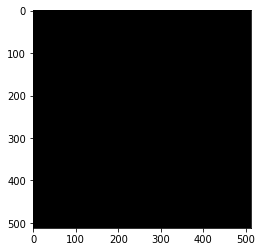

NameError: name 'res' is not defined

In [8]:
# lena - fint better image
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import os
filename = 'lena512_gray.bmp'
print('Download Lena at :', 'https://users-cs.au.dk/jallan/ml/data/{0}'.format(filename))
if not os.path.exists(filename):
    print('Download Lena:', 'https://users-cs.au.dk/jallan/ml/data/{0}'.format(filename))
    os.system('wget https://users-cs.au.dk/jallan/ml/data/{0}'.format(filename))
    
img = Image.open('lena512_gray.bmp')
lena = np.array(img)
print('image shape', lena.shape)

plt.imshow(lena, cmap='gray')
plt.show()

def conv2d(img, w):
    ### YOUR CODE HERE
    #img_dim = np.array(img.shape)
    #w_dim = np.array(w.shape)
    #target_dim = img_dim + w_dim -1
    #fft_res = np.fft.fft2(img,target_dim)
    #target = np.fft.ifft2(fft_res).real
    
    print("T", img[0:3,0:3])
    d = w.shape[0]
    target = np.ones(img.shape)
    for i in range(img.shape[0]-d):
        for j in range(img.shape[0]-d):
            test = img[i::i+d,j::j+d]
            print(test)
            # target[i,j] = test @ w
    ############# code from board: #################
    
    
    
    ### END CODE
    return target

def max_pool2d(img, kernel_size=2):
    ### YOUR CODE HERE
    (r,c) = img.shape
    nr = r// kernel_size
    nc = c // kernel_size
    res = np.zeros((nr,nc))
    for i in range(nr):
        for j in range(nc):
            ci = i *
    ### END CODE
    return res


w = np.array([-1,-1,-1,
            -1,8,-1,
            -1,-1,-1]).reshape(3,3)

conv_img = conv2d(lena,w)
plt.imshow(conv_img, cmap='gray')
plt.show()
poll_img = max_pool2d(conv_img)
plt.imshow(poll_img, cmap='gray')
plt.show()


image shape torch.Size([1, 1, 512, 512])
torch.Size([1, 1, 256, 256])


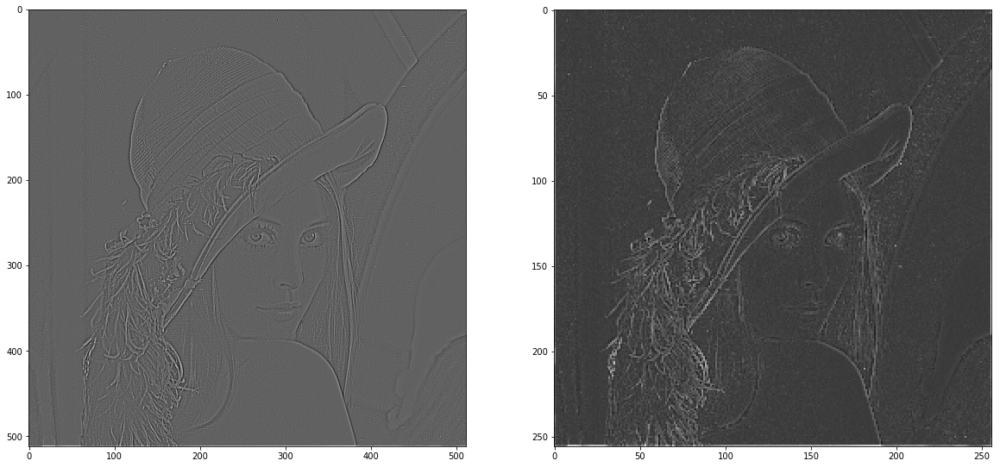

In [2]:
rimport torch
import torch.nn as nn
import torch.nn.functional as F
torch_lena = torch.from_numpy(lena).view(1, 1, lena.shape[0], lena.shape[1]).double()
print('image shape', torch_lena.shape)
tv = torch.tensor([[-1., -1., -1.], [-1., 8, -1.], [-1., -1., -1.]])
tv = tv.view(1, 1, 3, 3).double()
convoluted_lena = F.conv2d(torch_lena, tv, torch.tensor([0.], dtype=torch.double), 1, 1, 1, 1)
pooled_lena = F.max_pool2d(convoluted_lena, kernel_size=(2, 2))
print(pooled_lena.shape)
fig, axes = plt.subplots(1, 2, figsize=(20, 16))
axes[0].imshow(convoluted_lena.numpy().squeeze(), cmap='gray')
axes[1].imshow(pooled_lena.numpy().squeeze(), cmap='gray')
plt.show()

# Ex 4: How Many Parameters Does the VGG net use
The VGG net is a well known neural net architecture for image recognition. 

**How many parameters does it use? Write down a formula and compute the number!**

It has the following architecture [https://pytorch.org/docs/0.4.0/_modules/torchvision/models/vgg.html]

It takes as input an image of size 224 x 224 x 3.

First it computes 64, 3 x 3 convolutions i.e. makes 64 layers. Then it makes 64, 3 x 3 convolutionas on the output of the previous convolution i.e. it makes 64 new layers. This is followd by  a $2 \times 2$ max pooling operation.

The patter continues as described below: A number is the number of new convolutions made on previous input and 'M' means max pooling.

64, 64, 'M', 128, 128, 'M', 256, 256, 256, 256, 'M', 512, 512, 512, 512, 'M', 512, 512, 512, 512, 'M'

All convolutions are 3x3 using padding of 1 of zeros around the input so the convolution output size had height and width the same as the input.
All poolings are $2 \times 2$ non-overlapping (stride=2)

After the fully convolutional layers it used standard fully connected layers as
- 512 * 7 * 7, 4096 (why 512 * 7 * 7?)
- 4096, 4096),
- 4096, num_classes=1000
        


In [ ]:
%matplotlib inline




## Ex 5: The Auto Encoder - Neural Nets for Unsupervised Learning (data compression)
In this exercise we will see if can in fact compress the digits of dimension 784 x 784 to something much smaller using neural nets using what is known as an autoencoder.

An autoencoder is simply a neural net that learns to map the input to it self, the trick is that the data has to go through the hidden layers and if the hidden layers have smaller dimension or is otherwise constrained then the net must compress the data efficiently to achieve this task.

You must imlement a one hidden layer auto encoder with input dim 784, hidden size h, and output dim 784. In the hidden layer you can use relu activation (or others if you want).
This means there are two weight matrices $W_1$ of shape $784 \times h$ and $W_2$ of shape $h \times 784$ and corresponding bias variables.

For a given input point $x$ of dimension $1 \times 784$ the loss is 

$$
\sum_{i=1}^{d=784} (\textrm{nn}(x)[i] - x[i])^2
$$

Write a neural net in pytorch either using the nn package or just standard pytorch that minimize this cost.

We think of $\textrm{enc}(x) = \textrm{relu}(xW_1 + b_1)$ as the encoding algorithm and $\textrm{dec}(a) = a W_2 + b_2$ as the decoding algorithm

After implementing this we visualize the results as follows:
- Try $h=64$ and see how well the compression works by visualizing the output on several input digits (using imshow and reshape). (you can try other h as well)
- For the same values of $h$ try and visualize the weight matrix $W1$, each column has dimension as $x$ which is 784 so we can visualize it as an image (remember to normalize to norm 1 first).

See the **autoenc.py** file for starter code.

## Ex 6: Standard Deep Learning with Pytorch for digits
We have seen all the tools needed to do deep learning now. So lets try out the neural net package for pytorch.
See https://pytorch.org/tutorials/beginner/blitz/cifar10_tutorial.html#sphx-glr-beginner-blitz-cifar10-tutorial-py
for how to use the neural package to write a simple convolutional net and apply to image recognition.

Using this as inspiration write a convolutional net for the digits considered by SVM last time (and in the hand in).

See if you can beat the SVM score from last week (we got around 97 percent accuracy for svm with Gaussian Kernel).

It may not be easy since there are many more buttons to turn on the neural net and so little time to turn them!
But it is very much possible to beat the SVM given enough time to play with the net. 

See **conv_digits.py** for starter code


## Ex 7: Linear Models for Image Recognition
Implement Softmjax Regression in pytorch and see how well you can do in the cifar data set. You need to reshape data to vectors of size 3 x 32 x 32 instead of 3, 32, 32 tensors to use in Logistic Regression (the view command may help you). 
- Do you think the linear model stands a chance. Why, why not
- How high accuracy can you get.


The easiest way is to adapt  https://pytorch.org/tutorials/beginner/blitz/cifar10_tutorial.html#sphx-glr-beginner-blitz-cifar10-tutorial-py to  softmax regression.



## Ex 8: Convolutional Nets Image Recognition
Use convolutional neural nets for cifar and complete beat the linear model. Start from the tutorial or your Ex 6 implementation.

You are welcome to try a standard feed forward first for comparison.


Above 80 percent is achieveable using the tools you have seen but it may require a larger/deeper net and many epochs which take time!!! 